# Simulated Annealing with $k$-Means Clustering for TSP
Krehbiel, Updated May 2024

## Section 1: Setup
Load libraries and data.

In [123]:
import numpy as np
from numba import jit
import matplotlib.pyplot as plt
import math
import time

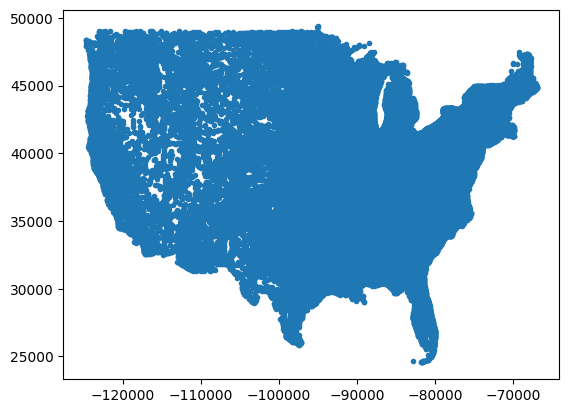

In [124]:
with open("cities.csv") as datafile:
    data = np.loadtxt(datafile, delimiter=" ")[:,1:] # chop off city indices

N = len(data) # number of cities in datafile

# prepare 2D array so (CITIES[i,0],CITIES[i,1]) gives (x,y) coordinates for city i
CITIES = np.zeros((N,2))
CITIES[:,0] = -data[:,1]
CITIES[:,1] = data[:,0]
    
plt.plot(CITIES[:,0],CITIES[:,1],'.');

## Section 2: Utility functions
Functions shared across multiple phases of the solution, e.g., for calculating the distance between cities, tour length, producing a list of cities sorted by tour, swapping, getting random pairs, etc.

In [125]:
# distance between city_i and city_j
def dist(city_i,city_j):
    return math.sqrt((city_i[0]-city_j[0])**2 + (city_i[1]-city_j[1])**2)

# assuming tour is a permutation of the integers {0,...,N-1}, calculate associated tour length
def tour_length(cities,tour):
    n = len(cities)
    length = 0
    for i in range(1,n): # add dist(i-1,i)
        length += dist(cities[tour[i-1],:],cities[tour[i],:])
    return length + dist(cities[tour[0],:],cities[tour[n-1],:])

# return cities sorted by the indices specified in tour, e.g., (c0,c1,c2,c3),(0,2,1,3) --> (c0,c2,c1,c3)
def sorted_by_tour(cities,tour):
    n = len(cities)
    city_tour = np.zeros((n,2))
    for i in range(n):
        city_tour[i,:] = cities[tour[i],:]
    return city_tour

# swaps two values in arr, based on the indices specified by pair
def swap(arr,pair):
    o_i = arr[pair[0]]
    arr[pair[0]]=arr[pair[1]]
    arr[pair[1]]=o_i

# returns a uniformly random pair of distinct indices 1,...,n-1
def random_pair(n):
    i = j = np.random.randint(1,n)
    while i==j:
        j = np.random.randint(1,n)
    return i,j

# checks that no single swap improves the given tour
def is_local_opt(cities,tour):
    curr = tour_length(cities,tour)
    for i in range(1,len(cities)):
        for j in range(1,i):
            p=(i,j)
            swap(tour,p)
            if tour_length(cities,tour)<curr:
                return False
            swap(tour,p)
    return True

## Section 3: Clustering
Code for k-means clustering to pre-partition the 115k cities into 300 groups.

In [126]:
# pick k distinct random cities and return their locations
def initial_means(cities,k):
    indices = np.array(range(k))
    for i in range(k):
        j = np.random.randint(len(cities)) # random city
        while sum(np.where(j==indices,indices,0))>0: # keep sampling if not distinct
            j = np.random.randint(len(cities))        
        indices[i]=j
    return cities[indices,:]

# update the k centroids based on assignments
def update_centroids(cities,means,assignment):
    for m in range(len(means)):
        n_m = sum(np.where(assignment==m,1,0)) # number of cities in cluster m
        if n_m>0: # keep the mean of any empty cluster where it is
            x_sum = sum(np.where(assignment==m,cities[:,0],0))
            y_sum = sum(np.where(assignment==m,cities[:,1],0))
            means[m] = np.array([x_sum,y_sum])/n_m
    return means

# greedily move every city to its closest mean and report if any moves occurred
def update_assignments(cities,means,assignment):
    changed = False
    for i in range(len(cities)):
        if i%10000==0: print(i/1000,"k") #for preliminary experiments/debugging
        min_dist = dist(cities[i],means[assignment[i]])
        for m in range(k):
            dist_to_m = dist(cities[i],means[m])
            if dist_to_m < min_dist:
                assignment[i] = m
                min_dist = dist_to_m
                changed = True
    return changed
        
# calculate variance for each cluster and aggregate, weighted by cluster size
def assignment_loss(means,assignment,cities):
    k = len(means)
    loss = 0
    for i in range(k):
        mean = means[i]
        count = 0
        var = 0
        for j in range(len(assignment)):
            if assignment[j]==i:
                count += 1
                var += dist(cities[j],mean)**2
        loss += count*var
    return loss # quality of cluster

# means are the k centroids, assignments are n indices 0..k-1; run for up to max_its>0 iterations
def k_means(cities,k,max_its):
    n = len(cities)
    assignment = np.array([0 for i in range(n)]) # everyone is group 0 initially
    means = initial_means(cities,k) # k initial centroids
    it=1
    # adjust membership until there is no improving adjustment
    while update_assignments(cities,means,assignment):
        means = update_centroids(cities,means,assignment)
        print("loss",assignment_loss(means,assignment,cities))
        it+=1
        if it>max_its: break
    return means,assignment



### Clustering experiments
Assess how loss decreases after a few rounds.

clustering:
0.0 k
10.0 k
20.0 k
30.0 k
40.0 k
50.0 k
60.0 k
70.0 k
80.0 k
90.0 k
100.0 k
110.0 k
loss 41644018537159.695
0.0 k
10.0 k
20.0 k
30.0 k
40.0 k
50.0 k
60.0 k
70.0 k
80.0 k
90.0 k
100.0 k
110.0 k
loss 27878476492865.082
0.0 k
10.0 k
20.0 k
30.0 k
40.0 k
50.0 k
60.0 k
70.0 k
80.0 k
90.0 k
100.0 k
110.0 k
loss 23726144368576.438
23726144368576.438


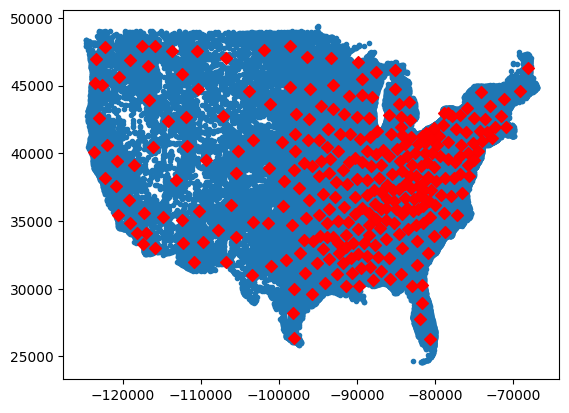

In [127]:
k=300
cities = CITIES[:N,:]
   
print("clustering:")
np.random.seed() # if you want the random seed to be the same each time, add a parameter like 1
means,assignment = k_means(cities,k,3) # run with loss print statement uncommented to track progress
print(assignment_loss(means,assignment,cities))
plt.scatter(cities[:,0],cities[:,1],marker='.')
plt.scatter(means[:,0],means[:,1],c='r',marker='D');


### Code to save a clustering assignment to a file

In [128]:
with open('clusters.txt', 'a') as fp:
    for i in range(len(CITIES)):
        fp.write(str(assignment[i]))
        fp.write(',')

### Extract a TSP problem from a first region and plot default vs random tour

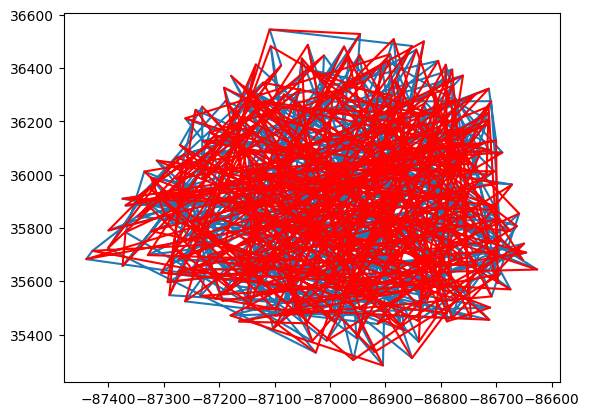

In [382]:
# region 0
r_i = 0
n_r_i = sum(np.where(assignment==r_i,1,0)) # number of cities in region i
region = np.zeros((n_r_i,2))
j = 0 # within-region city number
for i in range(len(CITIES)):
    if assignment[i]==r_i:
        region[j]=CITIES[i]
        j += 1

plt.plot(region[:,0],region[:,1]);
tour = np.array(range(n_r_i))
np.random.shuffle(tour) # random permutation of the city indices within region i
sbt = sorted_by_tour(region,tour)
plt.plot(sbt[:,0],sbt[:,1],'r');

## Section 4: Simulated annealing

In [133]:
# energy1=length of curr, energy2=length of new
def p_accept(curr_len,neighbor_len,temp):
    if neighbor_len<curr_len: return 1 # automatically accept better neighbor
    return math.exp(-(neighbor_len-curr_len)/temp) # accept w.p. decreasing with inferiority of neighbor

# sets a temperature based on the time left [0,1)
def temperature(time_left,scale):
    return time_left*scale+.0000001 

# calculates the sample SD of 100 random tours vs their 1-swap neighbors
def get_ssd(cities):
    n = len(cities)
    perm = np.array(range(n))
    var = 0
    for i in range(100):
        np.random.shuffle(perm[1:n])
        len_orig = tour_length(cities,perm)
        swap(perm,random_pair(n))
        var += (tour_length(cities,perm)-len_orig)**2
    return math.sqrt(var/100)

# run simulated annealing for k_max steps; n_swaps is a now-defuct param that used to control neighborhoods
def anneal(cities,k_max,n_swaps,vals):
    s = get_ssd(cities)
    n = len(cities)
    tour = np.array(range(n))
    np.random.shuffle(tour[1:n])
    for k in range(k_max):
        temp = temperature(1-(k+1)/k_max,s)
        len_curr = tour_length(cities,tour)
        
        # perform and assess a single swap
        p = random_pair(n)
        swap(tour,p)
        len_new = tour_length(cities,tour)
        if np.random.uniform()>=p_accept(len_curr,len_new,temp): #swap back if p_accept is low
            swap(tour,p)

        # record current tour_length
        vals[k] = tour_length(cities,tour)
    return tour




### Experiment with SA parameters
Print/plot outputs for a single region, changing # iterations and # swaps per iteration time-permitting. At $k_{\max}=15000$ with original single-swap neighbors, experiment takes a couple minutes and plot suggests we are not close to the best tour for the single region but significantly better than a random tour.

64683.90149990762
False
16.154545068740845 seconds


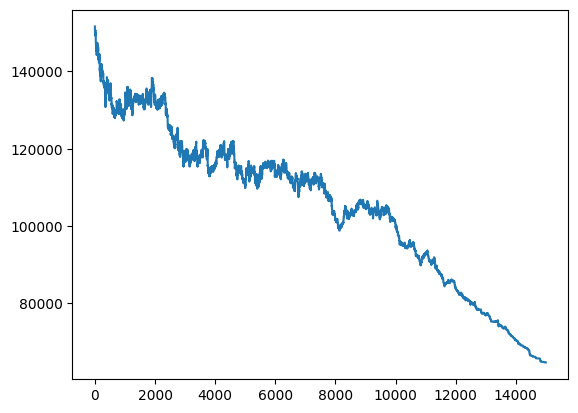

In [134]:
start = time.time()

cities = region # run simulated annealing on a single region (a few hundred cities vs >100k)
k_max = 15000
np.random.seed()
vals = np.zeros(k_max)
sa_tour = anneal(cities,k_max,1,vals) # run simulated annealing for k_max iterations and return tour found
plt.plot(np.array(range(k_max)),vals); # plot how tour length changes across iterations
print(tour_length(cities,sa_tour)) # length of last tour
print(is_local_opt(cities,sa_tour)) # whether last tour is a local optimum

print(time.time()-start,"seconds") # experiment runtime



## Section 4: Simulated annealing

64341.05885445676


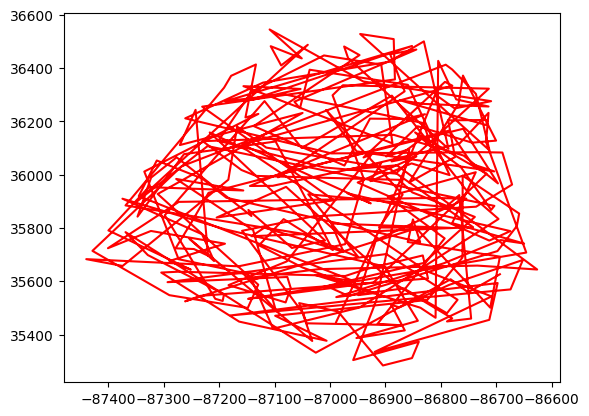

In [135]:
print(tour_length(cities,sa_tour))
sbt = sorted_by_tour(region,sa_tour)
plt.plot(sbt[:,0],sbt[:,1],'r'); # plot the found tour

141314.4640431058


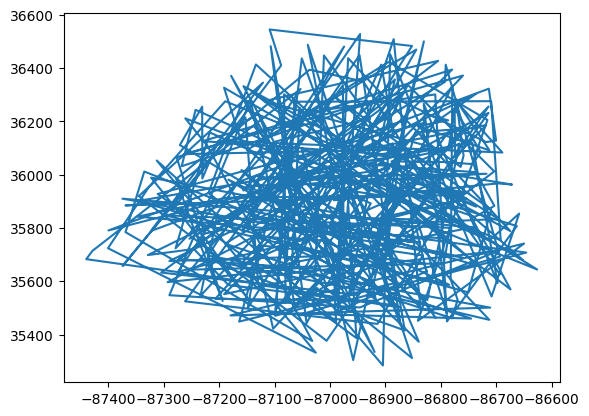

In [136]:
print(tour_length(cities,range(len(cities))))
plt.plot(cities[:,0],cities[:,1]); # plot a random tour for comparison

## Genetic Algorithm

In [437]:
import sys
#Genetic Algorithm

#Generates a random population of size N of tours with size t
def generate_random_population(N, t):
    population = np.empty([N, t], dtype=int)
    tour = np.array(range(t))
    for i in range(0, N): 
        np.random.shuffle(tour)
        population[i] = tour
    return population

#Generates a cloned population of size N given a tour and a mutate chance, where each clone in N clones has a mutate_chance to mutate
def generate_clone_population(N, tour, mutate_chance):
    population = np.empty([N, len(tour)], dtype=int)
    for i in range(0, N):
        clone = tour.copy()
        if np.random.uniform() <= mutate_chance:
            mutate(clone)
        population[i] = clone
    return population

#Crossover breed two tours and return the resulting tour
def crossover_breed (t1, t2):
    t3 = np.zeros((len(t1)), dtype=int)
    for i in range(0, int(len(t1)/2)):
        t3[i] = t1[i]
    j = int(len(t2)/2)
    for i in range(0, len(t2)):
        if t2[i] not in t3:
            t3[j] = t2[i]
            j+=1
    return t3

#Performs a random swap mutate
def mutate (t1):
    swap_pair = random_pair(len(t1)) #determines swap uniformly across cities
    swap(t1, swap_pair)

#Given the cities, a population of tours, and a percent cutoff, determines the top performing tours
def truncate_select (cities, pop, percent): #truncate select best performing tours based on distance of tour
    fitness = []
    for i in range(len(pop)):
        fitness.append(tour_length(cities, pop[i]))
    eval = sorted(fitness)
    N = int(percent * len(pop))
    parents = []
    for i in range(0, N):
        parents.append(pop[fitness.index(eval[i])])
    return parents

In [438]:
def genetic_algorithm(region, prevpop, gens, darwin, mutate_chance_child, mutate_chance_elite, population_size, elite_clone_percent, messiah_margin, messiah_num, print_stats):
    start = time.time()
    #Metric keeping
    avg_fits = []
    best_fits = []
    worst_fits = []
    messiah_lines = []
    super_duper_best_tour = prevpop[0]
    super_duper_best_tour_generation = 0
    super_duper_best_tour_fitness = tour_length(region, super_duper_best_tour)
    
    for i in range(0, gens):
        #per generation metrics
        avg = 0
        best = sys.maxsize
        worst = 0
        #creating parent set
        all_parents = truncate_select(region, prevpop, darwin) #retrieves the set of tours to use as set of parents using truncate selection
        elites = all_parents[0:int(elite_clone_percent*len(all_parents))]
        newpop = np.empty([len(prevpop), len(prevpop[0])], dtype=int)
        #creating breeded portion of new population
        for j in range(0, len(prevpop)-int(elite_clone_percent*len(all_parents))): #leaves space for cloning parents
            parents = random_pair(len(all_parents))#selects random pair of parents from set of parents defined earlier
            child = crossover_breed(prevpop[parents[0]], prevpop[parents[1]]) #creates a child to be added to the new population using crossover breeding (ew, incest!)
            if np.random.uniform() <= mutate_chance_child: #only mutates mutate_chance percent of the children added
                mutate(child) #mutates using random swap
            newpop[j] = child
            
            #updates per generation metrics if needed
            child_fitness = tour_length(region, child)
            avg += child_fitness
            if child_fitness < best:
                best = child_fitness
            if child_fitness > worst:
                worst = child_fitness
            if child_fitness < super_duper_best_tour_fitness:
                super_duper_best_tour = child
                super_duper_best_tour_generation = i
                super_duper_best_tour_fitness = child_fitness
        #creating cloned portion of new population
        for j in range(len(prevpop)-int(elite_clone_percent*len(all_parents)), len(prevpop)): #clone parents into the new population
            clone = elites[j-len(prevpop)+int(elite_clone_percent*len(all_parents))]
            if np.random.uniform() <= mutate_chance_elite: #clone has a mutate_chance chance to mutate
                mutate(clone)
            newpop[j] = clone
            #updates per generation metrics if needed
            clone_fitness = tour_length(region, clone)
            avg += clone_fitness
            if clone_fitness < best:
                best = clone_fitness
            if clone_fitness > worst:
                worst = clone_fitness
            if clone_fitness < super_duper_best_tour_fitness:
                super_duper_best_tour = clone
                super_duper_best_tour_generation = i
                super_duper_best_tour_fitness = clone_fitness
        #add generation's metrics to plot data
        avg_fits.append(avg/len(prevpop))
        best_fits.append(best)
        worst_fits.append(worst)
        #if conditions for a messiah have been met, reintroduce the messiah into the population
        if best-super_duper_best_tour_fitness >= messiah_margin:
            for k in range(0, messiah_num):
                newpop[k] = super_duper_best_tour #messiah is the best tour the algorithm has encountered so far
            print("Reintroduced " + str(messiah_num) + " messiah(s) in generation " + str(i+1))
            messiah_lines.append(i+1)
        # if i!=0 and abs(best_fits[i] - best_fits[i-1]) < .005: #some stopping condition other than generation
        #     break
        prevpop = newpop

    if(print_stats):
        print(time.time()-start,"seconds")
        for k in range(0, len(messiah_lines)):
            plt.axvline(x=messiah_lines[k], color='purple', linewidth=0.5)
        plt.plot(np.array(range(len(avg_fits))),avg_fits, label="Average per Gen")
        plt.plot(np.array(range(len(best_fits))),best_fits, c='g', label="Best per Gen")
        plt.plot(np.array(range(len(worst_fits))),worst_fits, c='r', label="Worst per Gen")
        plt.scatter(super_duper_best_tour_generation, super_duper_best_tour_fitness, c='y', s=12, marker='o', label="Best Tour")
        plt.xlabel("Generations")
        plt.ylabel("Tour Length")
        plt.legend()
        plt.show()
        
        print("Best Tour Found in generation " + str(super_duper_best_tour_generation) + " with length of " + str(super_duper_best_tour_fitness))

    return super_duper_best_tour

Using a random initial population:
Reintroduced 50 messiah(s) in generation 473
39.99326419830322 seconds


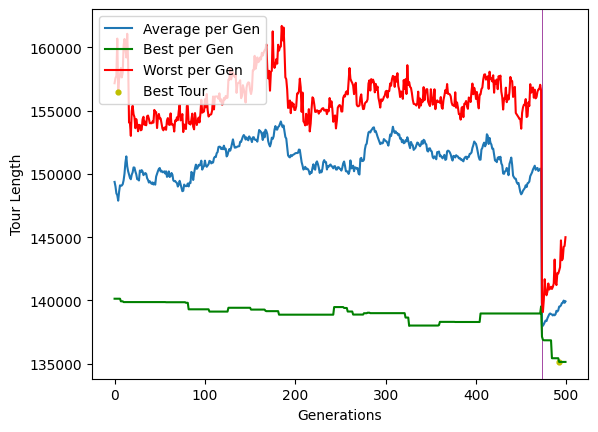

Best Tour Found in generation 492 with length of 135141.34059507205
[222  29 216 245 125 167 232 138 186 154 285 302 253 209 267 283  58 305
 265 203 273 103  42 173 184   9 136 247  92 261 217 277 149 304 130  10
 315 156 252 323   3  77 168 319  40  54 225 212 254  82  91  12  53 109
  20  14 248  88 291 114   7 310 271 194   4  62 218 215 197  90 204 192
  49 131 127 311 224 272   8  93 161 162 320 318 176 148 133 258 200 134
 177  80 270 275 279 183  56 299 260 100 257 151 244 157 213  22  41  25
 210  27  87 262  76 104  39  75 317  59 145  50 121 300 128  65 246  18
 140 324 153 129 155 321 292 298 135 158  69 220 160 237 141 316 249 243
 303 294  89 201  74  30  52  67 188  48 105 118  43 144 132  61  84 205
  23 286  44  72  78 227  85 208 240   2 293 230  17 255 301 172 170 263
 226 206  45 116 106 241 313 290 231 276  13 120 122 123 175 297 174 112
  11 195 214 196  51 219 268 187  57  97 281 159 150  24 146 308  34 111
  35 223 182 211 169 142 314 113 295  32  70  71  46 124

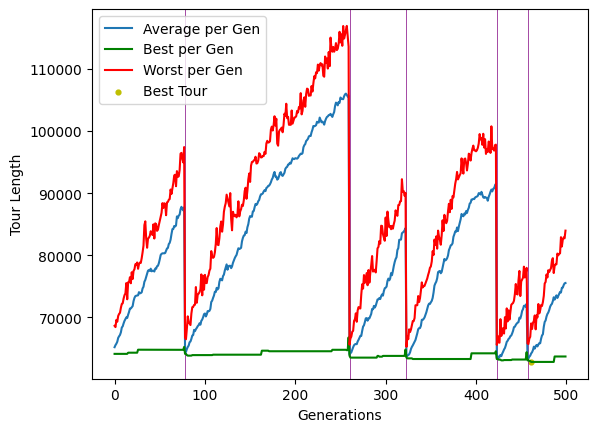

Best Tour Found in generation 461 with length of 62842.777637320534
[  0  24  14 144 129  45 117 114 158 291  71 108 318 199 296 306 201 304
  74   7 265 178 184 189  61 193 197 232 111 246 135  49 312 157 185  41
 322 191 218  46   2 103 172 195 198 182 163 235  62 305  86 314 196 258
  82 243  95 245 156 251 260 234 287 279 299 100 280  21  77 272 264   6
 269 208 145  94  12 118   4  90  72 137  96  20  65 227  52 214 226 222
 200 211 219  67  22 213 230 139 159 107 104  10 311 161  97 130  80 303
 283 257 284 205  53  37 254  42 241 290  27 267  55 309  56 301 262 313
 162  50 123 203 319 259 277 115 281 270 138 121 147 242 164 152 302 155
 105 252 194 169 143  92  17  83 294  69 142 173 112 297  40 255  73 128
  29 308  89 236 239   8 261  28 170 127 204  84  98 268  75  87  16 244
 273 298 192 207  60   5 285 212 229 116  78 317 249 307 165 240  38 206
 316  57  44 122 113   9 324 223 233 228 295  63 323 292 271 102  32 202
 256 188  85 237 289 238 248  64 286 183  26 101  68 176

In [439]:
r_i = 0
n_r_i = sum(np.where(assignment==r_i,1,0)) # number of cities in region i
region = np.zeros((n_r_i,2), dtype=int)
j = 0 # within-region city number
for i in range(len(CITIES)):
    if assignment[i]==r_i:
        region[j]=CITIES[i]
        j += 1


gens = 500 #number of generations
darwin = .30 #top percentage of population used as parents for breeding
mutate_chance_child = .20 #chance for a mutation to occur in each child
mutate_chance_elite = .05 #chance for a mutation to occur in each cloned elite
population_size = 100 #size of each generation
elite_clone_percent = .10/darwin #top percent of parents used for breeding that are also used for cloning (multiplied by darwin percent)
messiah_margin = 1000 #distance margin between best tour found and best tour in current generation (if met, messiah is reintroduced to population)
messiah_percent = .50 #when reintroducing a messiah, the percent of the population that should be reintroduced as clones of that messiah
messiah_num = int(messiah_percent * population_size)

#each tour has the same number of cities as n_r_i, the number of cities in region i, in this case region 0
prevpop1 = generate_random_population(population_size, n_r_i) #generates a random population
mutate_chance_clone = .80 #mutate chance in the clones for an initial cloned population
prevpop2 = generate_clone_population(population_size, sa_tour, mutate_chance_clone) #generates a cloned population using the simulated annealing tour from before

print("Using a random initial population:")
t1 = genetic_algorithm(region, prevpop1, gens, darwin, mutate_chance_child, mutate_chance_elite, population_size, elite_clone_percent, messiah_margin, messiah_num, True)
print(t1)
if len(t1) != len(set(t1)):
    print("Duplicates existed in tour. Not valid")
    for i in range(len(t1)):
        for j in range(len(t1)):
            if i != j and t1[i] == t1[j]:
                print("Duplicates exist and indices " + str(i) + " and " + str(j))
print("Using a cloned population of the simulated annealing solution:")
t2 = genetic_algorithm(region, prevpop2, gens, darwin, mutate_chance_child, mutate_chance_elite, population_size, elite_clone_percent, messiah_margin, messiah_num, True)
print(t2)

In [440]:
#building regions
start = time.time()
regions = []
for r_i in range(0, k): #k is the number of clusters(regions) from k-means
    n_r_i = sum(np.where(assignment==r_i,1,0)) #number of cities in region r_i
    region_i = np.zeros((n_r_i, 2))
    j = 0
    for i in range(len(CITIES)):
        if assignment[i]==r_i:
            region_i[j] = CITIES[i]
            j += 1
    regions.append(region_i)
    print("Region " + str(r_i) + " completed")
print("Completed region building")
print(time.time()-start, "seconds")


Region 0 completed
Region 1 completed
Region 2 completed
Region 3 completed
Region 4 completed
Region 5 completed
Region 6 completed
Region 7 completed
Region 8 completed
Region 9 completed
Region 10 completed
Region 11 completed
Region 12 completed
Region 13 completed
Region 14 completed
Region 15 completed
Region 16 completed
Region 17 completed
Region 18 completed
Region 19 completed
Region 20 completed
Region 21 completed
Region 22 completed
Region 23 completed
Region 24 completed
Region 25 completed
Region 26 completed
Region 27 completed
Region 28 completed
Region 29 completed
Region 30 completed
Region 31 completed
Region 32 completed
Region 33 completed
Region 34 completed
Region 35 completed
Region 36 completed
Region 37 completed
Region 38 completed
Region 39 completed
Region 40 completed
Region 41 completed
Region 42 completed
Region 43 completed
Region 44 completed
Region 45 completed
Region 46 completed
Region 47 completed
Region 48 completed
Region 49 completed
Region 50 

Running genetic algorithm on cluster 0 with 325 cities
Reintroduced 75 messiah(s) in generation 101
20.82996416091919 seconds


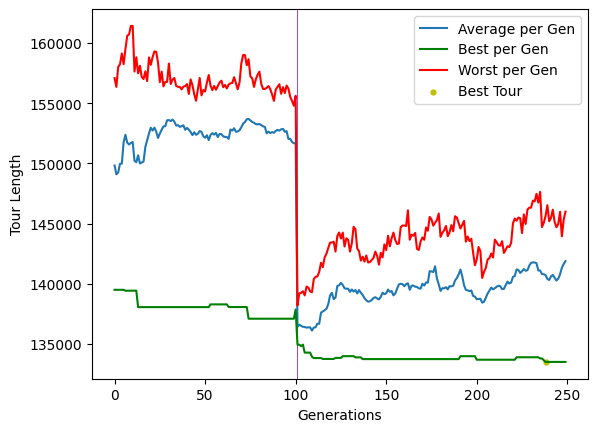

Best Tour Found in generation 238 with length of 133499.52554794177
Completed sub-tour for cluster number 0 --------------------------------------------
Running genetic algorithm on cluster 1 with 702 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 110
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 198
47.37829923629761 seconds


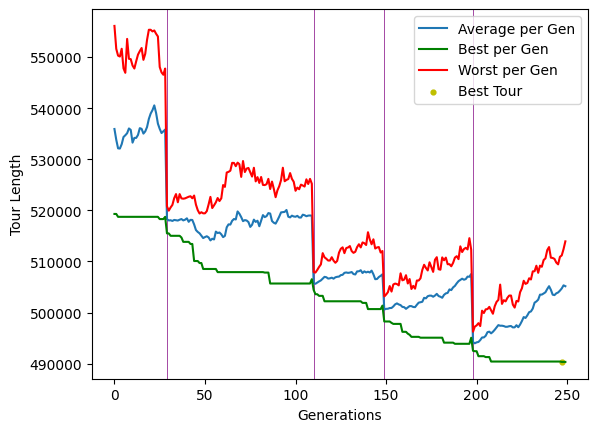

Best Tour Found in generation 247 with length of 490335.6519636453
Completed sub-tour for cluster number 1 --------------------------------------------
Running genetic algorithm on cluster 2 with 257 cities
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 104
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 223
Reintroduced 75 messiah(s) in generation 246
16.3611581325531 seconds


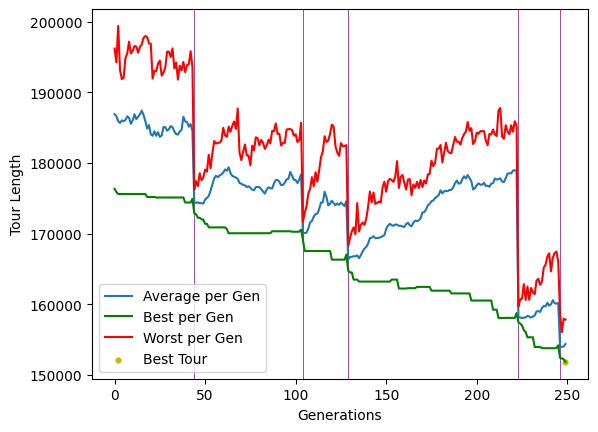

Best Tour Found in generation 249 with length of 151856.93410325816
Completed sub-tour for cluster number 2 --------------------------------------------
Running genetic algorithm on cluster 3 with 196 cities
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 141
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 238
12.595944166183472 seconds


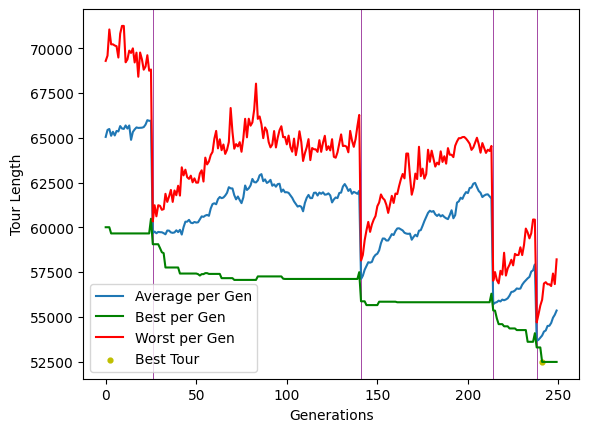

Best Tour Found in generation 241 with length of 52482.20018526521
Completed sub-tour for cluster number 3 --------------------------------------------
Running genetic algorithm on cluster 4 with 378 cities
Reintroduced 75 messiah(s) in generation 86
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 201
24.507829904556274 seconds


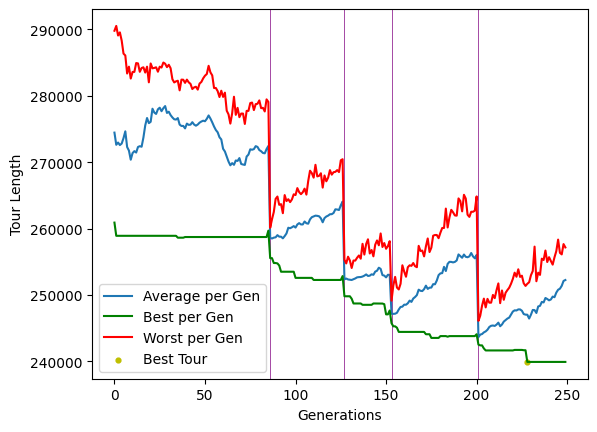

Best Tour Found in generation 228 with length of 239929.6636658171
Completed sub-tour for cluster number 4 --------------------------------------------
Running genetic algorithm on cluster 5 with 375 cities
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 123
Reintroduced 75 messiah(s) in generation 161
24.322919130325317 seconds


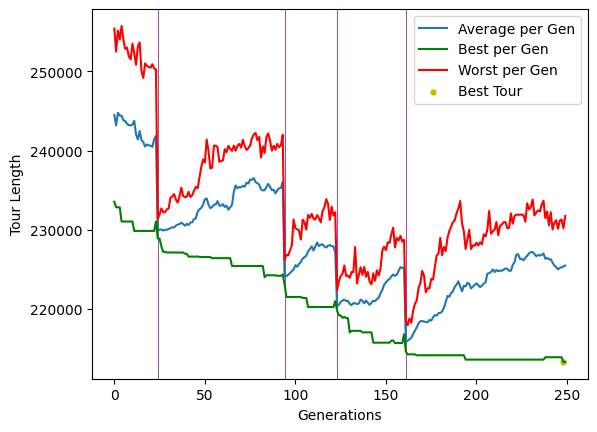

Best Tour Found in generation 248 with length of 213315.4611226348
Completed sub-tour for cluster number 5 --------------------------------------------
Running genetic algorithm on cluster 6 with 468 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 206
30.507611751556396 seconds


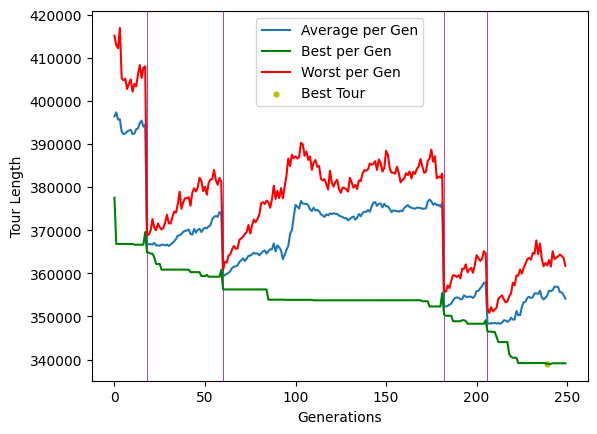

Best Tour Found in generation 239 with length of 338984.5284313307
Completed sub-tour for cluster number 6 --------------------------------------------
Running genetic algorithm on cluster 7 with 203 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 43
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 173
Reintroduced 75 messiah(s) in generation 206
12.943583011627197 seconds


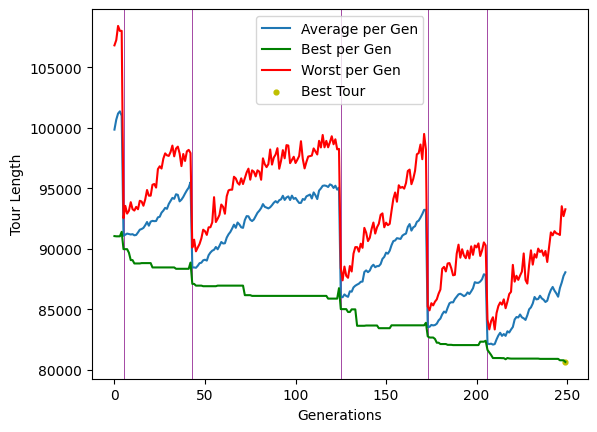

Best Tour Found in generation 249 with length of 80655.87107985966
Completed sub-tour for cluster number 7 --------------------------------------------
Running genetic algorithm on cluster 8 with 218 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 70
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 244
Reintroduced 75 messiah(s) in generation 248
13.958104133605957 seconds


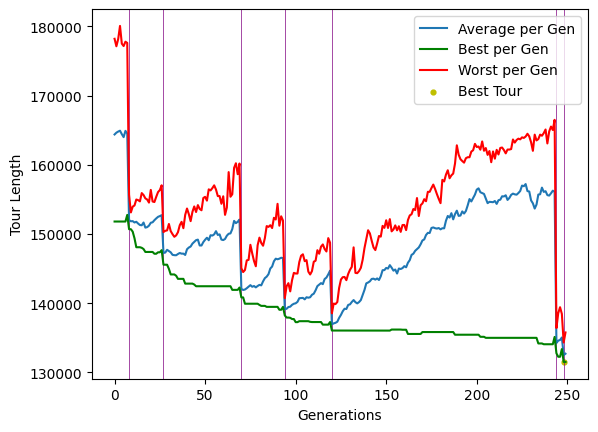

Best Tour Found in generation 248 with length of 131500.84437529725
Completed sub-tour for cluster number 8 --------------------------------------------
Running genetic algorithm on cluster 9 with 292 cities
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 153
18.850671768188477 seconds


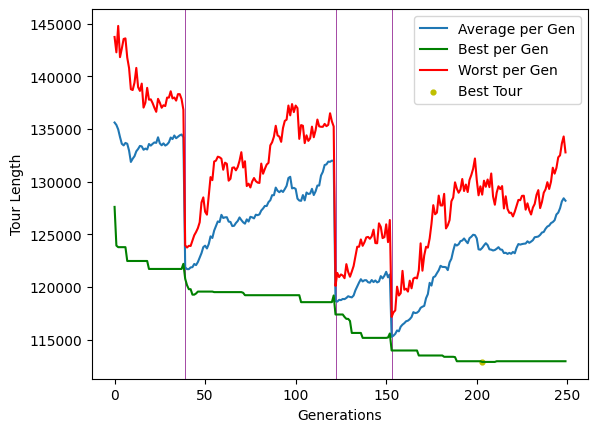

Best Tour Found in generation 203 with length of 112876.48798667983
Completed sub-tour for cluster number 9 --------------------------------------------
Running genetic algorithm on cluster 10 with 559 cities
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 119
Reintroduced 75 messiah(s) in generation 172
Reintroduced 75 messiah(s) in generation 191
37.38682222366333 seconds


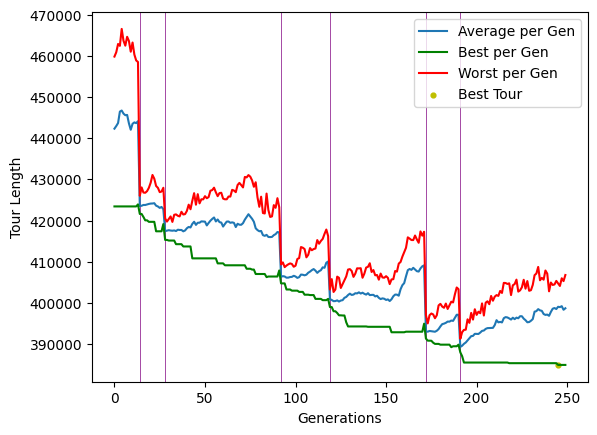

Best Tour Found in generation 245 with length of 384866.02160231053
Completed sub-tour for cluster number 10 --------------------------------------------
Running genetic algorithm on cluster 11 with 475 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 116
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 209
31.05084228515625 seconds


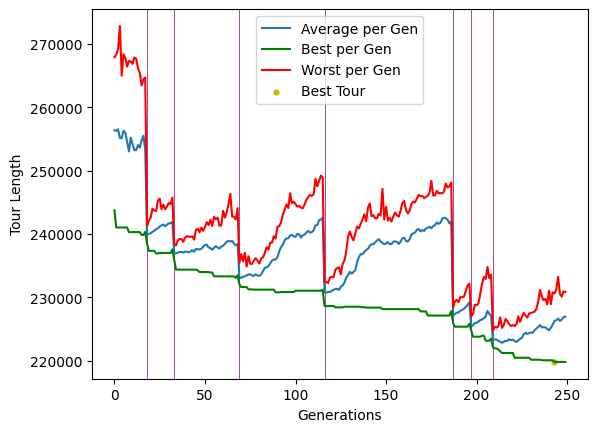

Best Tour Found in generation 243 with length of 219795.5151464878
Completed sub-tour for cluster number 11 --------------------------------------------
Running genetic algorithm on cluster 12 with 355 cities
Reintroduced 75 messiah(s) in generation 13
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 220
Reintroduced 75 messiah(s) in generation 243
22.94757103919983 seconds


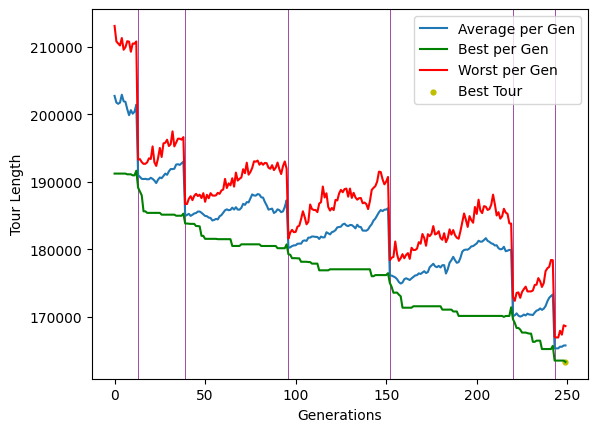

Best Tour Found in generation 249 with length of 163323.19363999733
Completed sub-tour for cluster number 12 --------------------------------------------
Running genetic algorithm on cluster 13 with 194 cities
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 196
12.367820024490356 seconds


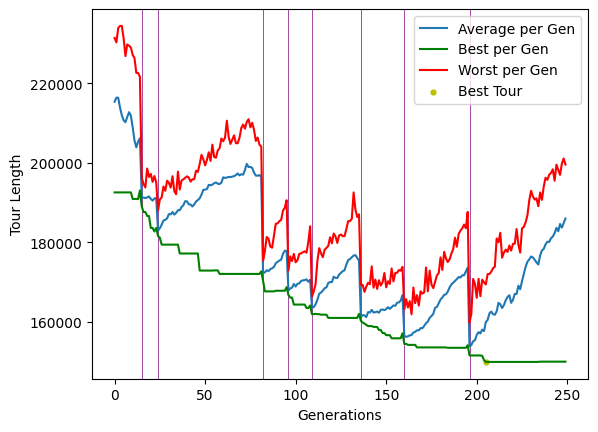

Best Tour Found in generation 205 with length of 149937.18540491996
Completed sub-tour for cluster number 13 --------------------------------------------
Running genetic algorithm on cluster 14 with 341 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 223
22.031955242156982 seconds


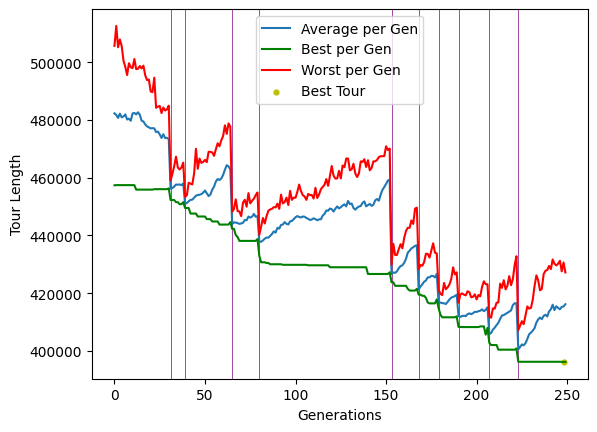

Best Tour Found in generation 248 with length of 396173.0842746568
Completed sub-tour for cluster number 14 --------------------------------------------
Running genetic algorithm on cluster 15 with 380 cities
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 75
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 223
Reintroduced 75 messiah(s) in generation 233
24.603061199188232 seconds


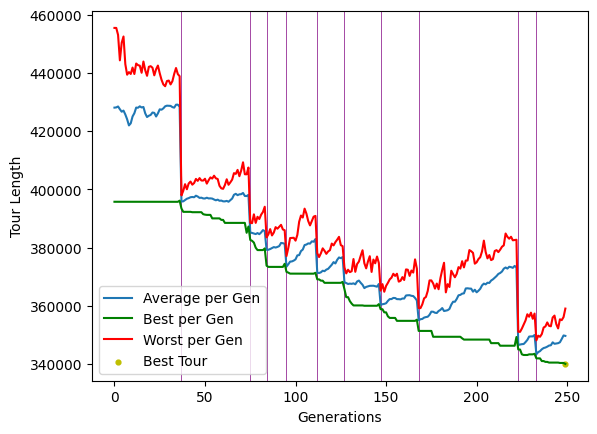

Best Tour Found in generation 249 with length of 339989.26984960516
Completed sub-tour for cluster number 15 --------------------------------------------
Running genetic algorithm on cluster 16 with 363 cities
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 222
23.368412256240845 seconds


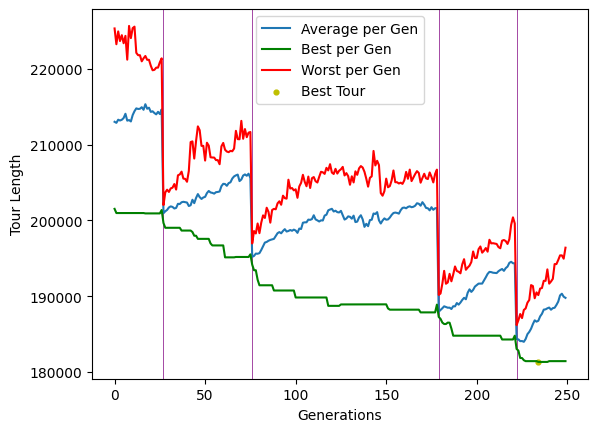

Best Tour Found in generation 234 with length of 181333.07140435776
Completed sub-tour for cluster number 16 --------------------------------------------
Running genetic algorithm on cluster 17 with 446 cities
Reintroduced 75 messiah(s) in generation 57
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 204
29.064044952392578 seconds


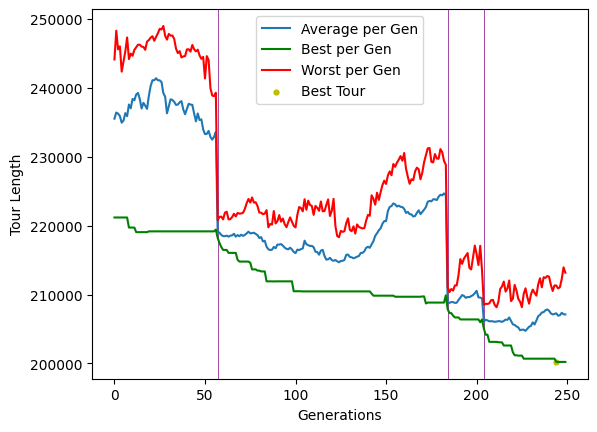

Best Tour Found in generation 244 with length of 200226.82766004658
Completed sub-tour for cluster number 17 --------------------------------------------
Running genetic algorithm on cluster 18 with 327 cities
Reintroduced 75 messiah(s) in generation 32
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 78
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 116
Reintroduced 75 messiah(s) in generation 190
21.098912954330444 seconds


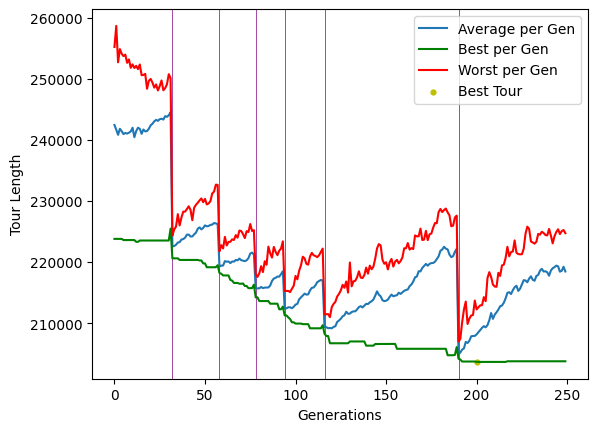

Best Tour Found in generation 200 with length of 203644.17948148385
Completed sub-tour for cluster number 18 --------------------------------------------
Running genetic algorithm on cluster 19 with 398 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 73
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 144
Reintroduced 75 messiah(s) in generation 177
25.872509002685547 seconds


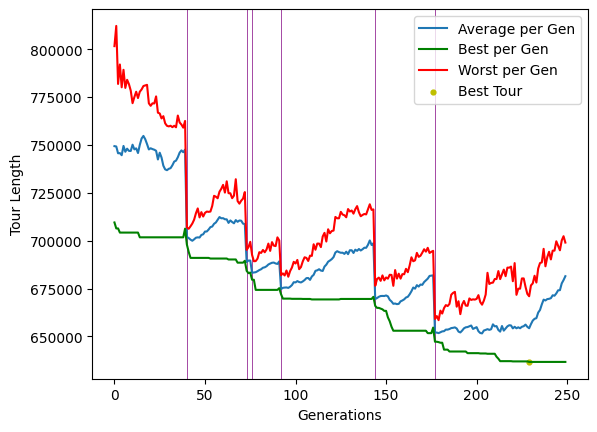

Best Tour Found in generation 229 with length of 636722.244417476
Completed sub-tour for cluster number 19 --------------------------------------------
Running genetic algorithm on cluster 20 with 241 cities
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 209
Reintroduced 75 messiah(s) in generation 216
15.311110734939575 seconds


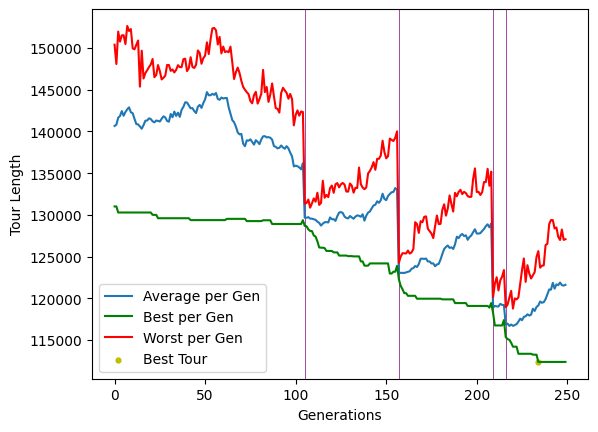

Best Tour Found in generation 234 with length of 112374.91380201395
Completed sub-tour for cluster number 20 --------------------------------------------
Running genetic algorithm on cluster 21 with 269 cities
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 227
17.238335132598877 seconds


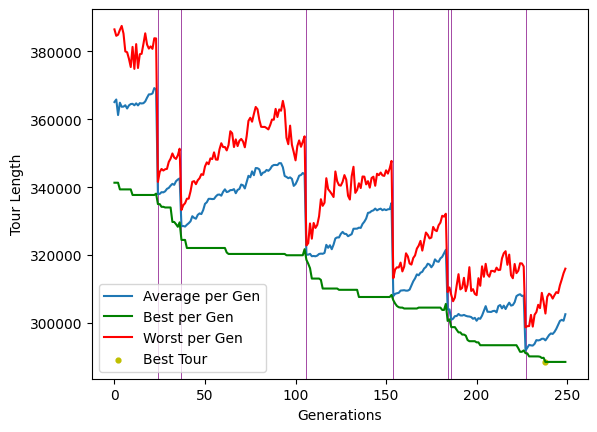

Best Tour Found in generation 238 with length of 288529.7371676633
Completed sub-tour for cluster number 21 --------------------------------------------
Running genetic algorithm on cluster 22 with 312 cities
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 101
19.984990119934082 seconds


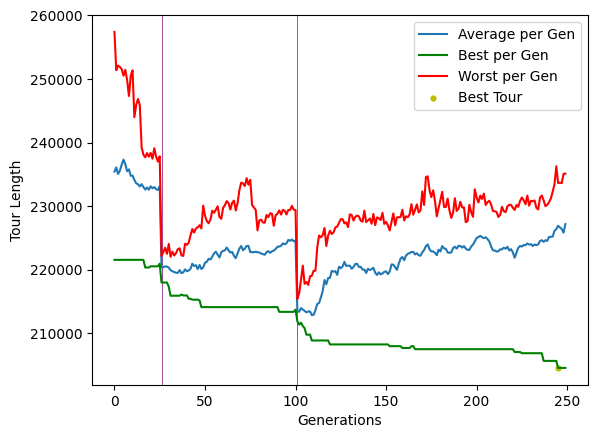

Best Tour Found in generation 245 with length of 204533.90574312437
Completed sub-tour for cluster number 22 --------------------------------------------
Running genetic algorithm on cluster 23 with 466 cities
Reintroduced 75 messiah(s) in generation 13
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 86
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 236
30.316017150878906 seconds


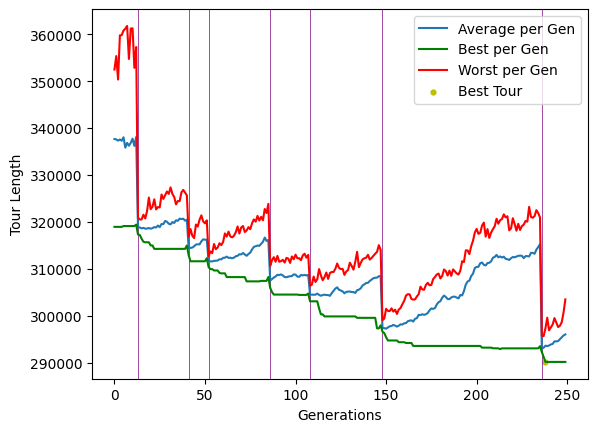

Best Tour Found in generation 238 with length of 290141.9667735097
Completed sub-tour for cluster number 23 --------------------------------------------
Running genetic algorithm on cluster 24 with 373 cities
Reintroduced 75 messiah(s) in generation 88
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 222
Reintroduced 75 messiah(s) in generation 244
24.17871379852295 seconds


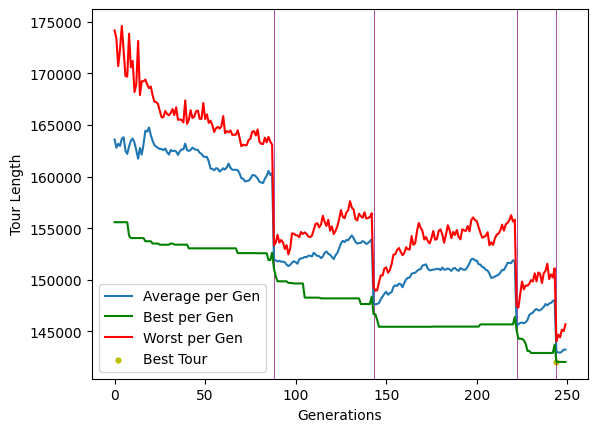

Best Tour Found in generation 244 with length of 142037.78818779957
Completed sub-tour for cluster number 24 --------------------------------------------
Running genetic algorithm on cluster 25 with 361 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 209
Reintroduced 75 messiah(s) in generation 247
23.319905996322632 seconds


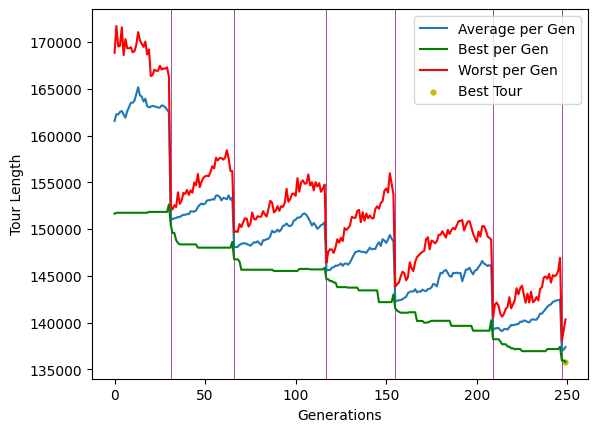

Best Tour Found in generation 249 with length of 135795.4903525992
Completed sub-tour for cluster number 25 --------------------------------------------
Running genetic algorithm on cluster 26 with 290 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 225
18.535396099090576 seconds


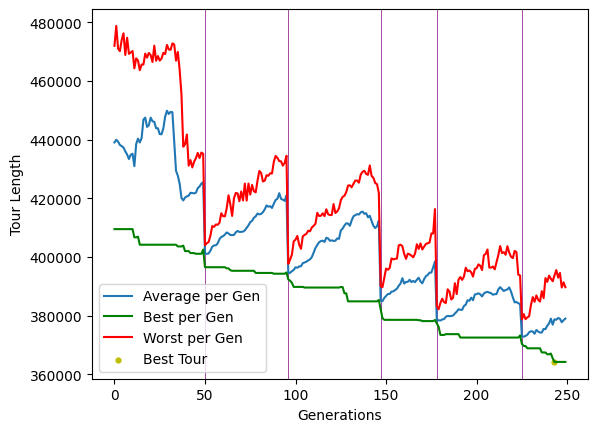

Best Tour Found in generation 243 with length of 364221.42931590794
Completed sub-tour for cluster number 26 --------------------------------------------
Running genetic algorithm on cluster 27 with 375 cities
Reintroduced 75 messiah(s) in generation 9
Reintroduced 75 messiah(s) in generation 34
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 248
24.281104803085327 seconds


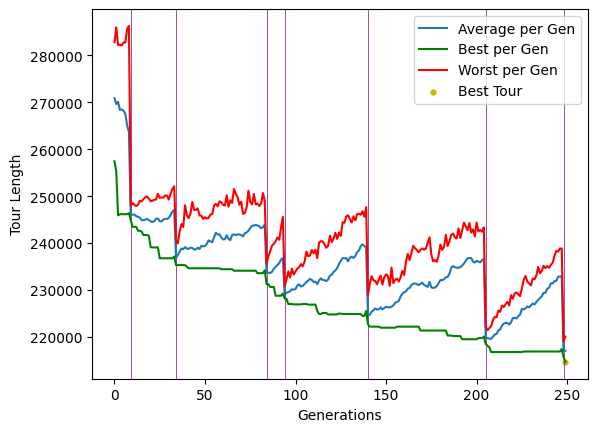

Best Tour Found in generation 249 with length of 214697.55760546436
Completed sub-tour for cluster number 27 --------------------------------------------
Running genetic algorithm on cluster 28 with 380 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 249
24.64339828491211 seconds


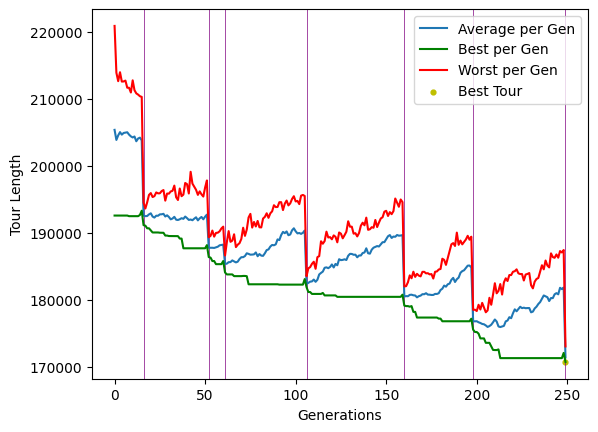

Best Tour Found in generation 249 with length of 170757.75379394207
Completed sub-tour for cluster number 28 --------------------------------------------
Running genetic algorithm on cluster 29 with 538 cities
Reintroduced 75 messiah(s) in generation 35
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 59
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 132
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 223
35.84967517852783 seconds


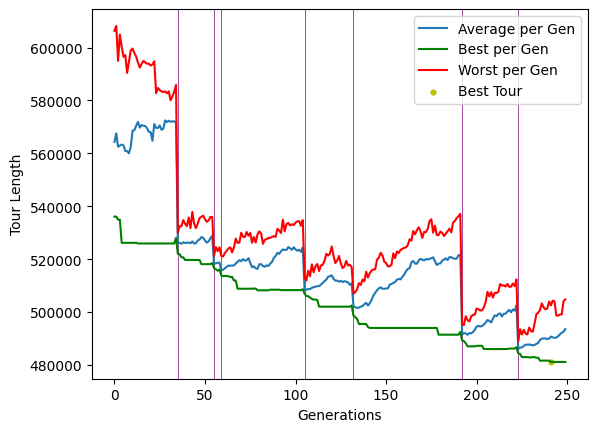

Best Tour Found in generation 241 with length of 481146.70482561074
Completed sub-tour for cluster number 29 --------------------------------------------
Running genetic algorithm on cluster 30 with 242 cities
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 227
15.38721489906311 seconds


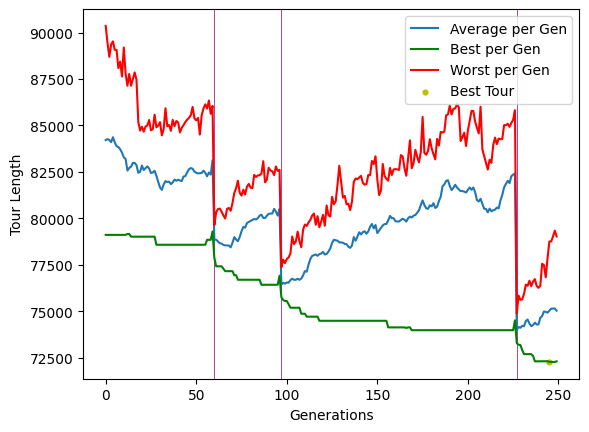

Best Tour Found in generation 245 with length of 72277.88472171396
Completed sub-tour for cluster number 30 --------------------------------------------
Running genetic algorithm on cluster 31 with 536 cities
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 235
35.84610199928284 seconds


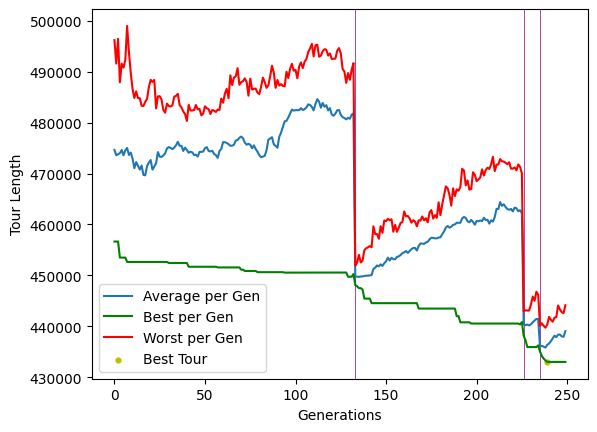

Best Tour Found in generation 239 with length of 432995.2166514013
Completed sub-tour for cluster number 31 --------------------------------------------
Running genetic algorithm on cluster 32 with 945 cities
Reintroduced 75 messiah(s) in generation 11
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 177
63.57329988479614 seconds


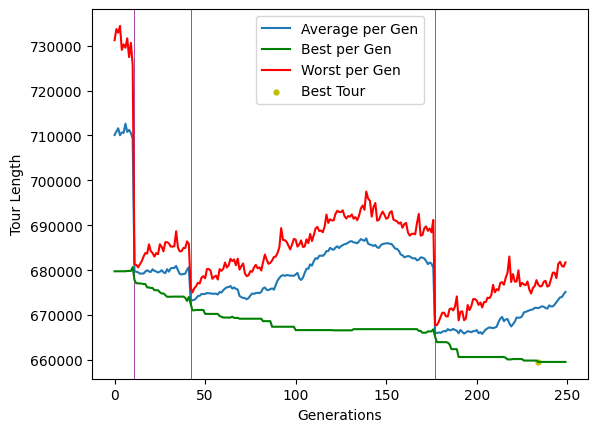

Best Tour Found in generation 234 with length of 659573.8669086882
Completed sub-tour for cluster number 32 --------------------------------------------
Running genetic algorithm on cluster 33 with 180 cities
Reintroduced 75 messiah(s) in generation 64
Reintroduced 75 messiah(s) in generation 237
11.507206201553345 seconds


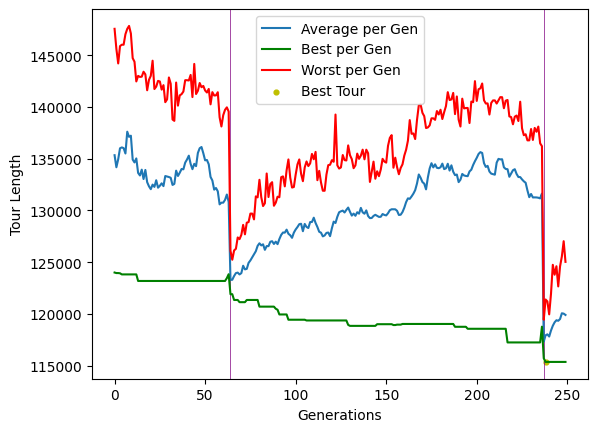

Best Tour Found in generation 238 with length of 115367.86960419253
Completed sub-tour for cluster number 33 --------------------------------------------
Running genetic algorithm on cluster 34 with 215 cities
Reintroduced 75 messiah(s) in generation 2
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 250
13.774899005889893 seconds


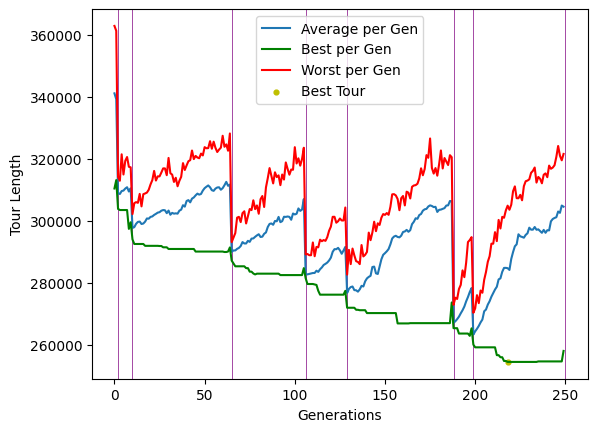

Best Tour Found in generation 218 with length of 254513.81430569864
Completed sub-tour for cluster number 34 --------------------------------------------
Running genetic algorithm on cluster 35 with 421 cities
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 161
Reintroduced 75 messiah(s) in generation 237
27.56580090522766 seconds


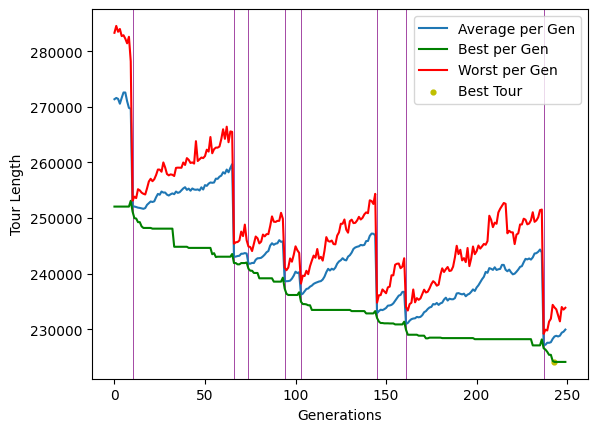

Best Tour Found in generation 243 with length of 224133.44786885346
Completed sub-tour for cluster number 35 --------------------------------------------
Running genetic algorithm on cluster 36 with 280 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 174
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 235
18.214028120040894 seconds


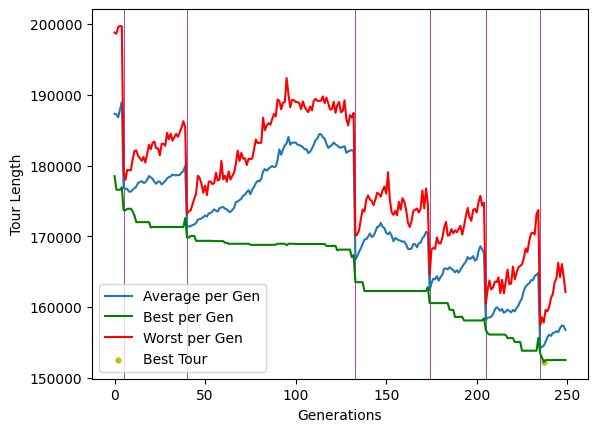

Best Tour Found in generation 237 with length of 152250.43189119376
Completed sub-tour for cluster number 36 --------------------------------------------
Running genetic algorithm on cluster 37 with 147 cities
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 191
9.469266176223755 seconds


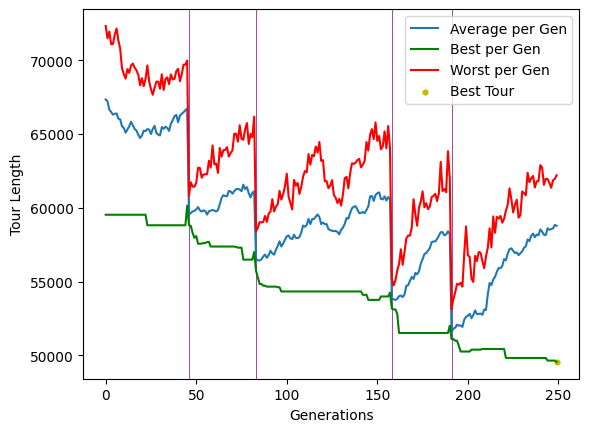

Best Tour Found in generation 249 with length of 49564.905620797035
Completed sub-tour for cluster number 37 --------------------------------------------
Running genetic algorithm on cluster 38 with 410 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 48
Reintroduced 75 messiah(s) in generation 93
Reintroduced 75 messiah(s) in generation 134
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 193
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 230
26.77914786338806 seconds


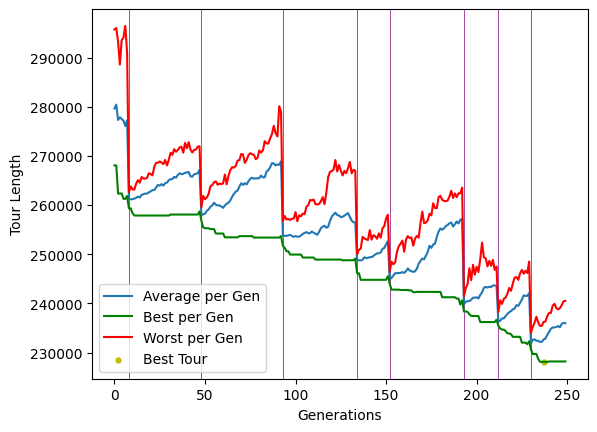

Best Tour Found in generation 237 with length of 228083.26804314545
Completed sub-tour for cluster number 38 --------------------------------------------
Running genetic algorithm on cluster 39 with 247 cities
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 213
15.736572980880737 seconds


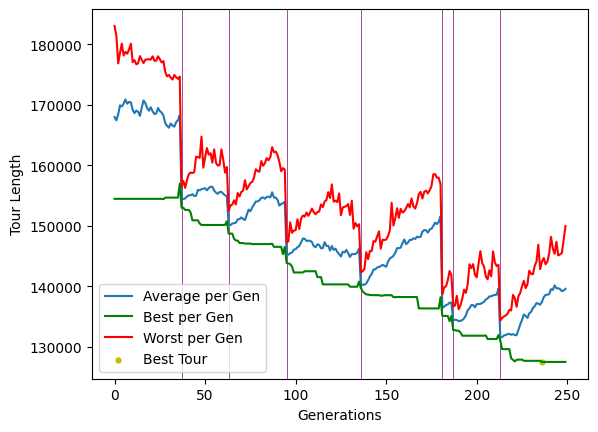

Best Tour Found in generation 236 with length of 127472.60877422488
Completed sub-tour for cluster number 39 --------------------------------------------
Running genetic algorithm on cluster 40 with 364 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 81
Reintroduced 75 messiah(s) in generation 144
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 196
23.591253995895386 seconds


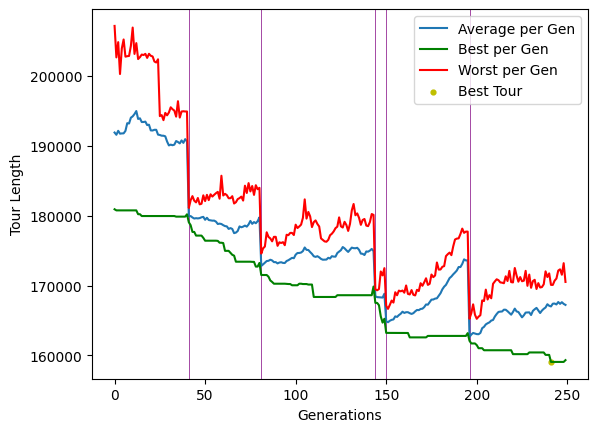

Best Tour Found in generation 241 with length of 159059.37697378462
Completed sub-tour for cluster number 40 --------------------------------------------
Running genetic algorithm on cluster 41 with 381 cities
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 142
Reintroduced 75 messiah(s) in generation 220
Reintroduced 75 messiah(s) in generation 236
24.86612606048584 seconds


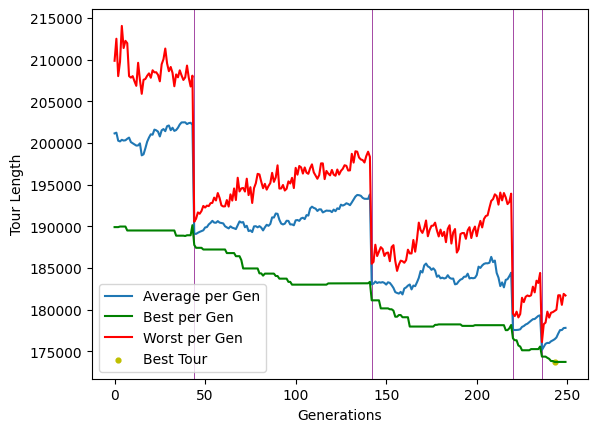

Best Tour Found in generation 243 with length of 173745.5528643782
Completed sub-tour for cluster number 41 --------------------------------------------
Running genetic algorithm on cluster 42 with 632 cities
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 230
42.35021686553955 seconds


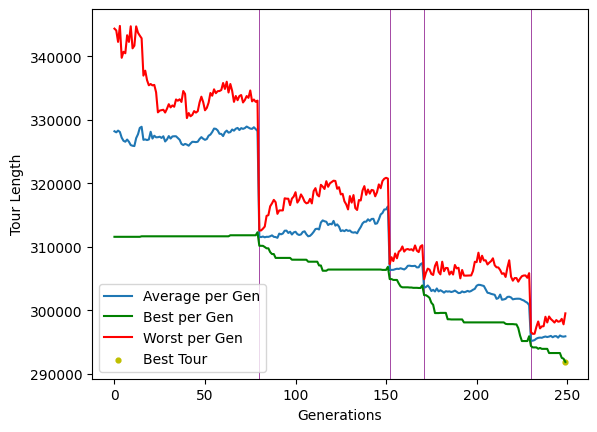

Best Tour Found in generation 249 with length of 291892.6265591084
Completed sub-tour for cluster number 42 --------------------------------------------
Running genetic algorithm on cluster 43 with 408 cities
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 85
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 236
Reintroduced 75 messiah(s) in generation 247
26.422014951705933 seconds


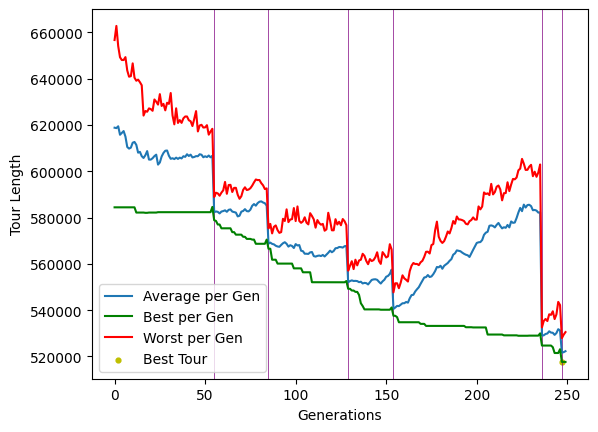

Best Tour Found in generation 247 with length of 517654.5951055859
Completed sub-tour for cluster number 43 --------------------------------------------
Running genetic algorithm on cluster 44 with 206 cities
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 48
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 174
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 227
Reintroduced 75 messiah(s) in generation 243
13.251795053482056 seconds


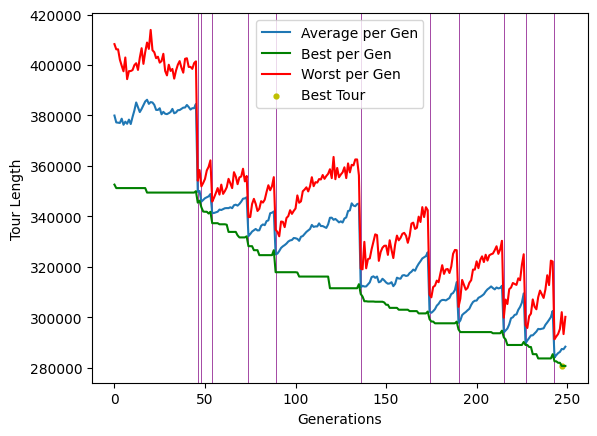

Best Tour Found in generation 247 with length of 280762.7333203984
Completed sub-tour for cluster number 44 --------------------------------------------
Running genetic algorithm on cluster 45 with 220 cities
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 225
14.121942043304443 seconds


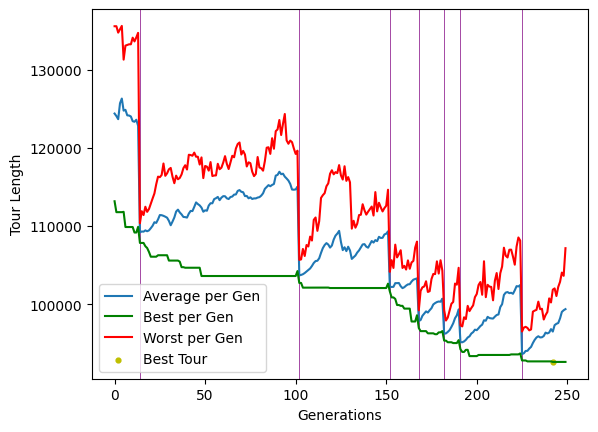

Best Tour Found in generation 242 with length of 92616.902966568
Completed sub-tour for cluster number 45 --------------------------------------------
Running genetic algorithm on cluster 46 with 569 cities
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 181
38.11981391906738 seconds


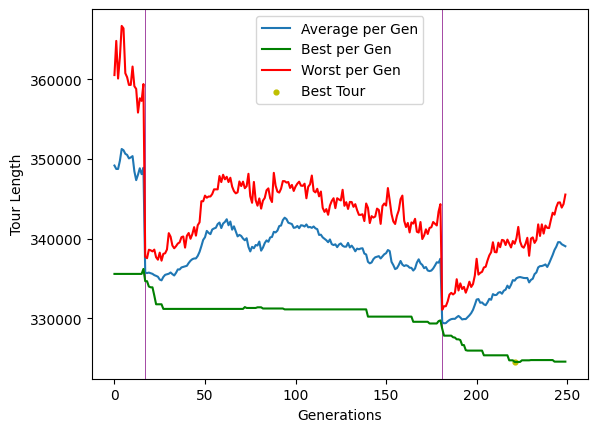

Best Tour Found in generation 221 with length of 324526.4484019314
Completed sub-tour for cluster number 46 --------------------------------------------
Running genetic algorithm on cluster 47 with 588 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 137
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 217
Reintroduced 75 messiah(s) in generation 238
Reintroduced 75 messiah(s) in generation 242
39.480854988098145 seconds


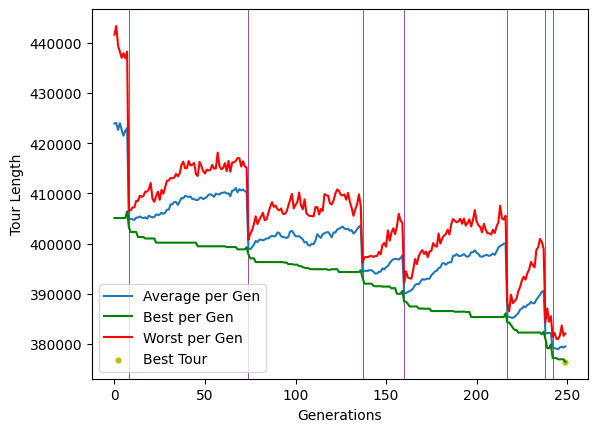

Best Tour Found in generation 249 with length of 376426.2407599127
Completed sub-tour for cluster number 47 --------------------------------------------
Running genetic algorithm on cluster 48 with 285 cities
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 101
Reintroduced 75 messiah(s) in generation 189
Reintroduced 75 messiah(s) in generation 246
18.319731950759888 seconds


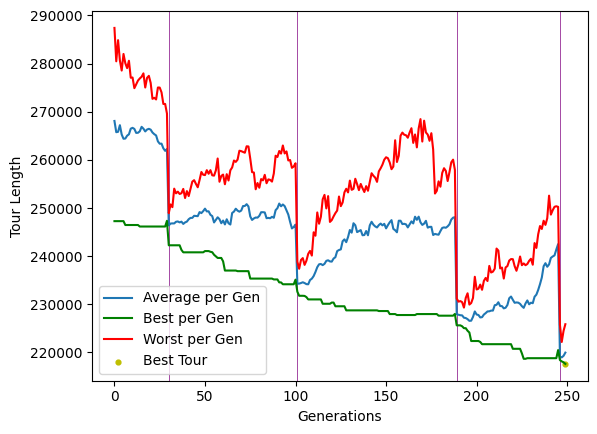

Best Tour Found in generation 249 with length of 217615.67585822503
Completed sub-tour for cluster number 48 --------------------------------------------
Running genetic algorithm on cluster 49 with 372 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 121
Reintroduced 75 messiah(s) in generation 123
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 221
Reintroduced 75 messiah(s) in generation 244
24.1635479927063 seconds


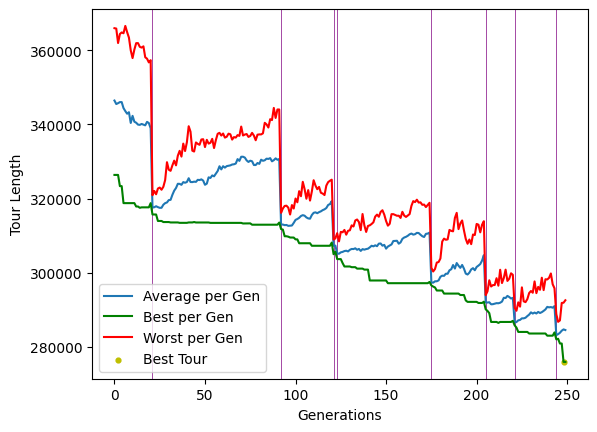

Best Tour Found in generation 248 with length of 275957.7495393996
Completed sub-tour for cluster number 49 --------------------------------------------
Running genetic algorithm on cluster 50 with 441 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 47
Reintroduced 75 messiah(s) in generation 107
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 166
28.7223379611969 seconds


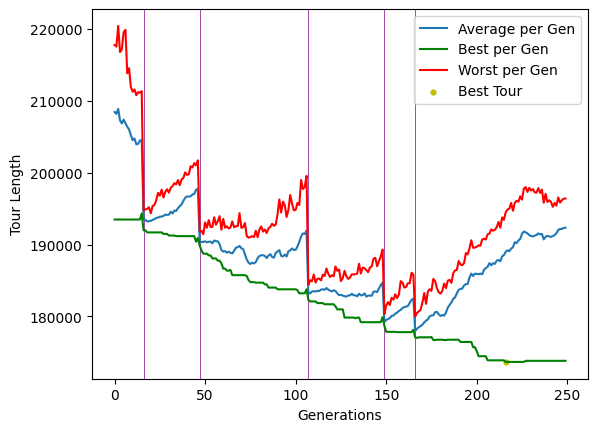

Best Tour Found in generation 216 with length of 173670.64201240573
Completed sub-tour for cluster number 50 --------------------------------------------
Running genetic algorithm on cluster 51 with 229 cities
Reintroduced 75 messiah(s) in generation 158
15.110201835632324 seconds


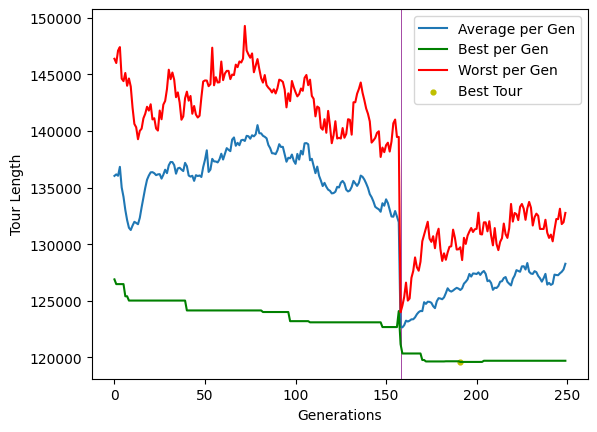

Best Tour Found in generation 191 with length of 119598.07379104361
Completed sub-tour for cluster number 51 --------------------------------------------
Running genetic algorithm on cluster 52 with 418 cities
Reintroduced 75 messiah(s) in generation 38
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 221
27.195820093154907 seconds


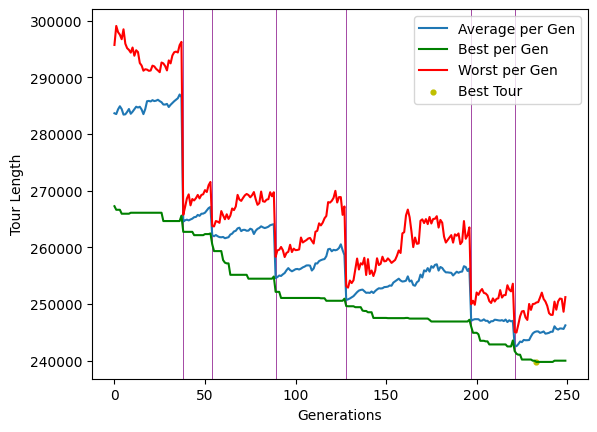

Best Tour Found in generation 233 with length of 239770.49718450065
Completed sub-tour for cluster number 52 --------------------------------------------
Running genetic algorithm on cluster 53 with 325 cities
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 220
21.060349941253662 seconds


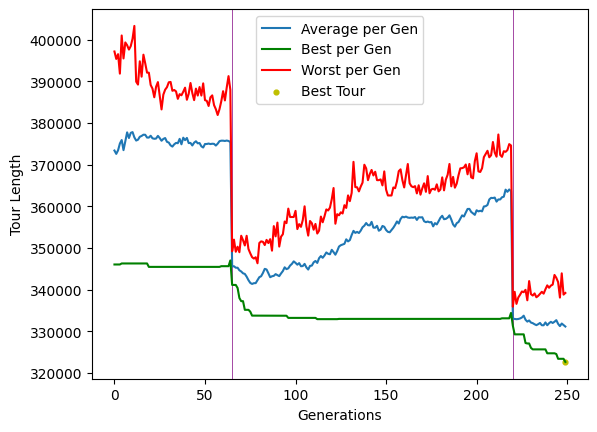

Best Tour Found in generation 249 with length of 322676.8809933781
Completed sub-tour for cluster number 53 --------------------------------------------
Running genetic algorithm on cluster 54 with 302 cities
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 241
19.46266007423401 seconds


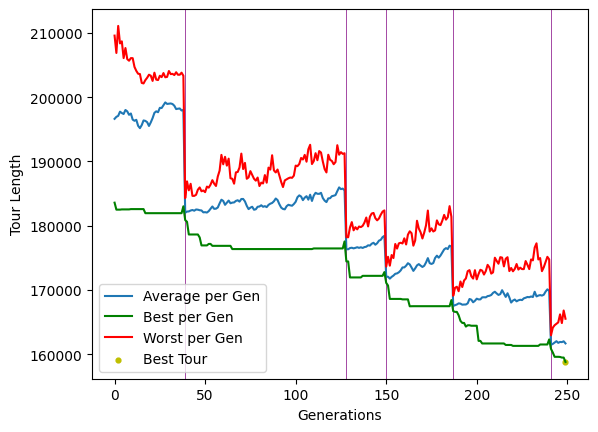

Best Tour Found in generation 249 with length of 158821.98433813642
Completed sub-tour for cluster number 54 --------------------------------------------
Running genetic algorithm on cluster 55 with 218 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 151
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 200
Reintroduced 75 messiah(s) in generation 208
14.089630365371704 seconds


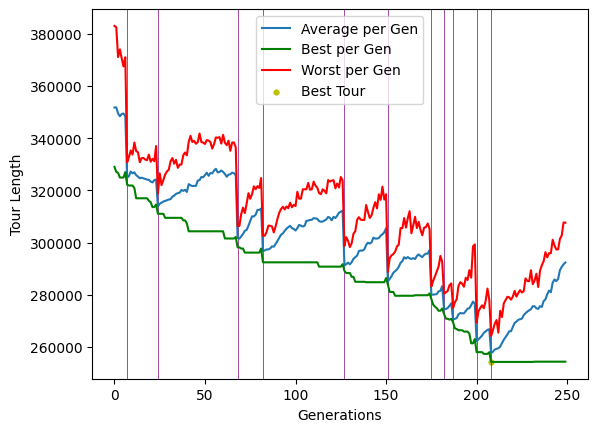

Best Tour Found in generation 208 with length of 254281.98847025982
Completed sub-tour for cluster number 55 --------------------------------------------
Running genetic algorithm on cluster 56 with 402 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 220
26.311196088790894 seconds


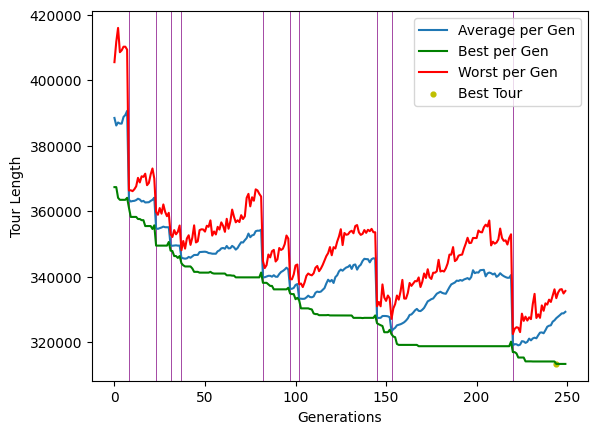

Best Tour Found in generation 244 with length of 313297.41047902615
Completed sub-tour for cluster number 56 --------------------------------------------
Running genetic algorithm on cluster 57 with 495 cities
Reintroduced 75 messiah(s) in generation 2
Reintroduced 75 messiah(s) in generation 73
Reintroduced 75 messiah(s) in generation 165
Reintroduced 75 messiah(s) in generation 183
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 222
32.242732763290405 seconds


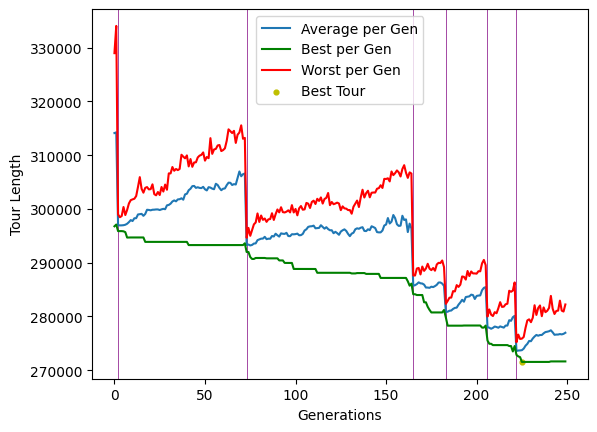

Best Tour Found in generation 225 with length of 271554.7573452491
Completed sub-tour for cluster number 57 --------------------------------------------
Running genetic algorithm on cluster 58 with 331 cities
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 134
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 233
21.497271060943604 seconds


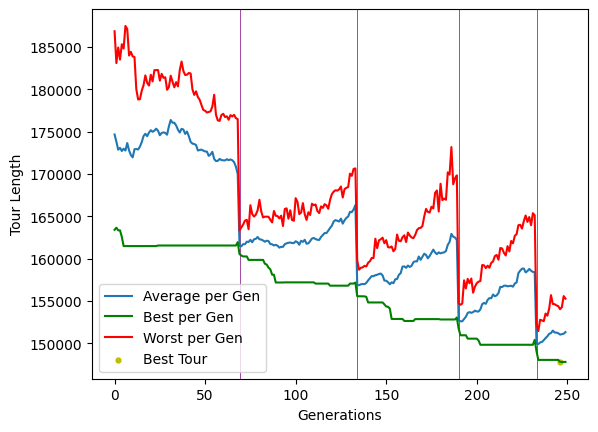

Best Tour Found in generation 246 with length of 147791.40466573983
Completed sub-tour for cluster number 58 --------------------------------------------
Running genetic algorithm on cluster 59 with 385 cities
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 85
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 221
Reintroduced 75 messiah(s) in generation 245
24.98106598854065 seconds


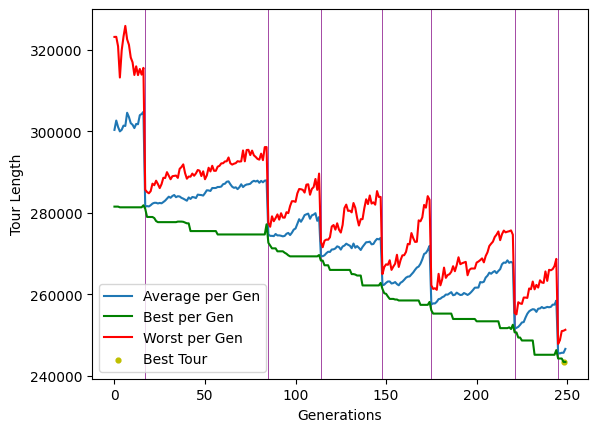

Best Tour Found in generation 248 with length of 243348.6250171891
Completed sub-tour for cluster number 59 --------------------------------------------
Running genetic algorithm on cluster 60 with 229 cities
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 237
14.620822191238403 seconds


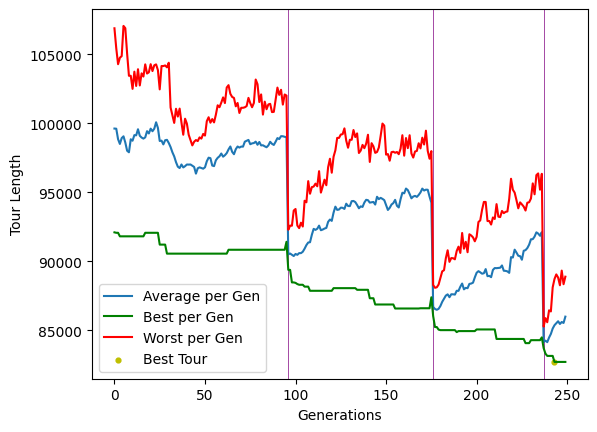

Best Tour Found in generation 243 with length of 82715.60520885419
Completed sub-tour for cluster number 60 --------------------------------------------
Running genetic algorithm on cluster 61 with 404 cities
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 151
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 191
26.283644914627075 seconds


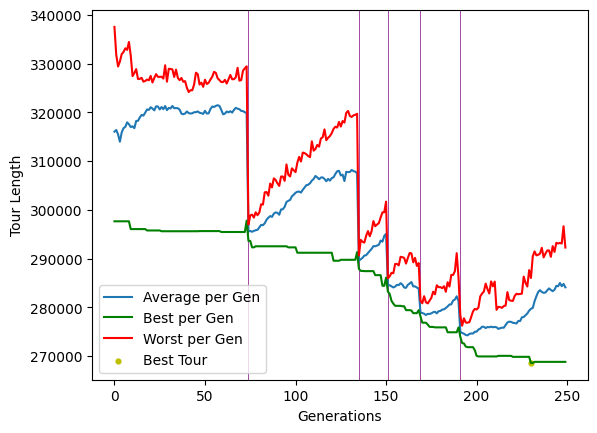

Best Tour Found in generation 230 with length of 268596.04286643944
Completed sub-tour for cluster number 61 --------------------------------------------
Running genetic algorithm on cluster 62 with 595 cities
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 217
Reintroduced 75 messiah(s) in generation 220
39.94458889961243 seconds


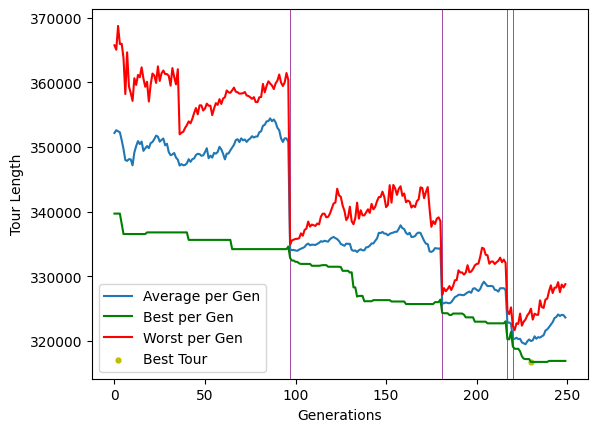

Best Tour Found in generation 230 with length of 316779.57429095614
Completed sub-tour for cluster number 62 --------------------------------------------
Running genetic algorithm on cluster 63 with 702 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 12
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 230
47.14826965332031 seconds


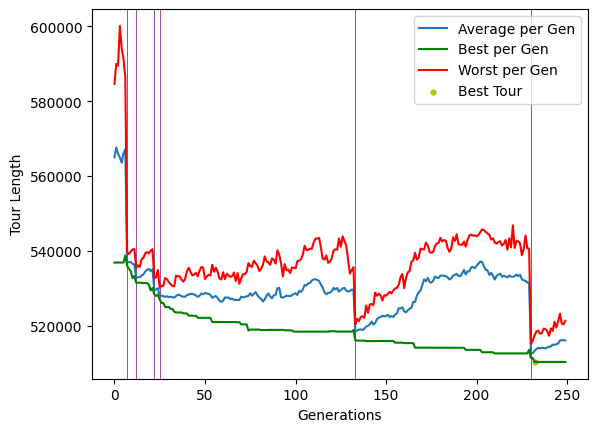

Best Tour Found in generation 232 with length of 510328.9478015291
Completed sub-tour for cluster number 63 --------------------------------------------
Running genetic algorithm on cluster 64 with 885 cities
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 113
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 200
Reintroduced 75 messiah(s) in generation 224
Reintroduced 75 messiah(s) in generation 233
63.48464107513428 seconds


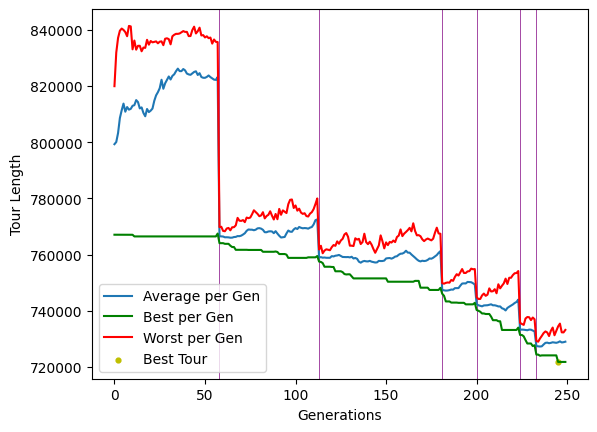

Best Tour Found in generation 245 with length of 721823.9666850393
Completed sub-tour for cluster number 64 --------------------------------------------
Running genetic algorithm on cluster 65 with 426 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 241
28.313903093338013 seconds


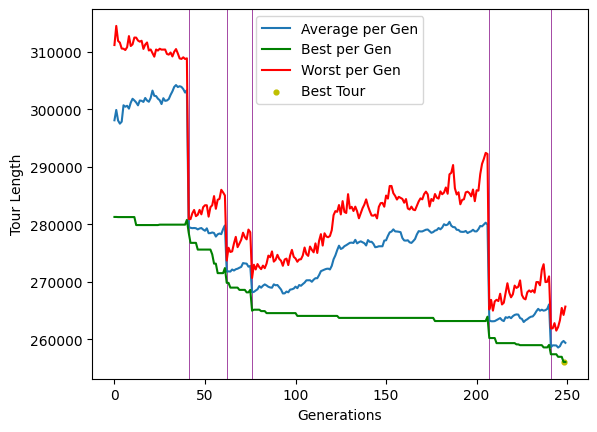

Best Tour Found in generation 248 with length of 256072.43793740927
Completed sub-tour for cluster number 65 --------------------------------------------
Running genetic algorithm on cluster 66 with 790 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 219
54.667248010635376 seconds


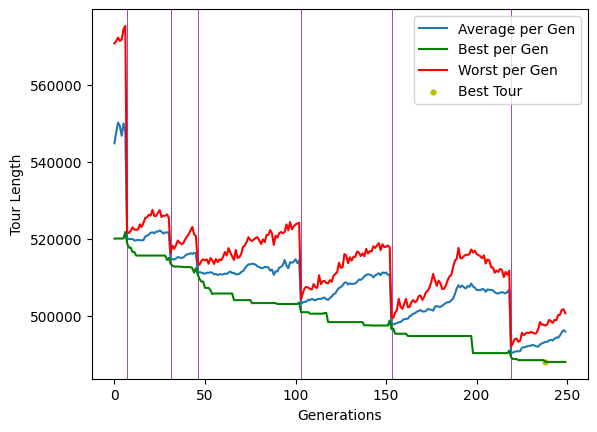

Best Tour Found in generation 238 with length of 488035.08558360103
Completed sub-tour for cluster number 66 --------------------------------------------
Running genetic algorithm on cluster 67 with 564 cities
Reintroduced 75 messiah(s) in generation 9
Reintroduced 75 messiah(s) in generation 136
38.590845823287964 seconds


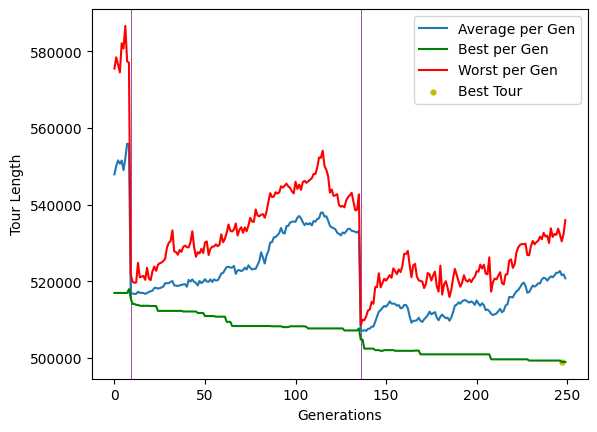

Best Tour Found in generation 247 with length of 498981.6796268773
Completed sub-tour for cluster number 67 --------------------------------------------
Running genetic algorithm on cluster 68 with 651 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 229
44.525967836380005 seconds


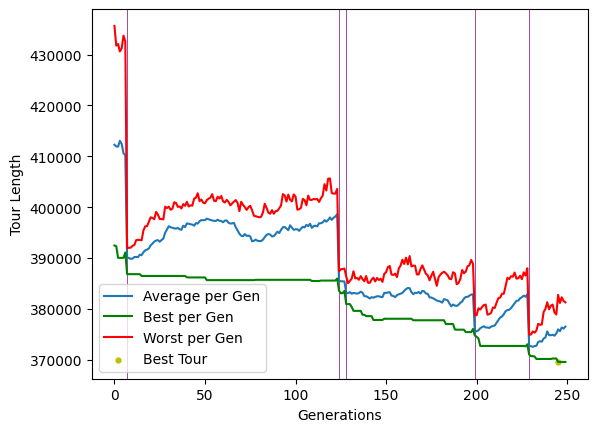

Best Tour Found in generation 245 with length of 369578.4424785857
Completed sub-tour for cluster number 68 --------------------------------------------
Running genetic algorithm on cluster 69 with 349 cities
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 64
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 231
22.753405809402466 seconds


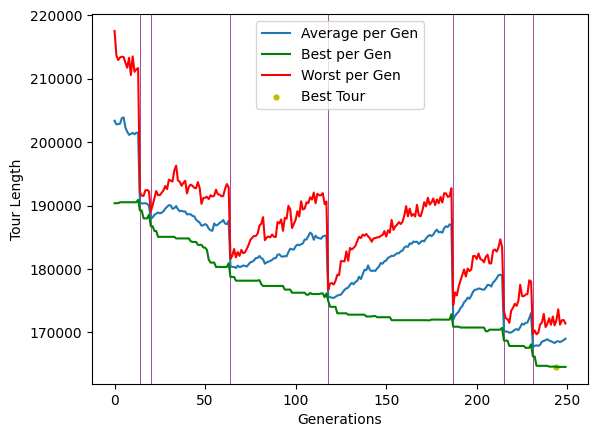

Best Tour Found in generation 244 with length of 164564.1515414868
Completed sub-tour for cluster number 69 --------------------------------------------
Running genetic algorithm on cluster 70 with 411 cities
Reintroduced 75 messiah(s) in generation 4
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 212
27.14338994026184 seconds


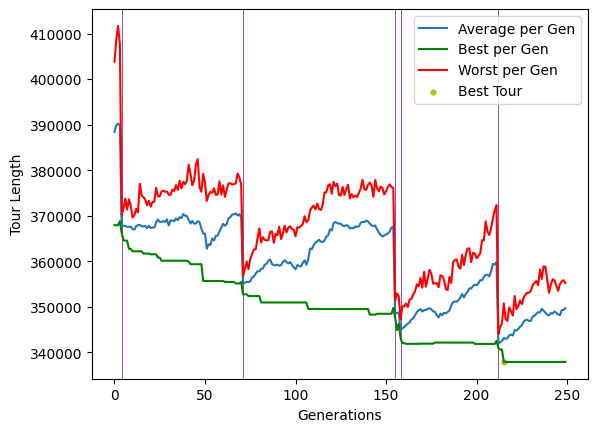

Best Tour Found in generation 215 with length of 337867.4261414997
Completed sub-tour for cluster number 70 --------------------------------------------
Running genetic algorithm on cluster 71 with 424 cities
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 179
28.02249503135681 seconds


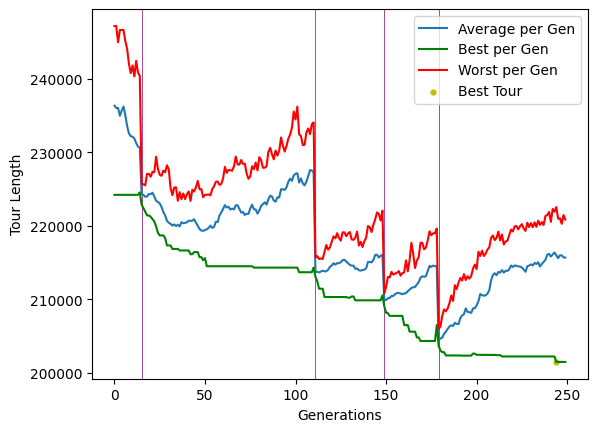

Best Tour Found in generation 244 with length of 201512.0775504762
Completed sub-tour for cluster number 71 --------------------------------------------
Running genetic algorithm on cluster 72 with 261 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 85
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 238
16.844788074493408 seconds


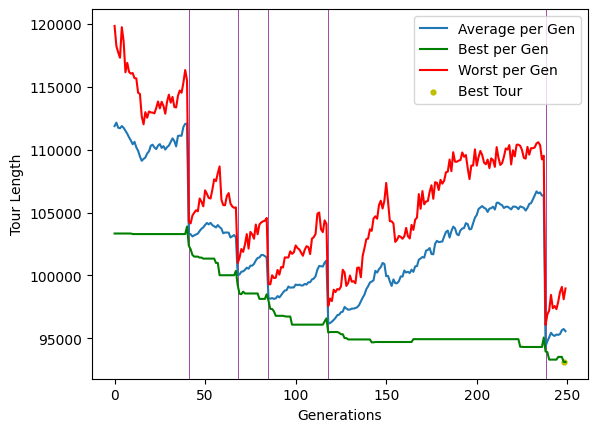

Best Tour Found in generation 248 with length of 93125.24259836109
Completed sub-tour for cluster number 72 --------------------------------------------
Running genetic algorithm on cluster 73 with 811 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 88
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 130
Reintroduced 75 messiah(s) in generation 138
Reintroduced 75 messiah(s) in generation 169
55.12915396690369 seconds


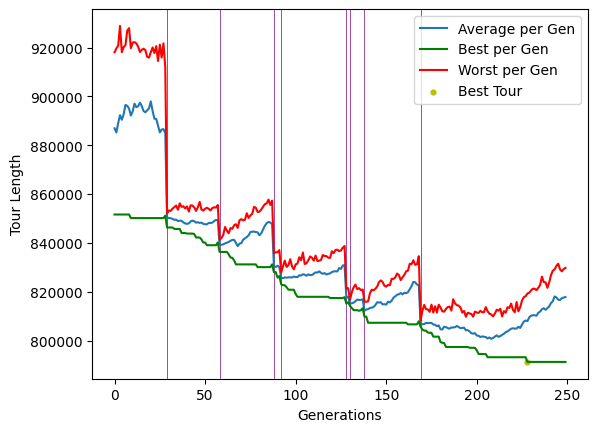

Best Tour Found in generation 228 with length of 791285.3921272448
Completed sub-tour for cluster number 73 --------------------------------------------
Running genetic algorithm on cluster 74 with 461 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 43
Reintroduced 75 messiah(s) in generation 57
Reintroduced 75 messiah(s) in generation 198
30.10712194442749 seconds


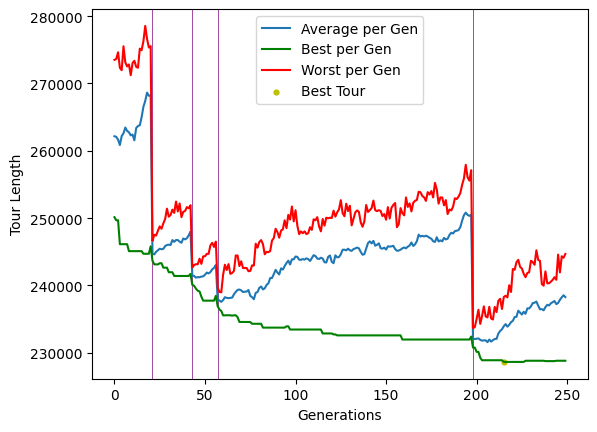

Best Tour Found in generation 215 with length of 228650.18372938148
Completed sub-tour for cluster number 74 --------------------------------------------
Running genetic algorithm on cluster 75 with 235 cities
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 132
Reintroduced 75 messiah(s) in generation 164
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 217
15.052479982376099 seconds


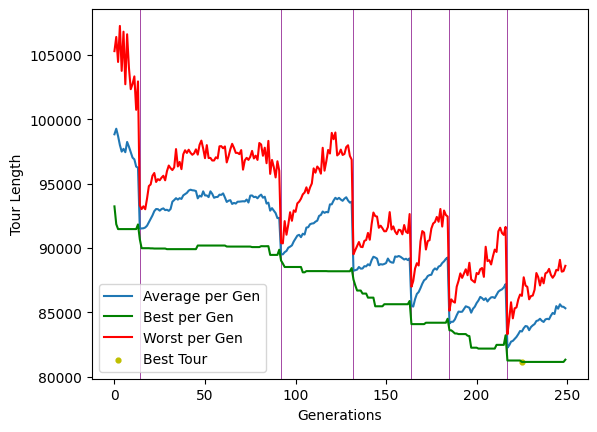

Best Tour Found in generation 225 with length of 81135.36234214512
Completed sub-tour for cluster number 75 --------------------------------------------
Running genetic algorithm on cluster 76 with 379 cities
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 51
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 139
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 236
24.682440996170044 seconds


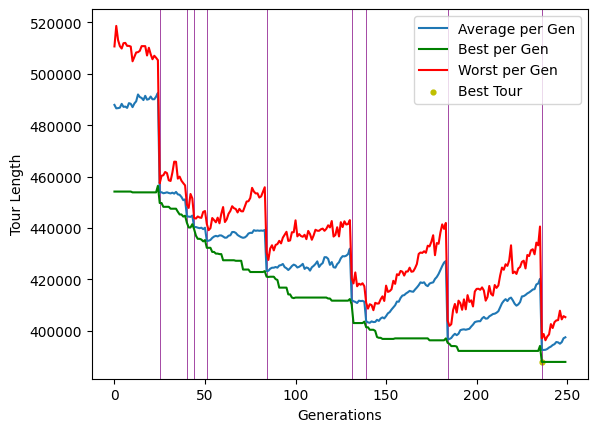

Best Tour Found in generation 236 with length of 387913.30196535547
Completed sub-tour for cluster number 76 --------------------------------------------
Running genetic algorithm on cluster 77 with 277 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 227
17.856658935546875 seconds


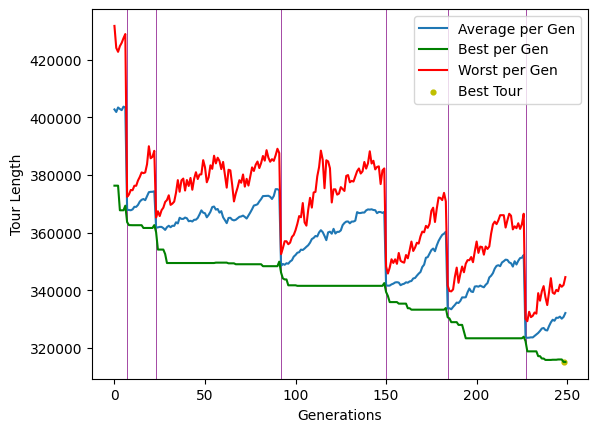

Best Tour Found in generation 248 with length of 315062.7619035956
Completed sub-tour for cluster number 77 --------------------------------------------
Running genetic algorithm on cluster 78 with 355 cities
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 166
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 218
Reintroduced 75 messiah(s) in generation 238
23.006328105926514 seconds


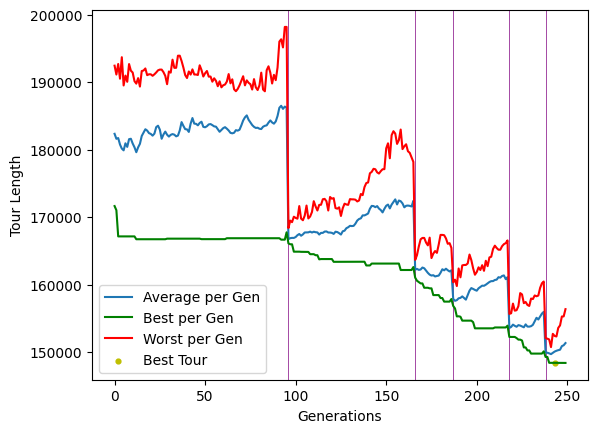

Best Tour Found in generation 243 with length of 148403.55583597286
Completed sub-tour for cluster number 78 --------------------------------------------
Running genetic algorithm on cluster 79 with 250 cities
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 139
Reintroduced 75 messiah(s) in generation 166
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 172
Reintroduced 75 messiah(s) in generation 234
15.966167688369751 seconds


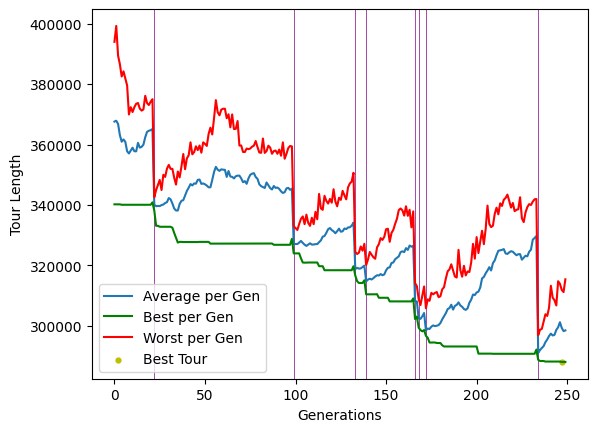

Best Tour Found in generation 247 with length of 288036.5235360645
Completed sub-tour for cluster number 79 --------------------------------------------
Running genetic algorithm on cluster 80 with 324 cities
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 159
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 218
20.908541202545166 seconds


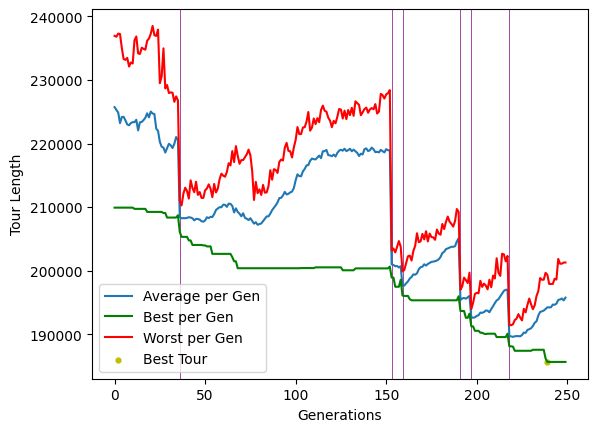

Best Tour Found in generation 239 with length of 185640.37111727658
Completed sub-tour for cluster number 80 --------------------------------------------
Running genetic algorithm on cluster 81 with 793 cities
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 98
Reintroduced 75 messiah(s) in generation 101
Reintroduced 75 messiah(s) in generation 109
53.33849906921387 seconds


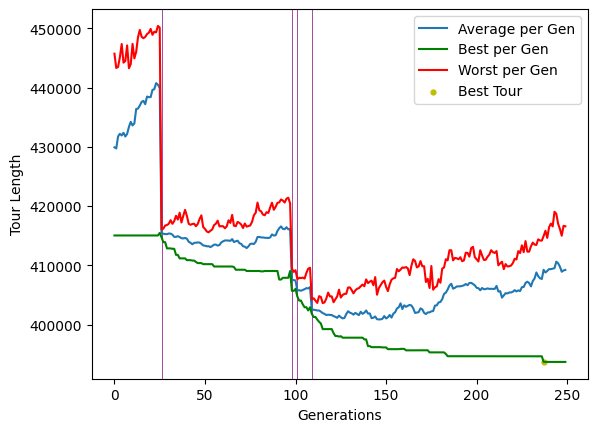

Best Tour Found in generation 237 with length of 393690.06972173933
Completed sub-tour for cluster number 81 --------------------------------------------
Running genetic algorithm on cluster 82 with 362 cities
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 215
23.453524827957153 seconds


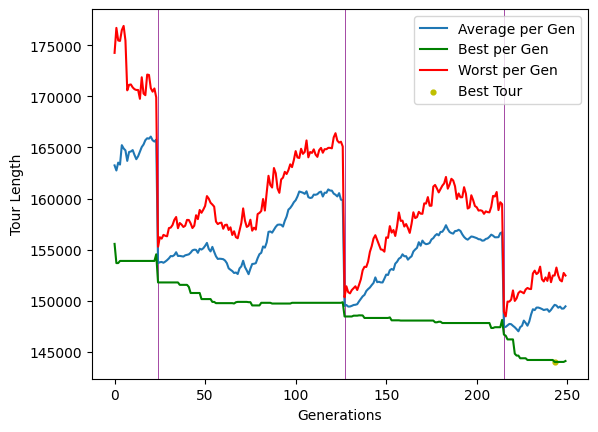

Best Tour Found in generation 243 with length of 144019.37739016264
Completed sub-tour for cluster number 82 --------------------------------------------
Running genetic algorithm on cluster 83 with 281 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 79
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 214
18.08621907234192 seconds


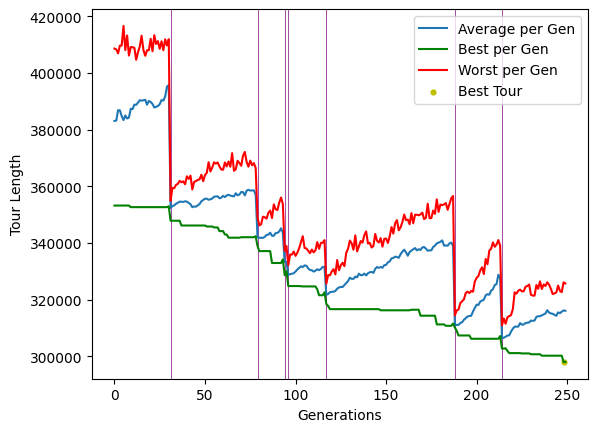

Best Tour Found in generation 248 with length of 298018.5420092294
Completed sub-tour for cluster number 83 --------------------------------------------
Running genetic algorithm on cluster 84 with 654 cities
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 121
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 241
43.91023826599121 seconds


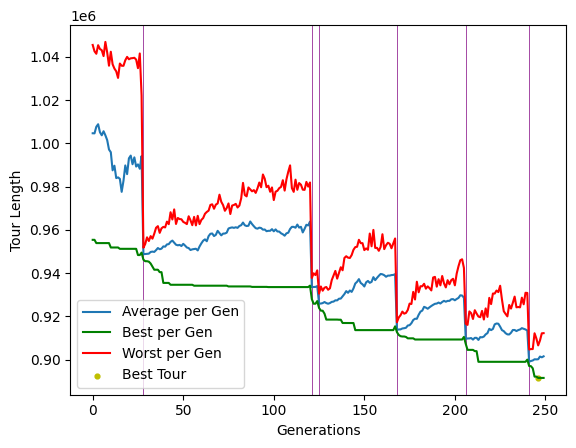

Best Tour Found in generation 246 with length of 891555.8334591929
Completed sub-tour for cluster number 84 --------------------------------------------
Running genetic algorithm on cluster 85 with 178 cities
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 207
11.500690221786499 seconds


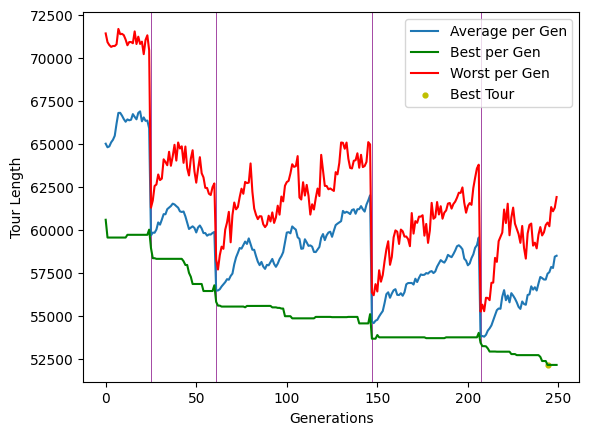

Best Tour Found in generation 244 with length of 52165.01794696763
Completed sub-tour for cluster number 85 --------------------------------------------
Running genetic algorithm on cluster 86 with 504 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 34
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 139
Reintroduced 75 messiah(s) in generation 165
Reintroduced 75 messiah(s) in generation 200
33.644810914993286 seconds


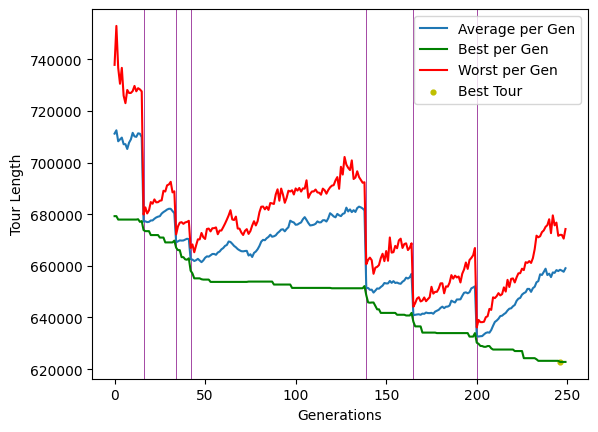

Best Tour Found in generation 246 with length of 622792.7976143047
Completed sub-tour for cluster number 86 --------------------------------------------
Running genetic algorithm on cluster 87 with 356 cities
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 137
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 221
23.136992931365967 seconds


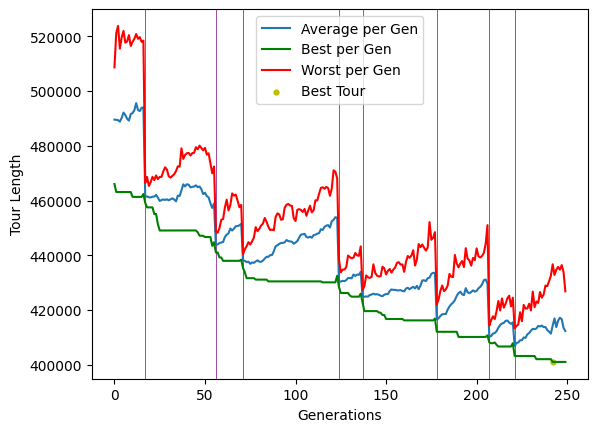

Best Tour Found in generation 242 with length of 401033.58075976686
Completed sub-tour for cluster number 87 --------------------------------------------
Running genetic algorithm on cluster 88 with 179 cities
Reintroduced 75 messiah(s) in generation 49
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 193
11.448945760726929 seconds


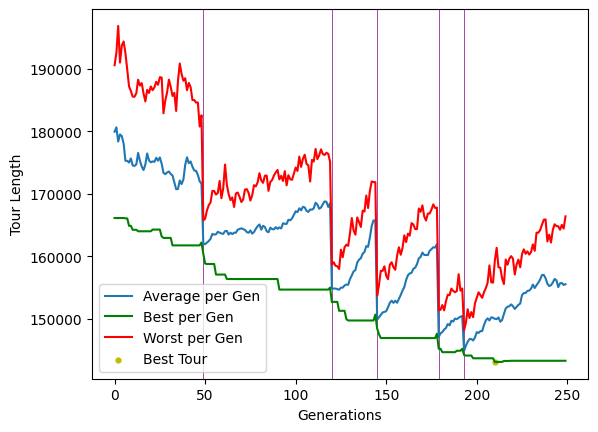

Best Tour Found in generation 210 with length of 143093.19081001118
Completed sub-tour for cluster number 88 --------------------------------------------
Running genetic algorithm on cluster 89 with 612 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 130
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 218
41.458406925201416 seconds


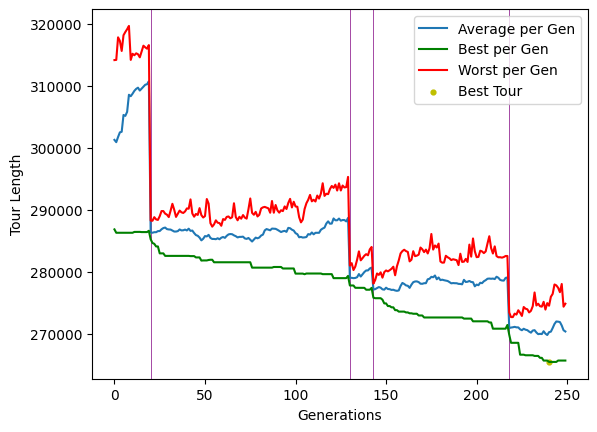

Best Tour Found in generation 240 with length of 265474.7127664275
Completed sub-tour for cluster number 89 --------------------------------------------
Running genetic algorithm on cluster 90 with 176 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 215
11.70371675491333 seconds


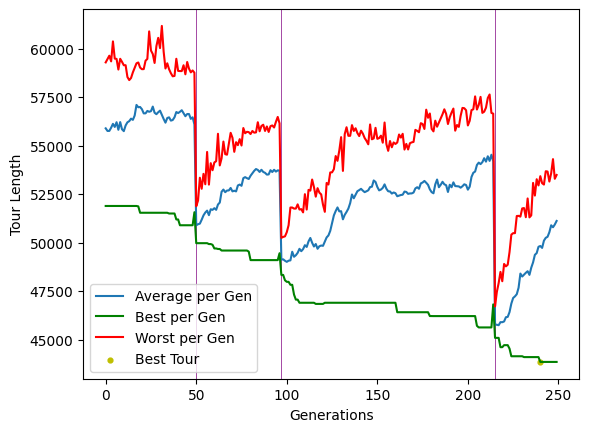

Best Tour Found in generation 240 with length of 43844.752034458885
Completed sub-tour for cluster number 90 --------------------------------------------
Running genetic algorithm on cluster 91 with 202 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 190
13.204149007797241 seconds


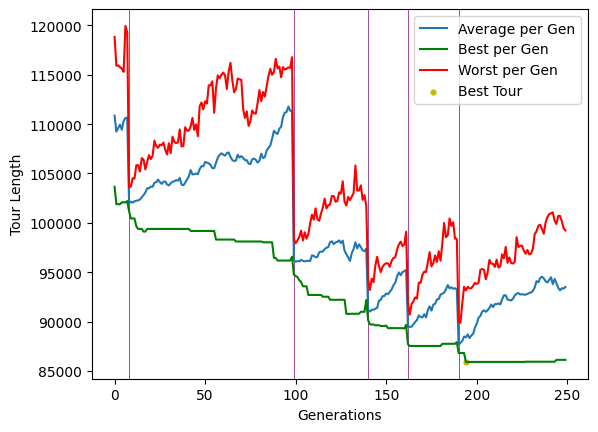

Best Tour Found in generation 194 with length of 85910.80327250567
Completed sub-tour for cluster number 91 --------------------------------------------
Running genetic algorithm on cluster 92 with 665 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 241
Reintroduced 75 messiah(s) in generation 247
44.946051836013794 seconds


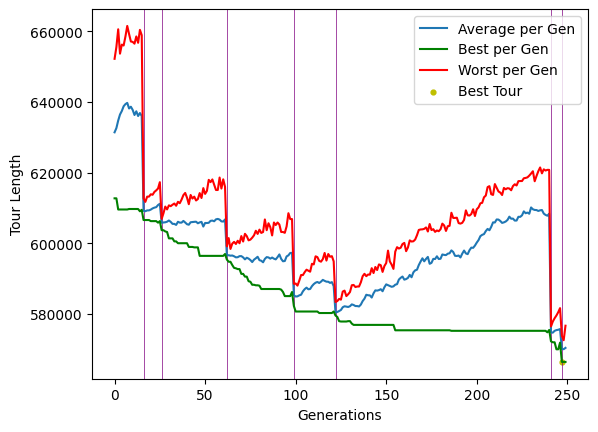

Best Tour Found in generation 247 with length of 566327.9939925466
Completed sub-tour for cluster number 92 --------------------------------------------
Running genetic algorithm on cluster 93 with 252 cities
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 195
16.222940921783447 seconds


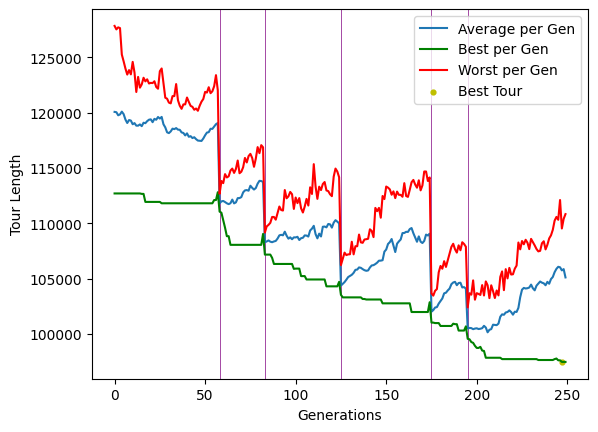

Best Tour Found in generation 247 with length of 97473.06143080804
Completed sub-tour for cluster number 93 --------------------------------------------
Running genetic algorithm on cluster 94 with 184 cities
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 203
Reintroduced 75 messiah(s) in generation 223
11.975634098052979 seconds


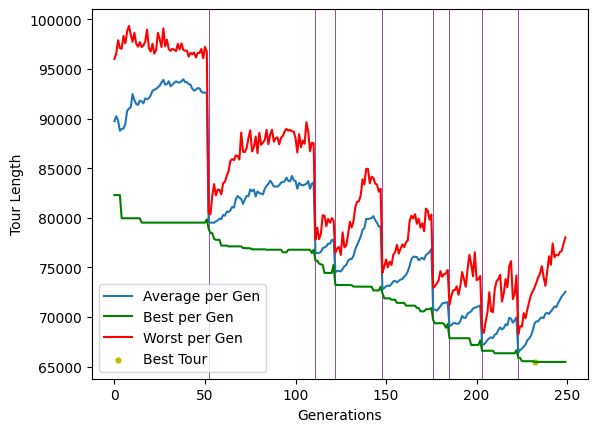

Best Tour Found in generation 232 with length of 65476.59918252702
Completed sub-tour for cluster number 94 --------------------------------------------
Running genetic algorithm on cluster 95 with 655 cities
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 225
44.35198378562927 seconds


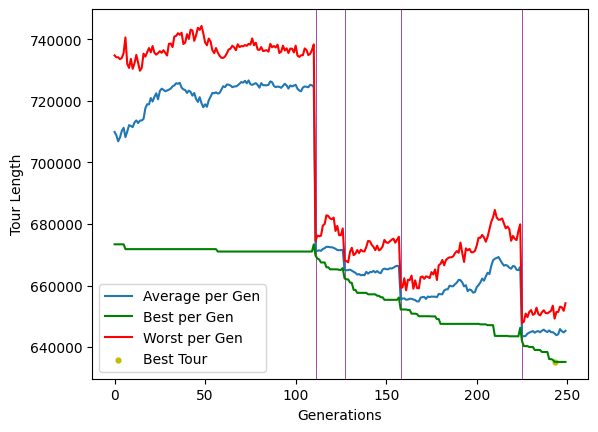

Best Tour Found in generation 243 with length of 635160.1807308311
Completed sub-tour for cluster number 95 --------------------------------------------
Running genetic algorithm on cluster 96 with 707 cities
Reintroduced 75 messiah(s) in generation 98
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 241
48.14029598236084 seconds


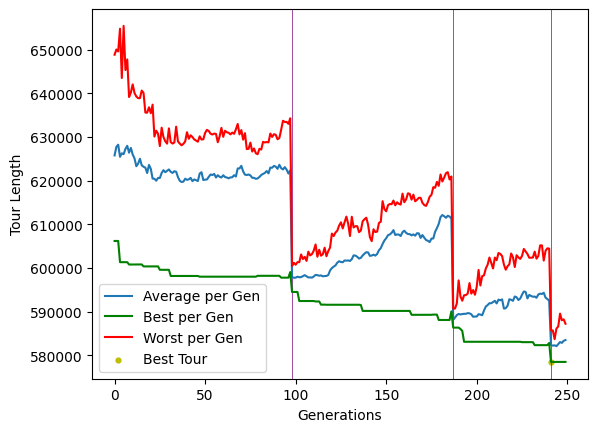

Best Tour Found in generation 241 with length of 578512.8595880651
Completed sub-tour for cluster number 96 --------------------------------------------
Running genetic algorithm on cluster 97 with 222 cities
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 226
14.304946184158325 seconds


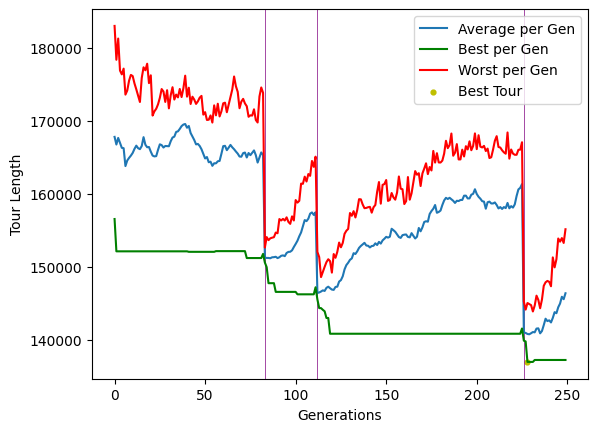

Best Tour Found in generation 228 with length of 136936.13379602565
Completed sub-tour for cluster number 97 --------------------------------------------
Running genetic algorithm on cluster 98 with 902 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 64
Reintroduced 75 messiah(s) in generation 93
Reintroduced 75 messiah(s) in generation 155
60.8945209980011 seconds


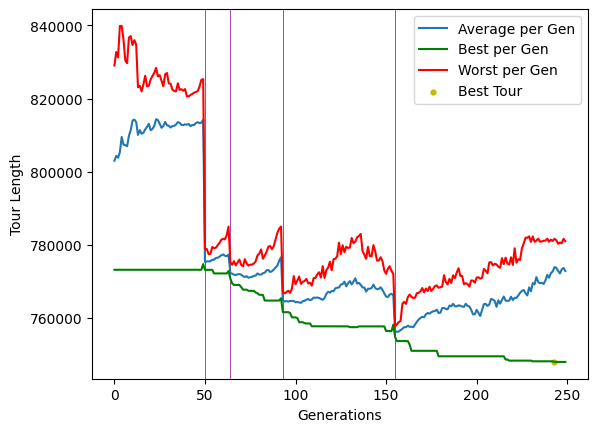

Best Tour Found in generation 243 with length of 747964.3502278011
Completed sub-tour for cluster number 98 --------------------------------------------
Running genetic algorithm on cluster 99 with 241 cities
Reintroduced 75 messiah(s) in generation 226
15.592600107192993 seconds


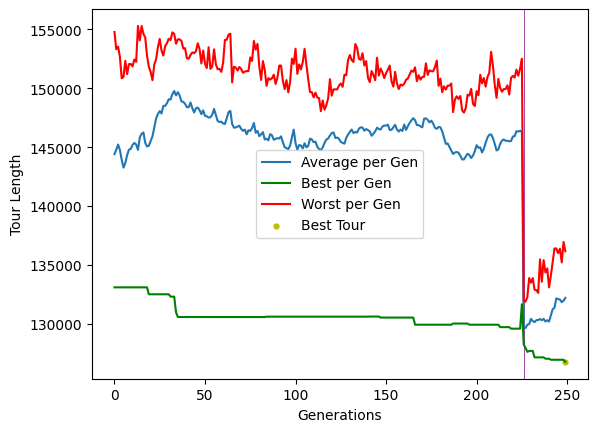

Best Tour Found in generation 249 with length of 126763.62088902332
Completed sub-tour for cluster number 99 --------------------------------------------
Running genetic algorithm on cluster 100 with 551 cities
Reintroduced 75 messiah(s) in generation 104
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 240
37.15656590461731 seconds


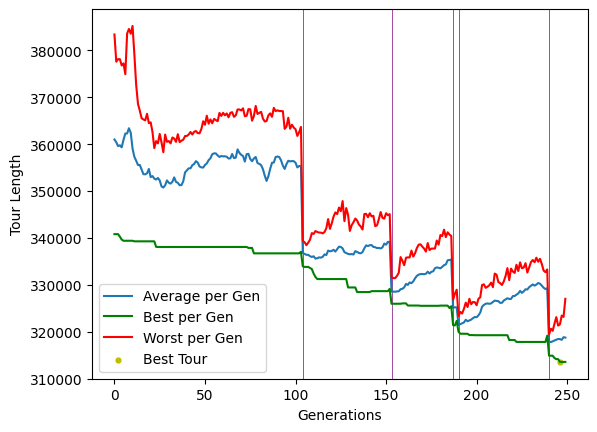

Best Tour Found in generation 246 with length of 313537.0630410352
Completed sub-tour for cluster number 100 --------------------------------------------
Running genetic algorithm on cluster 101 with 320 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 246
20.58692693710327 seconds


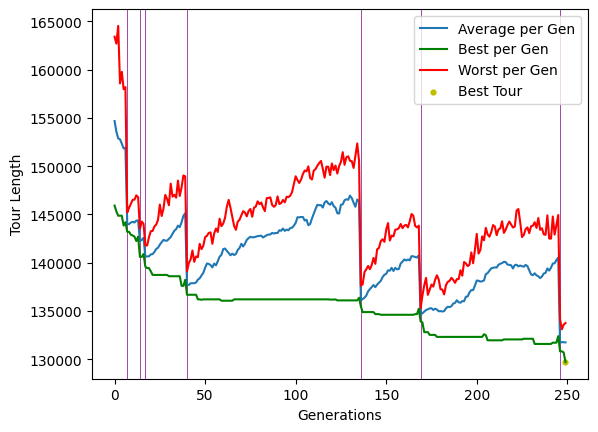

Best Tour Found in generation 249 with length of 129714.35497985964
Completed sub-tour for cluster number 101 --------------------------------------------
Running genetic algorithm on cluster 102 with 1045 cities
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 90
Reintroduced 75 messiah(s) in generation 132
Reintroduced 75 messiah(s) in generation 156
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 229
72.00501012802124 seconds


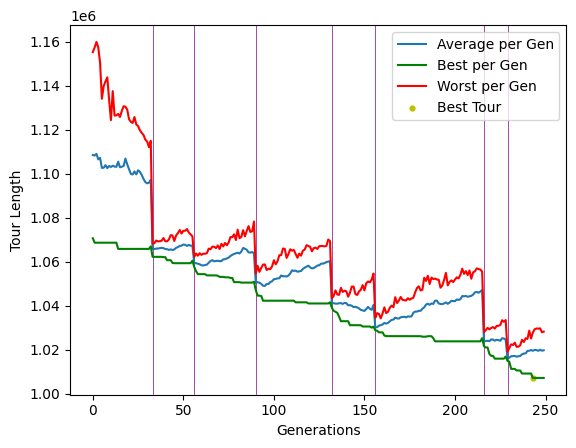

Best Tour Found in generation 243 with length of 1007093.2854718108
Completed sub-tour for cluster number 102 --------------------------------------------
Running genetic algorithm on cluster 103 with 350 cities
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 241
22.777323007583618 seconds


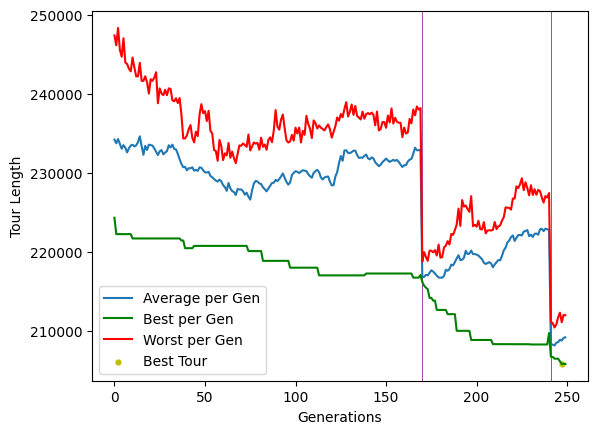

Best Tour Found in generation 247 with length of 205814.09644599239
Completed sub-tour for cluster number 103 --------------------------------------------
Running genetic algorithm on cluster 104 with 344 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 208
Reintroduced 75 messiah(s) in generation 230
22.215131759643555 seconds


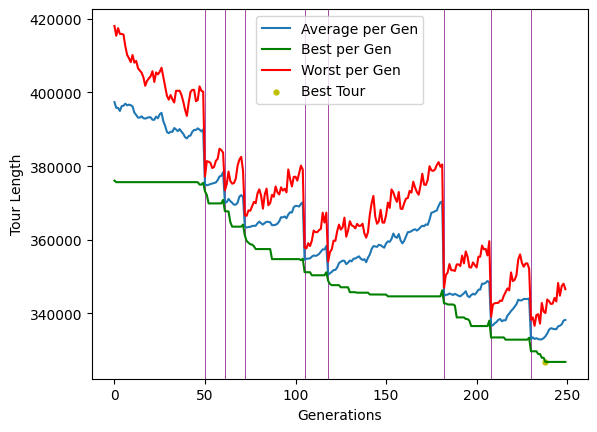

Best Tour Found in generation 238 with length of 326839.137809753
Completed sub-tour for cluster number 104 --------------------------------------------
Running genetic algorithm on cluster 105 with 505 cities
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 229
33.821614027023315 seconds


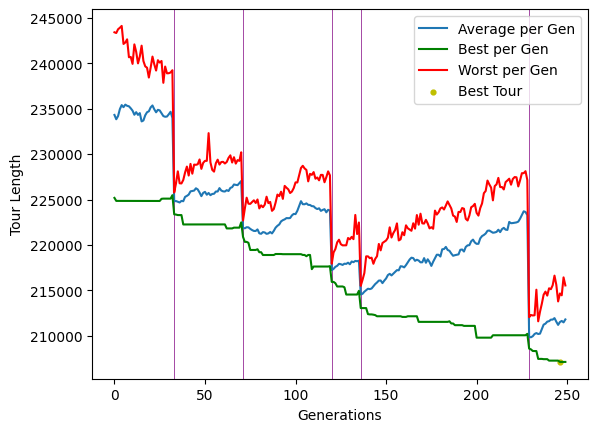

Best Tour Found in generation 246 with length of 207140.55634289188
Completed sub-tour for cluster number 105 --------------------------------------------
Running genetic algorithm on cluster 106 with 227 cities
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 237
14.604059934616089 seconds


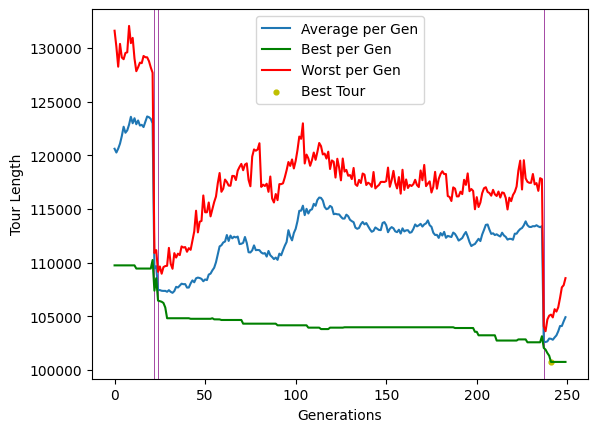

Best Tour Found in generation 241 with length of 100742.28523287771
Completed sub-tour for cluster number 106 --------------------------------------------
Running genetic algorithm on cluster 107 with 402 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 77
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 163
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 231
26.243957996368408 seconds


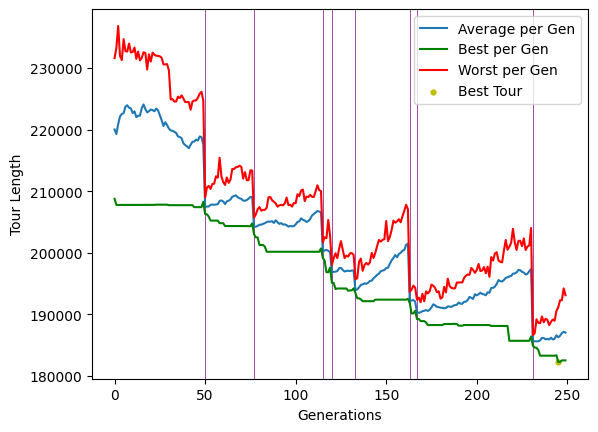

Best Tour Found in generation 245 with length of 182260.40626536927
Completed sub-tour for cluster number 107 --------------------------------------------
Running genetic algorithm on cluster 108 with 431 cities
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 217
28.189149141311646 seconds


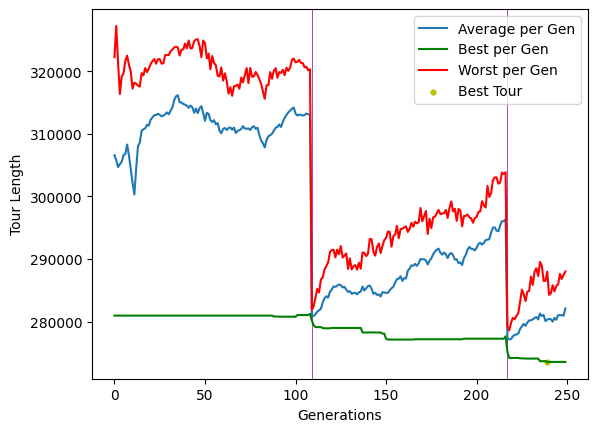

Best Tour Found in generation 239 with length of 273570.41053166223
Completed sub-tour for cluster number 108 --------------------------------------------
Running genetic algorithm on cluster 109 with 321 cities
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 221
20.7449152469635 seconds


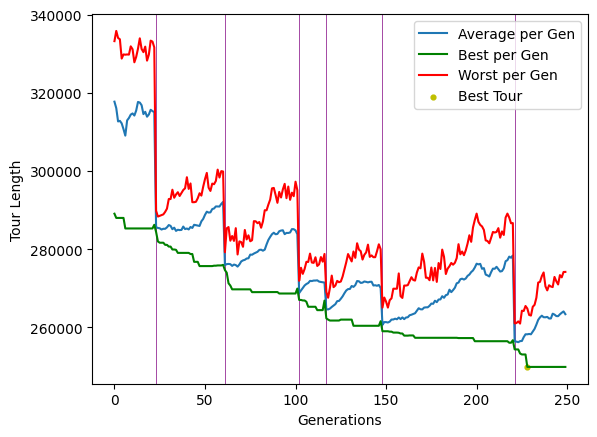

Best Tour Found in generation 228 with length of 249844.19050862594
Completed sub-tour for cluster number 109 --------------------------------------------
Running genetic algorithm on cluster 110 with 535 cities
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 79
Reintroduced 75 messiah(s) in generation 91
Reintroduced 75 messiah(s) in generation 161
36.04678988456726 seconds


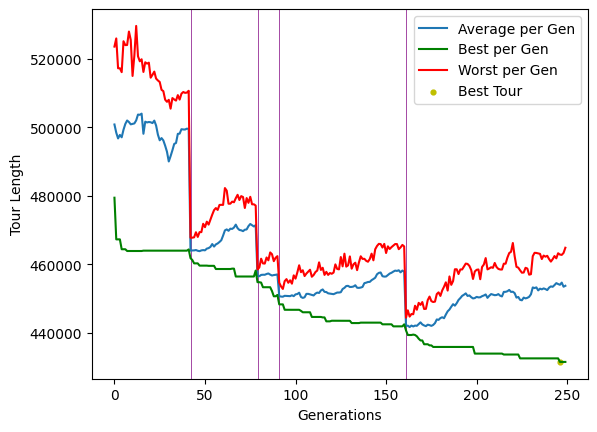

Best Tour Found in generation 246 with length of 431458.6234798658
Completed sub-tour for cluster number 110 --------------------------------------------
Running genetic algorithm on cluster 111 with 501 cities
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 134
Reintroduced 75 messiah(s) in generation 232
33.59835410118103 seconds


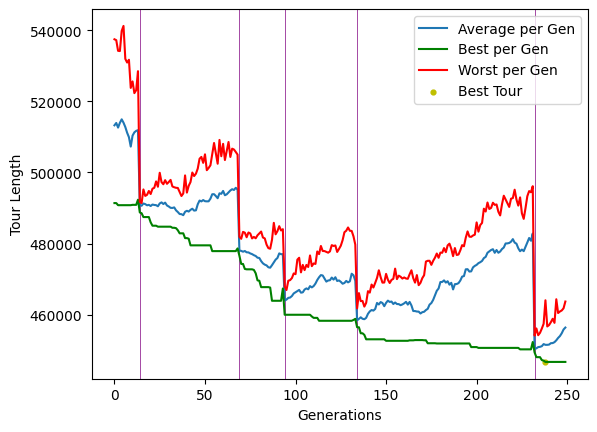

Best Tour Found in generation 238 with length of 446711.765520751
Completed sub-tour for cluster number 111 --------------------------------------------
Running genetic algorithm on cluster 112 with 238 cities
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 212
15.304672956466675 seconds


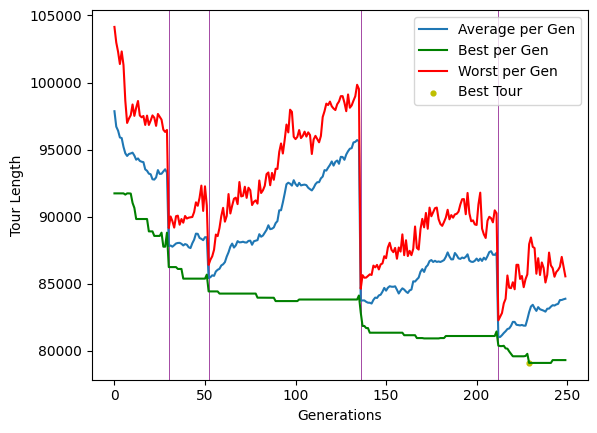

Best Tour Found in generation 229 with length of 79089.74620893235
Completed sub-tour for cluster number 112 --------------------------------------------
Running genetic algorithm on cluster 113 with 218 cities
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 38
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 180
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 228
Reintroduced 75 messiah(s) in generation 238
14.000707149505615 seconds


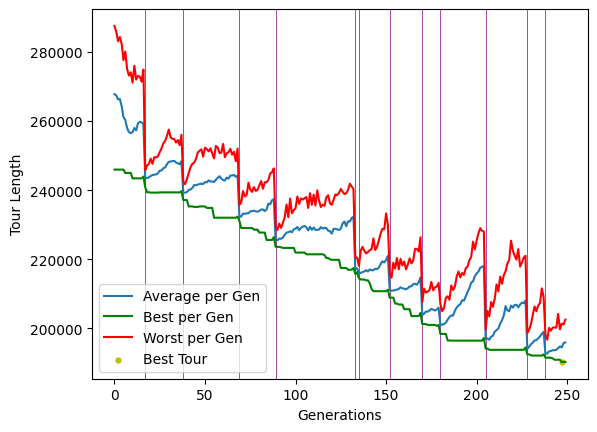

Best Tour Found in generation 247 with length of 190259.5218727101
Completed sub-tour for cluster number 113 --------------------------------------------
Running genetic algorithm on cluster 114 with 401 cities
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 210
Reintroduced 75 messiah(s) in generation 240
Reintroduced 75 messiah(s) in generation 248
26.046316146850586 seconds


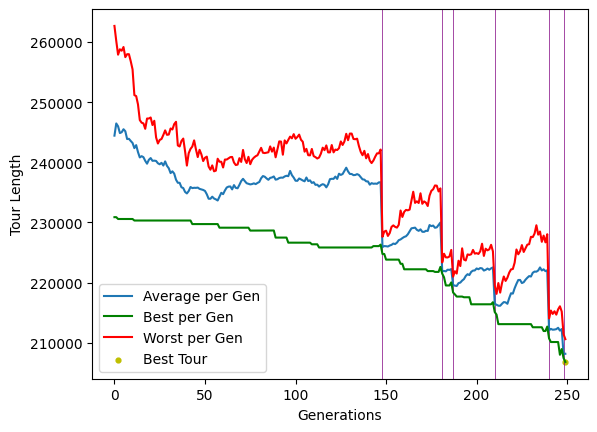

Best Tour Found in generation 249 with length of 206797.4570496068
Completed sub-tour for cluster number 114 --------------------------------------------
Running genetic algorithm on cluster 115 with 273 cities
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 101
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 217
Reintroduced 75 messiah(s) in generation 221
Reintroduced 75 messiah(s) in generation 227
17.553725004196167 seconds


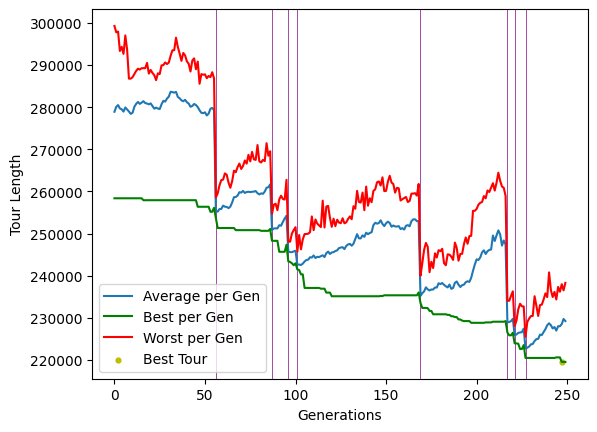

Best Tour Found in generation 247 with length of 219547.62018387063
Completed sub-tour for cluster number 115 --------------------------------------------
Running genetic algorithm on cluster 116 with 156 cities
Reintroduced 75 messiah(s) in generation 51
Reintroduced 75 messiah(s) in generation 86
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 165
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 241
10.068780183792114 seconds


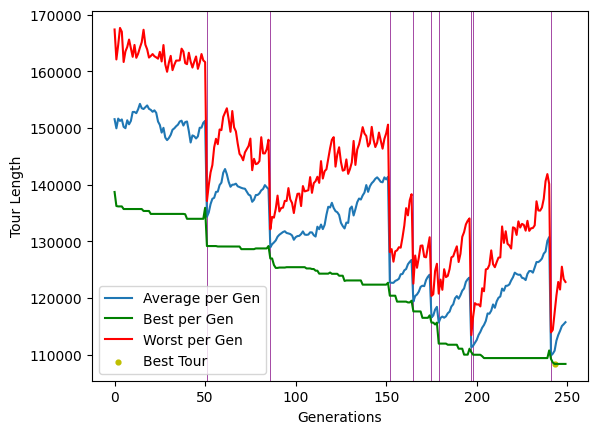

Best Tour Found in generation 243 with length of 108350.6990607481
Completed sub-tour for cluster number 116 --------------------------------------------
Running genetic algorithm on cluster 117 with 146 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 193
9.48357105255127 seconds


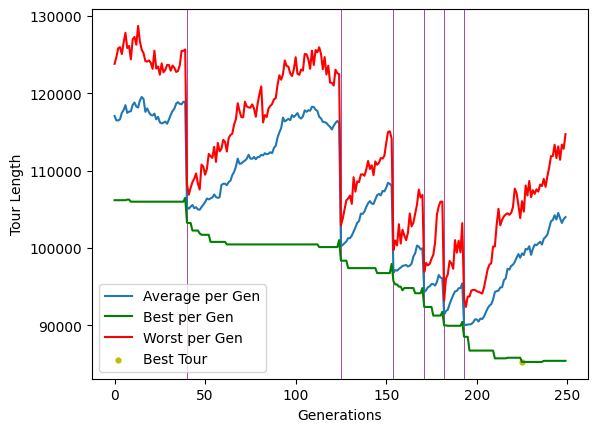

Best Tour Found in generation 225 with length of 85246.88140766232
Completed sub-tour for cluster number 117 --------------------------------------------
Running genetic algorithm on cluster 118 with 377 cities
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 144
Reintroduced 75 messiah(s) in generation 183
Reintroduced 75 messiah(s) in generation 237
Reintroduced 75 messiah(s) in generation 245
24.456949949264526 seconds


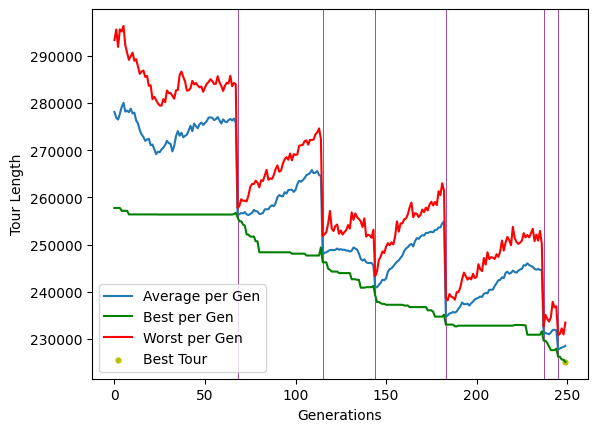

Best Tour Found in generation 249 with length of 225121.29874704374
Completed sub-tour for cluster number 118 --------------------------------------------
Running genetic algorithm on cluster 119 with 283 cities
Reintroduced 75 messiah(s) in generation 85
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 165
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 220
18.351457118988037 seconds


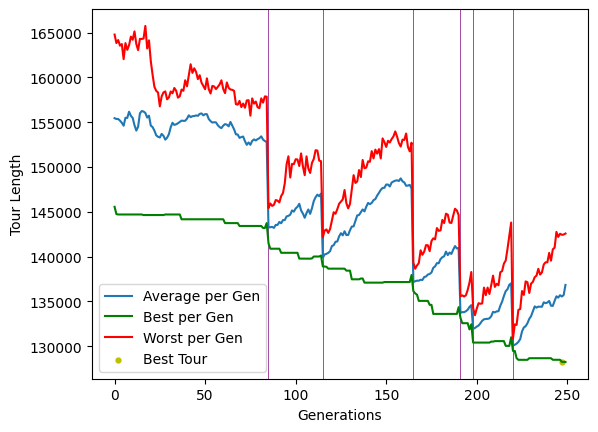

Best Tour Found in generation 247 with length of 128238.41974780624
Completed sub-tour for cluster number 119 --------------------------------------------
Running genetic algorithm on cluster 120 with 319 cities
Reintroduced 75 messiah(s) in generation 19
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 194
20.688832998275757 seconds


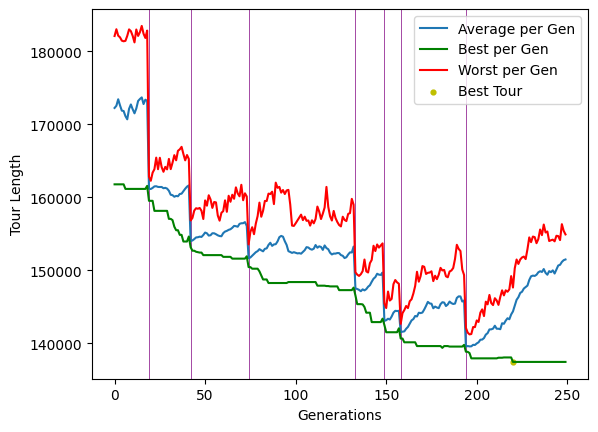

Best Tour Found in generation 220 with length of 137449.7416361807
Completed sub-tour for cluster number 120 --------------------------------------------
Running genetic algorithm on cluster 121 with 139 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 113
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 189
8.950731992721558 seconds


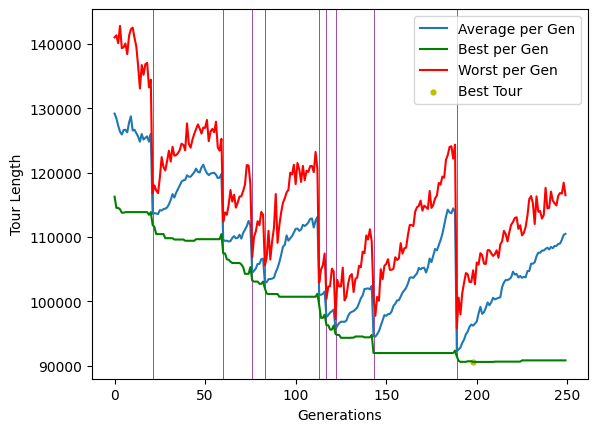

Best Tour Found in generation 198 with length of 90569.03273463433
Completed sub-tour for cluster number 121 --------------------------------------------
Running genetic algorithm on cluster 122 with 327 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 183
Reintroduced 75 messiah(s) in generation 196
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 229
21.077779293060303 seconds


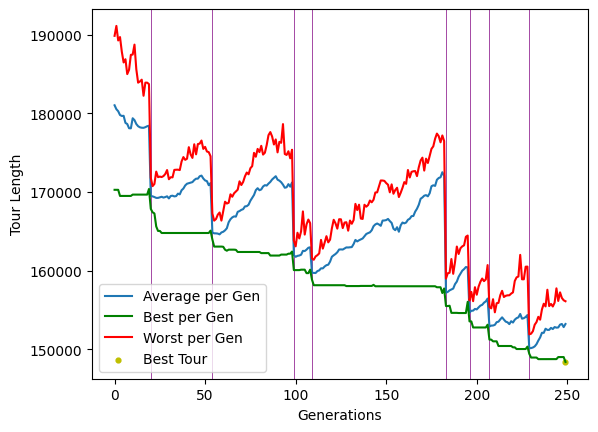

Best Tour Found in generation 249 with length of 148395.1829703679
Completed sub-tour for cluster number 122 --------------------------------------------
Running genetic algorithm on cluster 123 with 516 cities
Reintroduced 75 messiah(s) in generation 121
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 230
34.7422821521759 seconds


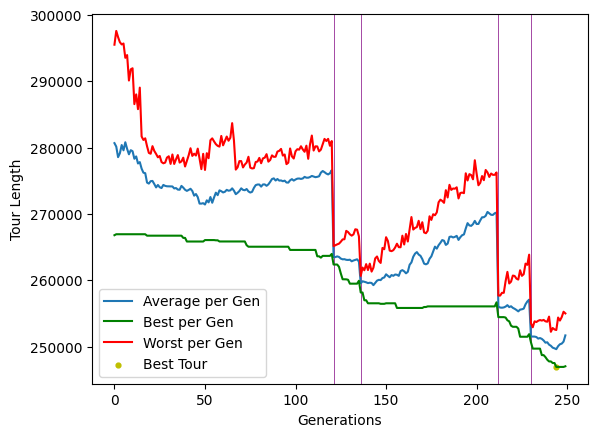

Best Tour Found in generation 244 with length of 246962.06993487081
Completed sub-tour for cluster number 123 --------------------------------------------
Running genetic algorithm on cluster 124 with 426 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 241
27.698015928268433 seconds


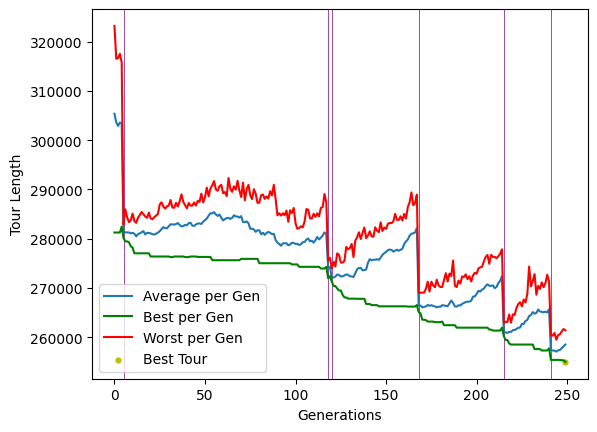

Best Tour Found in generation 249 with length of 254966.6412379586
Completed sub-tour for cluster number 124 --------------------------------------------
Running genetic algorithm on cluster 125 with 199 cities
Reintroduced 75 messiah(s) in generation 12
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 231
Reintroduced 75 messiah(s) in generation 244
12.906378984451294 seconds


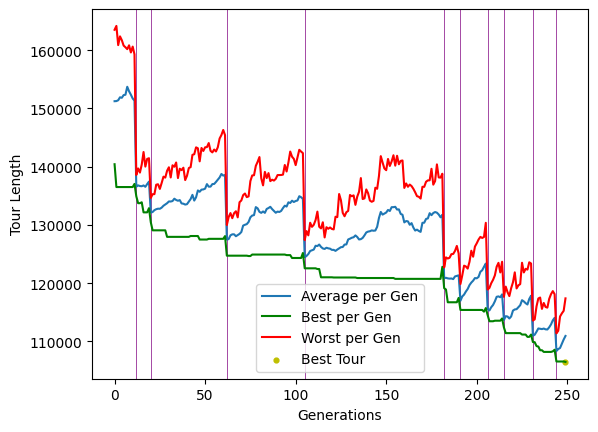

Best Tour Found in generation 249 with length of 106491.35769745418
Completed sub-tour for cluster number 125 --------------------------------------------
Running genetic algorithm on cluster 126 with 517 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 233
Reintroduced 75 messiah(s) in generation 239
34.563254833221436 seconds


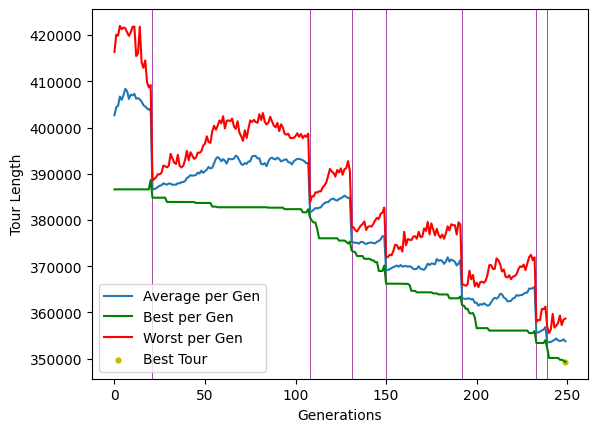

Best Tour Found in generation 249 with length of 349267.8893799984
Completed sub-tour for cluster number 126 --------------------------------------------
Running genetic algorithm on cluster 127 with 269 cities
Reintroduced 75 messiah(s) in generation 34
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 141
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 245
17.300087213516235 seconds


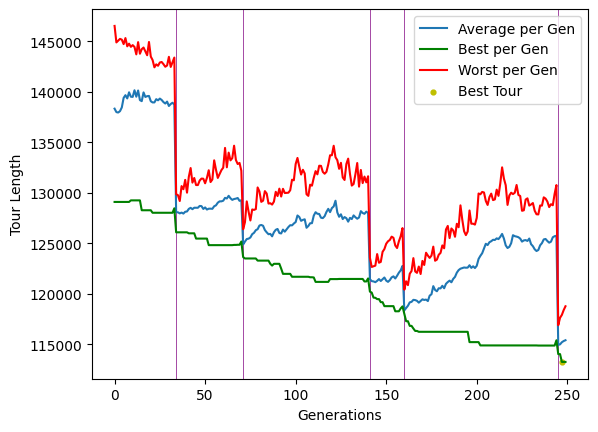

Best Tour Found in generation 247 with length of 113250.50651175214
Completed sub-tour for cluster number 127 --------------------------------------------
Running genetic algorithm on cluster 128 with 295 cities
Reintroduced 75 messiah(s) in generation 9
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 163
Reintroduced 75 messiah(s) in generation 229
Reintroduced 75 messiah(s) in generation 250
19.0641930103302 seconds


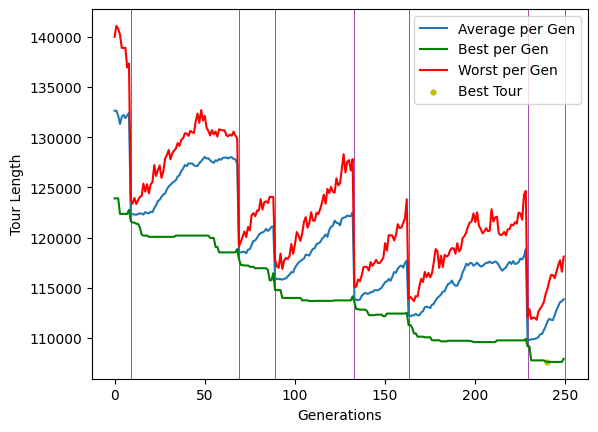

Best Tour Found in generation 240 with length of 107617.44284165704
Completed sub-tour for cluster number 128 --------------------------------------------
Running genetic algorithm on cluster 129 with 262 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 91
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 222
Reintroduced 75 messiah(s) in generation 223
Reintroduced 75 messiah(s) in generation 224
Reintroduced 75 messiah(s) in generation 225
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 227
Reintroduced 75 messiah(s) in g

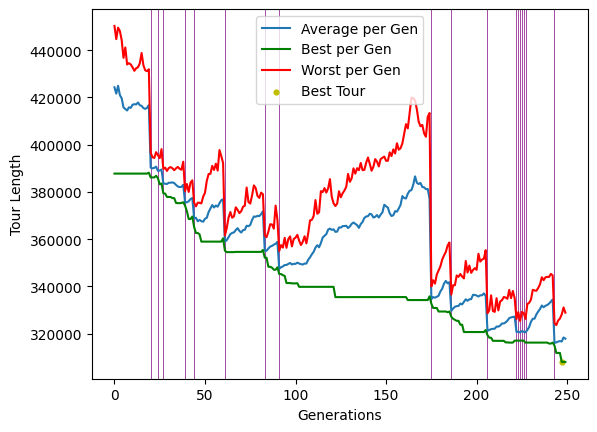

Best Tour Found in generation 247 with length of 308073.8012633362
Completed sub-tour for cluster number 129 --------------------------------------------
Running genetic algorithm on cluster 130 with 628 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 19
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 119
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 199
42.5093252658844 seconds


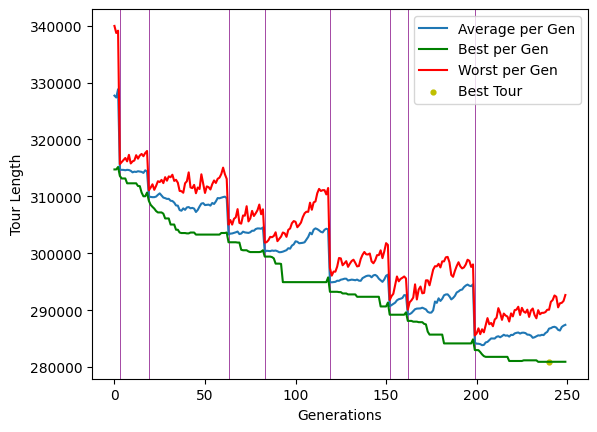

Best Tour Found in generation 240 with length of 280902.0560934128
Completed sub-tour for cluster number 130 --------------------------------------------
Running genetic algorithm on cluster 131 with 879 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 77
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 211
Reintroduced 75 messiah(s) in generation 218
59.61626219749451 seconds


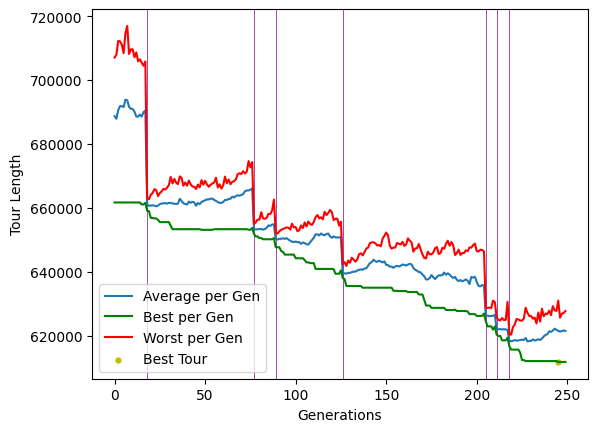

Best Tour Found in generation 245 with length of 611762.2554355164
Completed sub-tour for cluster number 131 --------------------------------------------
Running genetic algorithm on cluster 132 with 498 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 43
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 211
32.69608807563782 seconds


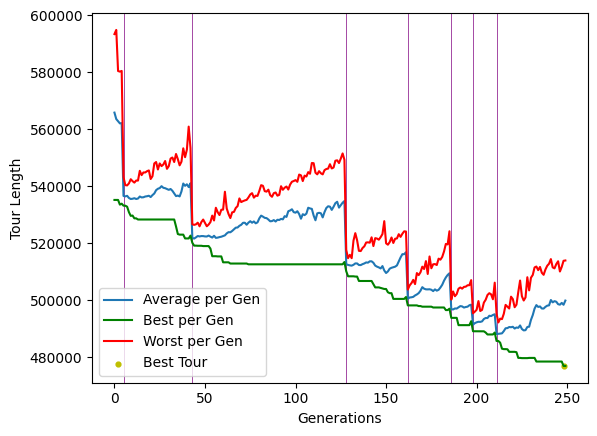

Best Tour Found in generation 248 with length of 476867.95316368603
Completed sub-tour for cluster number 132 --------------------------------------------
Running genetic algorithm on cluster 133 with 275 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 215
17.696961164474487 seconds


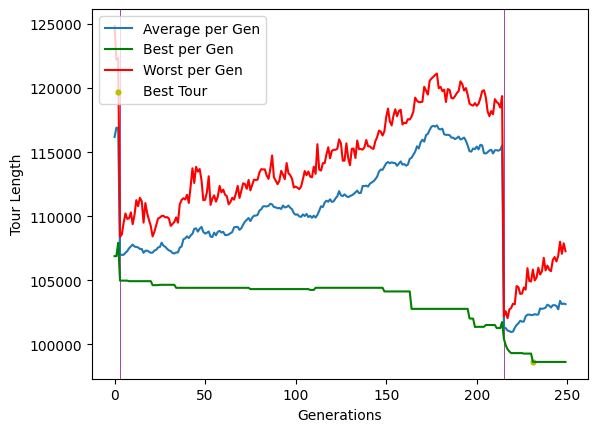

Best Tour Found in generation 231 with length of 98624.43674438649
Completed sub-tour for cluster number 133 --------------------------------------------
Running genetic algorithm on cluster 134 with 523 cities
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 247
35.008748054504395 seconds


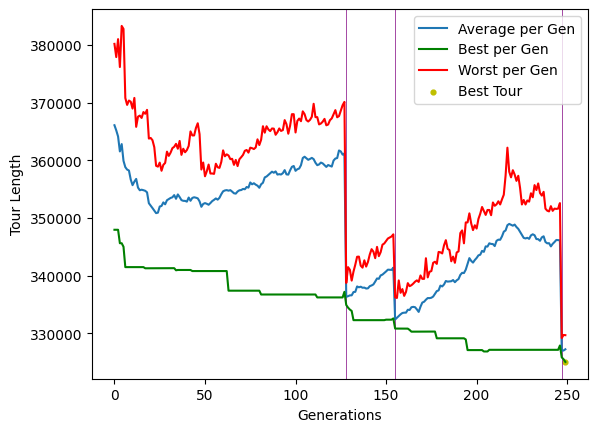

Best Tour Found in generation 249 with length of 325044.35151130334
Completed sub-tour for cluster number 134 --------------------------------------------
Running genetic algorithm on cluster 135 with 253 cities
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 202
16.214592933654785 seconds


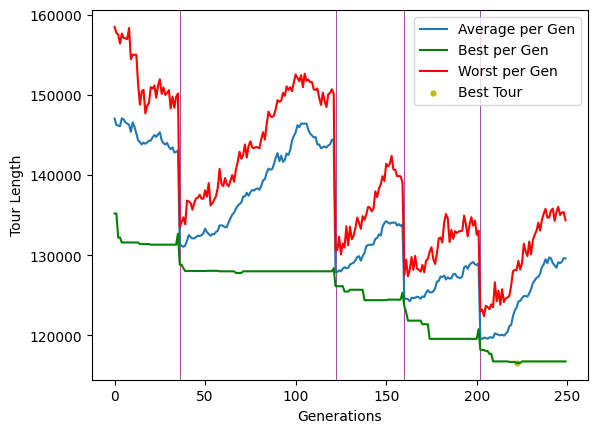

Best Tour Found in generation 222 with length of 116569.10884054654
Completed sub-tour for cluster number 135 --------------------------------------------
Running genetic algorithm on cluster 136 with 154 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 194
9.885586023330688 seconds


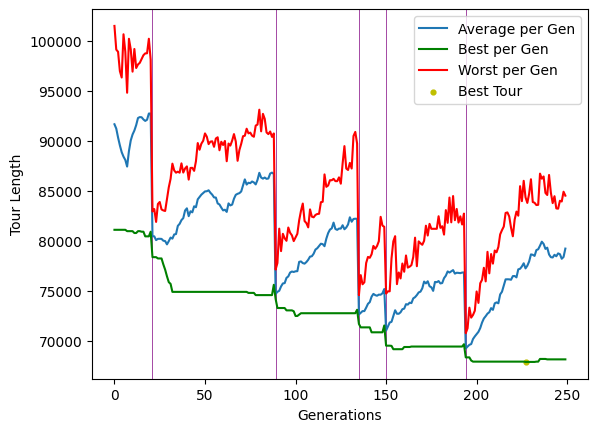

Best Tour Found in generation 227 with length of 67861.41076367542
Completed sub-tour for cluster number 136 --------------------------------------------
Running genetic algorithm on cluster 137 with 768 cities
Reintroduced 75 messiah(s) in generation 2
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 248
51.62140679359436 seconds


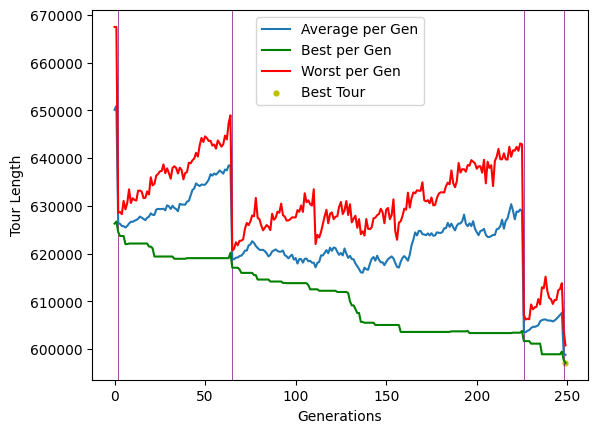

Best Tour Found in generation 249 with length of 597113.0434616617
Completed sub-tour for cluster number 137 --------------------------------------------
Running genetic algorithm on cluster 138 with 749 cities
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 235
50.411365032196045 seconds


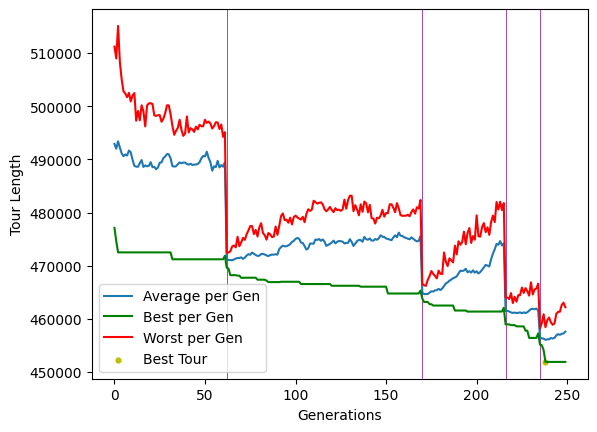

Best Tour Found in generation 238 with length of 451917.0375199787
Completed sub-tour for cluster number 138 --------------------------------------------
Running genetic algorithm on cluster 139 with 446 cities
Reintroduced 75 messiah(s) in generation 11
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 75
Reintroduced 75 messiah(s) in generation 230
29.09888005256653 seconds


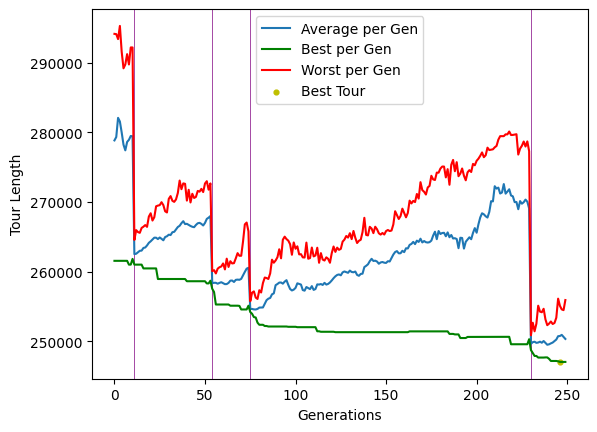

Best Tour Found in generation 246 with length of 247048.2341450102
Completed sub-tour for cluster number 139 --------------------------------------------
Running genetic algorithm on cluster 140 with 199 cities
Reintroduced 75 messiah(s) in generation 48
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 241
12.71935510635376 seconds


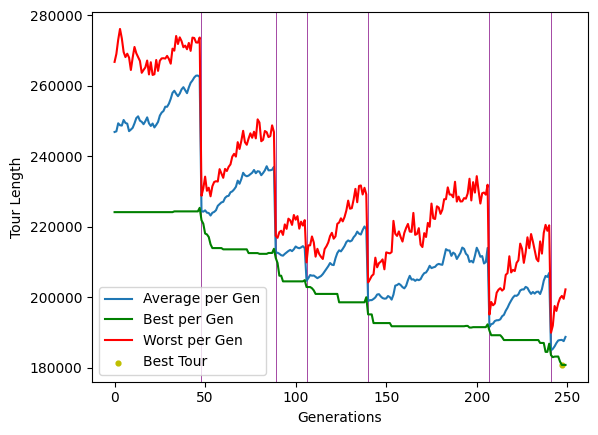

Best Tour Found in generation 247 with length of 180812.01348173566
Completed sub-tour for cluster number 140 --------------------------------------------
Running genetic algorithm on cluster 141 with 340 cities
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 86
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 185
22.057685136795044 seconds


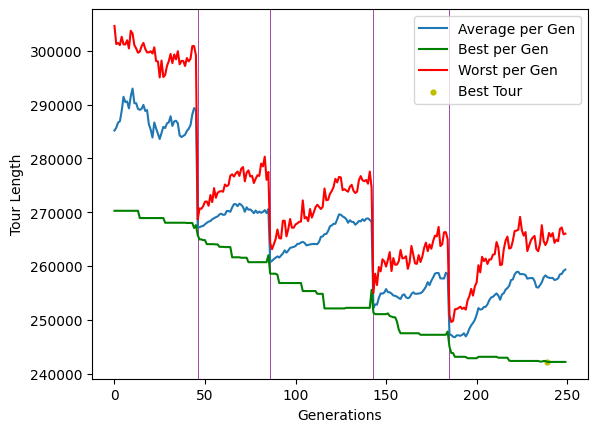

Best Tour Found in generation 239 with length of 242161.83412752743
Completed sub-tour for cluster number 141 --------------------------------------------
Running genetic algorithm on cluster 142 with 311 cities
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 75
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 202
Reintroduced 75 messiah(s) in generation 241
20.05014705657959 seconds


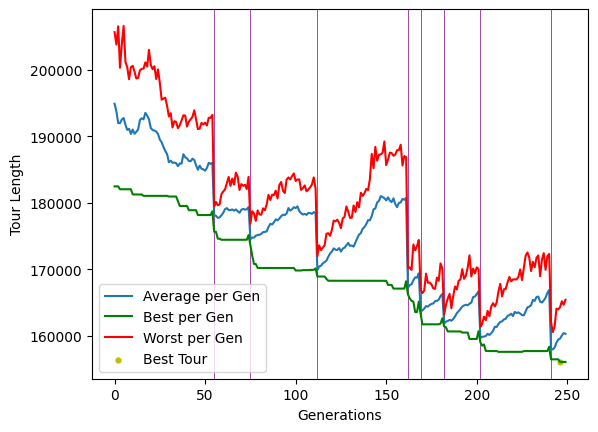

Best Tour Found in generation 246 with length of 156102.649107841
Completed sub-tour for cluster number 142 --------------------------------------------
Running genetic algorithm on cluster 143 with 667 cities
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 221
44.72594475746155 seconds


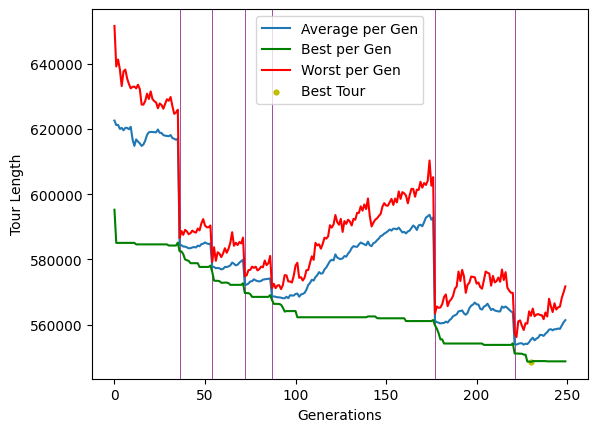

Best Tour Found in generation 230 with length of 548583.8299827887
Completed sub-tour for cluster number 143 --------------------------------------------
Running genetic algorithm on cluster 144 with 285 cities
Reintroduced 75 messiah(s) in generation 51
Reintroduced 75 messiah(s) in generation 59
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 134
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 246
18.36263918876648 seconds


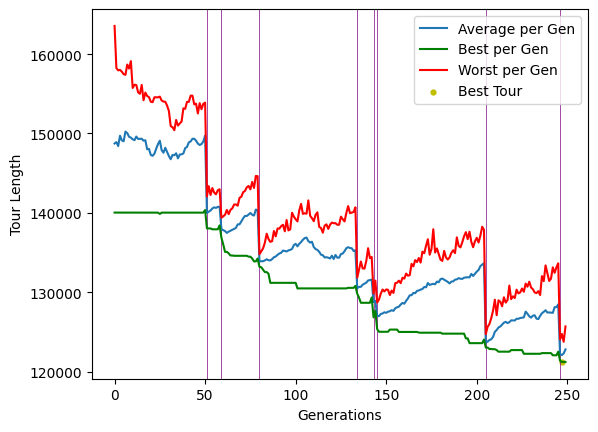

Best Tour Found in generation 247 with length of 121213.07820092214
Completed sub-tour for cluster number 144 --------------------------------------------
Running genetic algorithm on cluster 145 with 293 cities
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 209
18.826639890670776 seconds


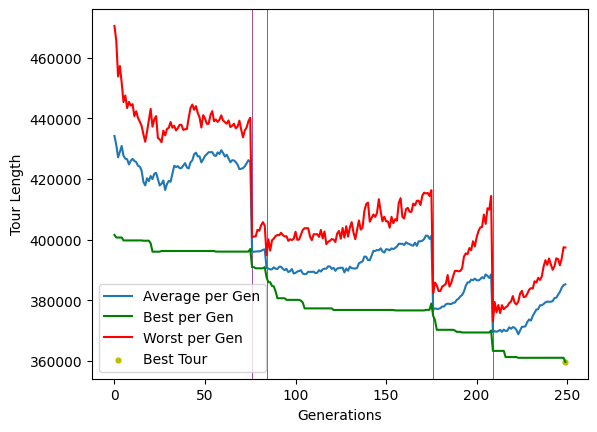

Best Tour Found in generation 249 with length of 359638.1881502784
Completed sub-tour for cluster number 145 --------------------------------------------
Running genetic algorithm on cluster 146 with 170 cities
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 225
Reintroduced 75 messiah(s) in generation 242
10.970223903656006 seconds


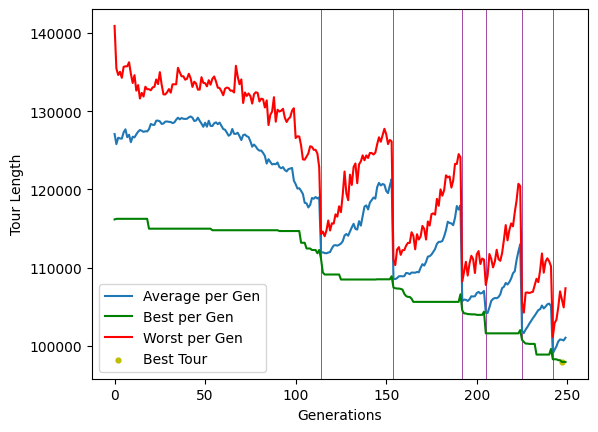

Best Tour Found in generation 247 with length of 97956.4139099688
Completed sub-tour for cluster number 146 --------------------------------------------
Running genetic algorithm on cluster 147 with 249 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 73
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 195
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 219
Reintroduced 75 messiah(s) in generation 234
16.016050100326538 seconds


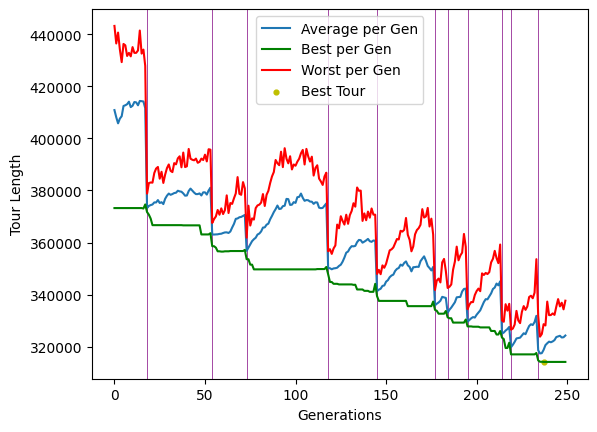

Best Tour Found in generation 237 with length of 314117.255505481
Completed sub-tour for cluster number 147 --------------------------------------------
Running genetic algorithm on cluster 148 with 352 cities
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 191
22.64489984512329 seconds


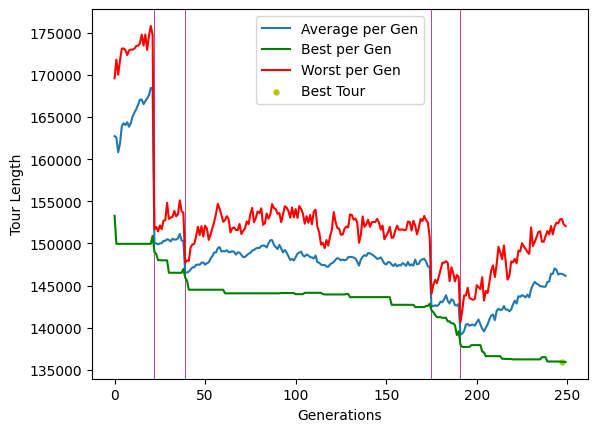

Best Tour Found in generation 247 with length of 135942.1626447702
Completed sub-tour for cluster number 148 --------------------------------------------
Running genetic algorithm on cluster 149 with 316 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 240
20.33701515197754 seconds


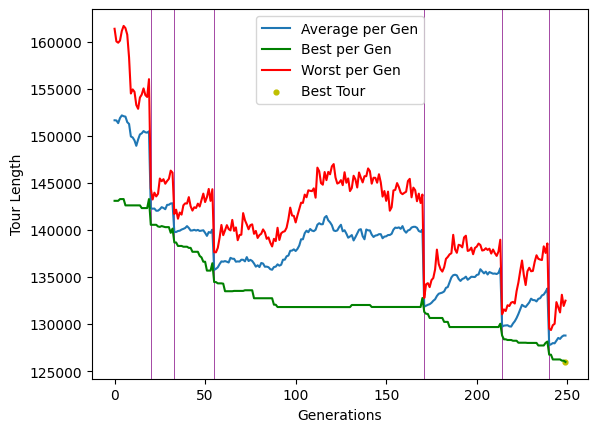

Best Tour Found in generation 249 with length of 125978.83522886854
Completed sub-tour for cluster number 149 --------------------------------------------
Running genetic algorithm on cluster 150 with 306 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 217
Reintroduced 75 messiah(s) in generation 219
Reintroduced 75 messiah(s) in generation 243
19.8420672416687 seconds


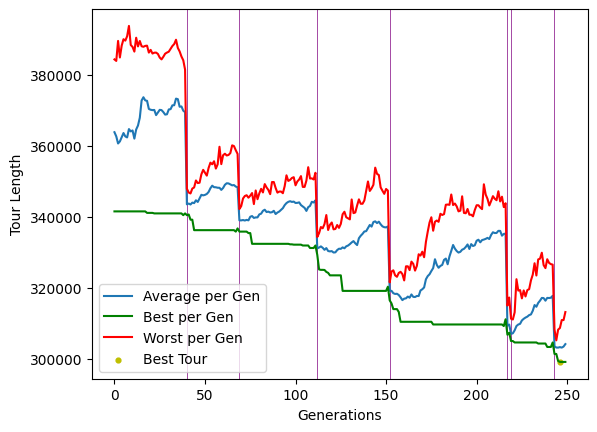

Best Tour Found in generation 246 with length of 299124.587980971
Completed sub-tour for cluster number 150 --------------------------------------------
Running genetic algorithm on cluster 151 with 438 cities
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 218
28.471580266952515 seconds


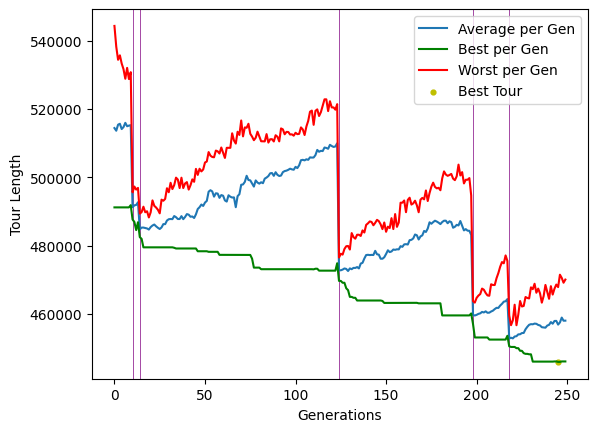

Best Tour Found in generation 245 with length of 446022.9212268203
Completed sub-tour for cluster number 151 --------------------------------------------
Running genetic algorithm on cluster 152 with 444 cities
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 246
28.87011408805847 seconds


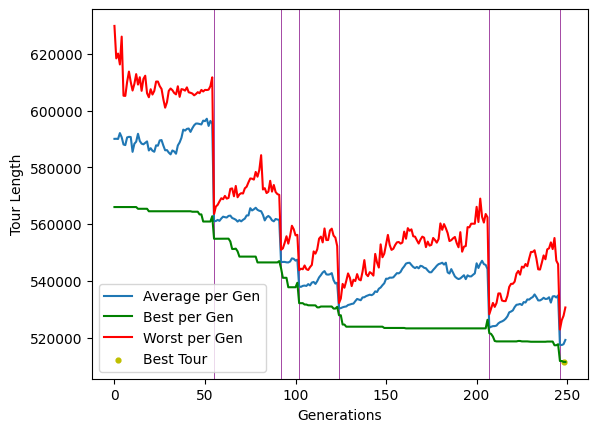

Best Tour Found in generation 248 with length of 511418.67815162154
Completed sub-tour for cluster number 152 --------------------------------------------
Running genetic algorithm on cluster 153 with 168 cities
Reintroduced 75 messiah(s) in generation 6
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 45
Reintroduced 75 messiah(s) in generation 51
Reintroduced 75 messiah(s) in generation 70
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 205
10.793539762496948 seconds


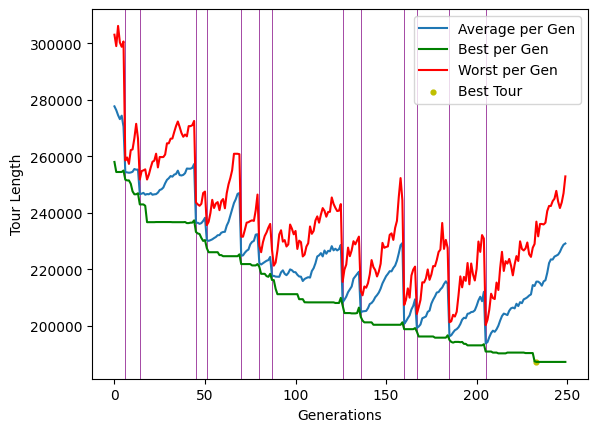

Best Tour Found in generation 233 with length of 187268.827037364
Completed sub-tour for cluster number 153 --------------------------------------------
Running genetic algorithm on cluster 154 with 521 cities
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 200
Reintroduced 75 messiah(s) in generation 244
34.7941632270813 seconds


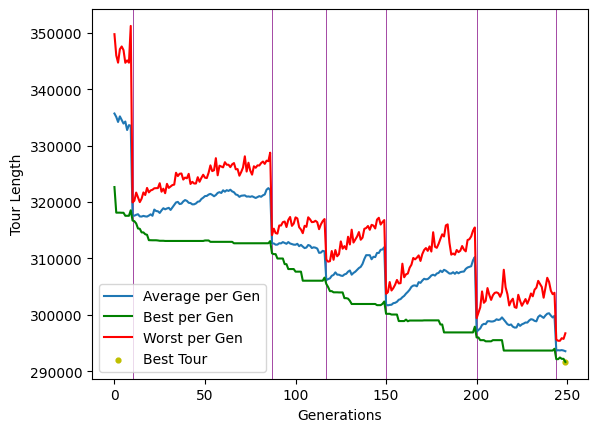

Best Tour Found in generation 249 with length of 291657.0980630433
Completed sub-tour for cluster number 154 --------------------------------------------
Running genetic algorithm on cluster 155 with 314 cities
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 180
Reintroduced 75 messiah(s) in generation 227
20.357183933258057 seconds


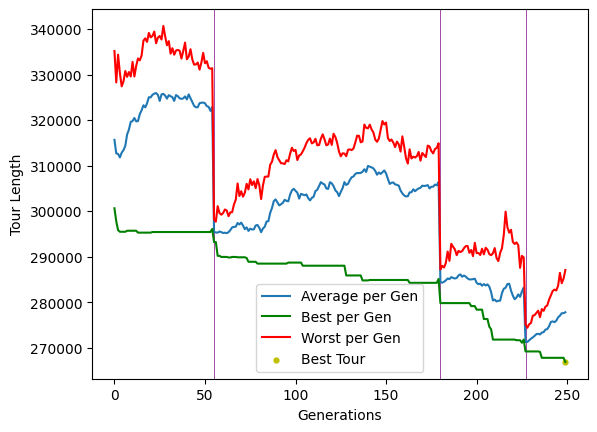

Best Tour Found in generation 249 with length of 266864.6870436727
Completed sub-tour for cluster number 155 --------------------------------------------
Running genetic algorithm on cluster 156 with 207 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 197
13.285271167755127 seconds


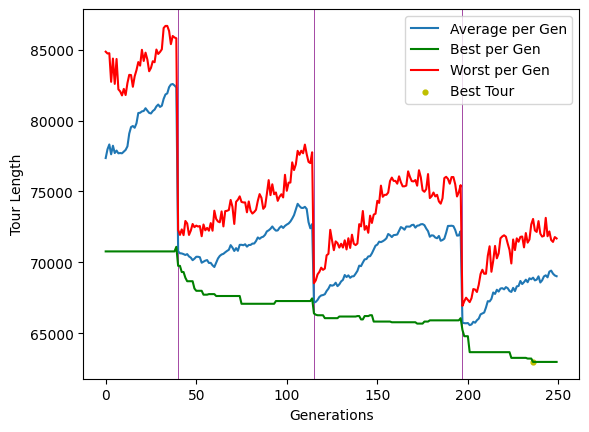

Best Tour Found in generation 236 with length of 62991.56055401865
Completed sub-tour for cluster number 156 --------------------------------------------
Running genetic algorithm on cluster 157 with 488 cities
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 75
Reintroduced 75 messiah(s) in generation 141
Reintroduced 75 messiah(s) in generation 166
31.945496082305908 seconds


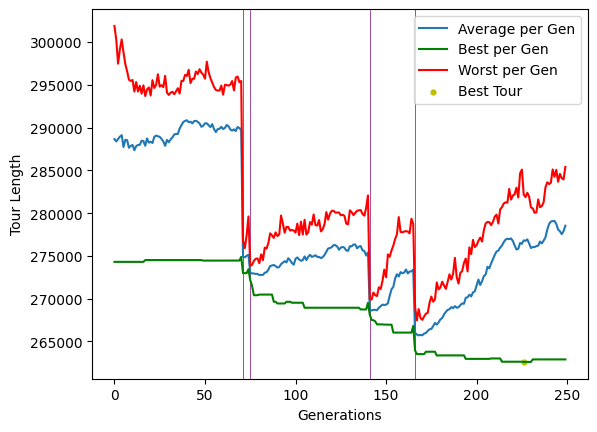

Best Tour Found in generation 226 with length of 262602.73008317756
Completed sub-tour for cluster number 157 --------------------------------------------
Running genetic algorithm on cluster 158 with 401 cities
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 161
Reintroduced 75 messiah(s) in generation 201
Reintroduced 75 messiah(s) in generation 233
25.993488788604736 seconds


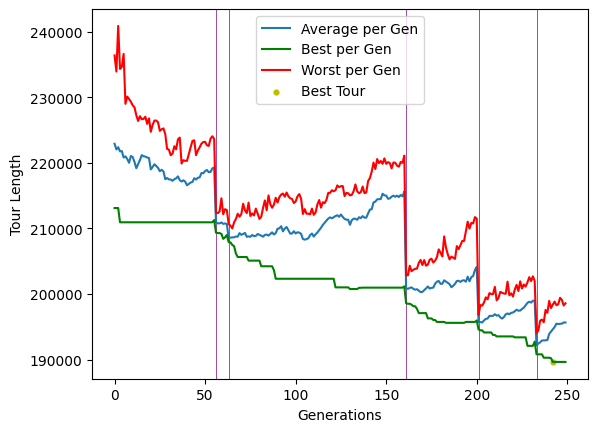

Best Tour Found in generation 242 with length of 189639.6000616774
Completed sub-tour for cluster number 158 --------------------------------------------
Running genetic algorithm on cluster 159 with 419 cities
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 79
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 227
27.25658392906189 seconds


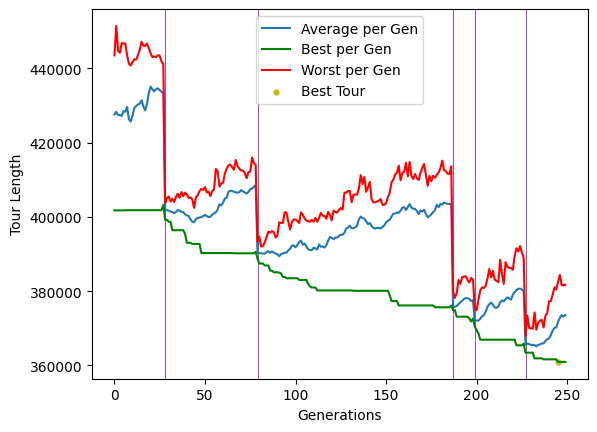

Best Tour Found in generation 245 with length of 360941.3485483424
Completed sub-tour for cluster number 159 --------------------------------------------
Running genetic algorithm on cluster 160 with 308 cities
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 201
Reintroduced 75 messiah(s) in generation 238
20.26975393295288 seconds


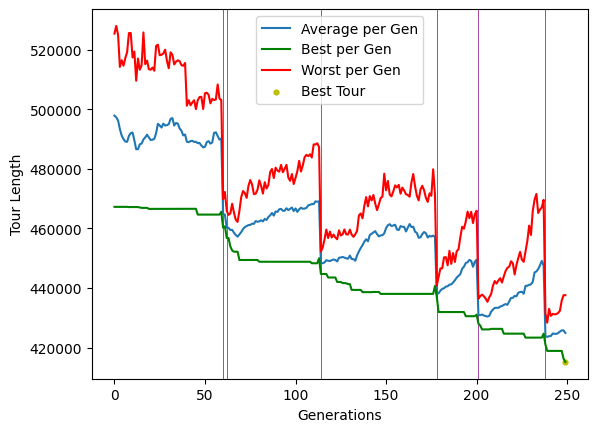

Best Tour Found in generation 249 with length of 415181.26345582685
Completed sub-tour for cluster number 160 --------------------------------------------
Running genetic algorithm on cluster 161 with 501 cities
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 188
33.45382022857666 seconds


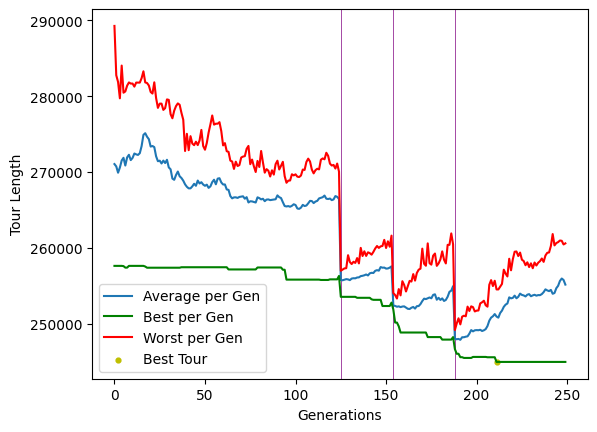

Best Tour Found in generation 211 with length of 244979.10881210736
Completed sub-tour for cluster number 161 --------------------------------------------
Running genetic algorithm on cluster 162 with 282 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 195
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 248
18.178410053253174 seconds


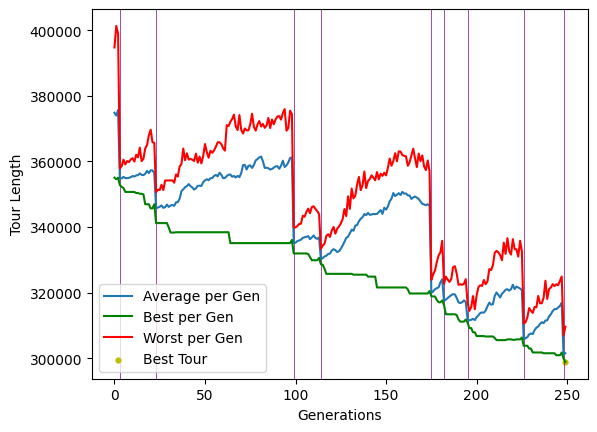

Best Tour Found in generation 249 with length of 298867.4274338642
Completed sub-tour for cluster number 162 --------------------------------------------
Running genetic algorithm on cluster 163 with 333 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 104
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 210
21.545432090759277 seconds


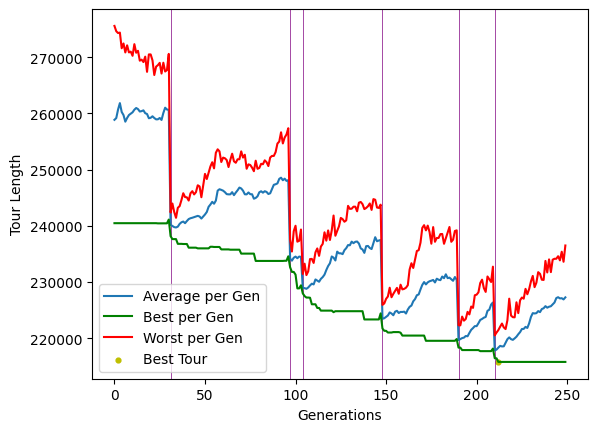

Best Tour Found in generation 212 with length of 215791.57697170053
Completed sub-tour for cluster number 163 --------------------------------------------
Running genetic algorithm on cluster 164 with 193 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 219
12.331167936325073 seconds


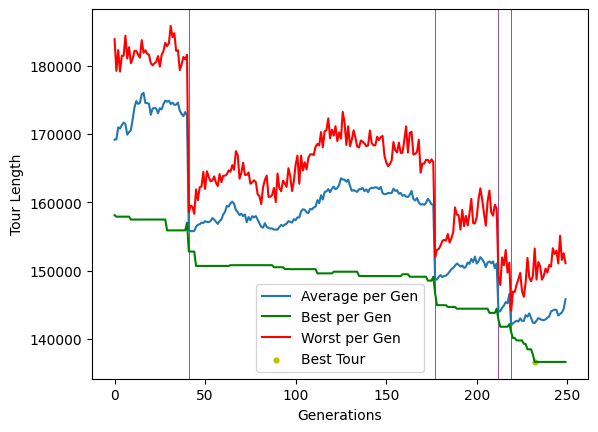

Best Tour Found in generation 232 with length of 136632.15651491127
Completed sub-tour for cluster number 164 --------------------------------------------
Running genetic algorithm on cluster 165 with 176 cities
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 195
Reintroduced 75 messiah(s) in generation 210
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 228
Reintroduced 75 messiah(s) in generation 238
11.387269973754883 seconds


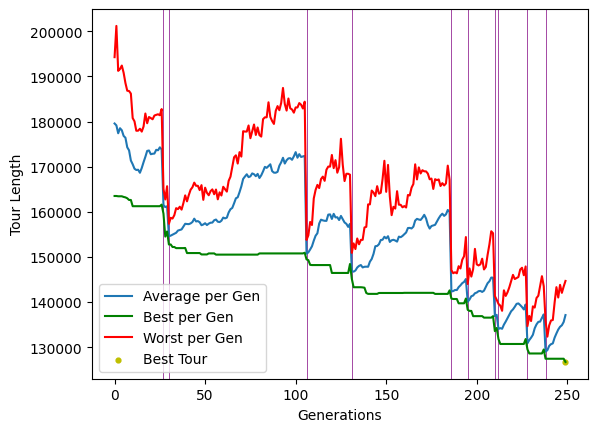

Best Tour Found in generation 249 with length of 126751.28557976538
Completed sub-tour for cluster number 165 --------------------------------------------
Running genetic algorithm on cluster 166 with 501 cities
Reintroduced 75 messiah(s) in generation 9
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 172
Reintroduced 75 messiah(s) in generation 215
33.419347286224365 seconds


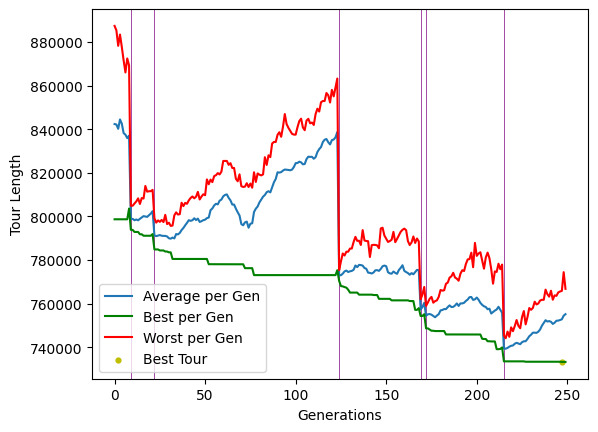

Best Tour Found in generation 247 with length of 733228.8377647261
Completed sub-tour for cluster number 166 --------------------------------------------
Running genetic algorithm on cluster 167 with 422 cities
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 213
27.8328640460968 seconds


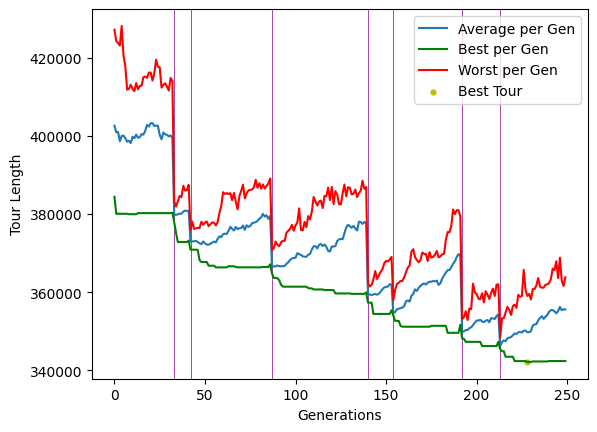

Best Tour Found in generation 228 with length of 342124.5191513943
Completed sub-tour for cluster number 167 --------------------------------------------
Running genetic algorithm on cluster 168 with 256 cities
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 247
16.625308990478516 seconds


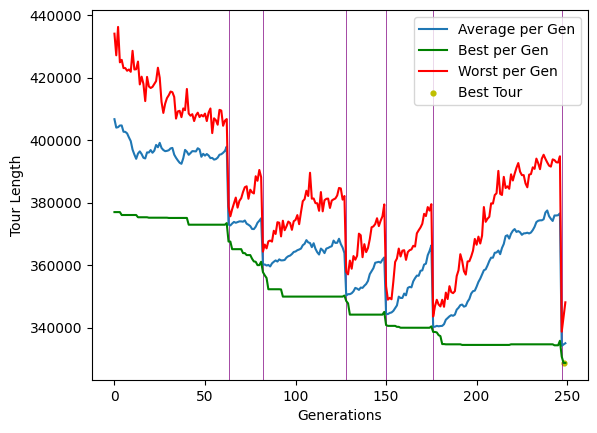

Best Tour Found in generation 248 with length of 328729.92370329064
Completed sub-tour for cluster number 168 --------------------------------------------
Running genetic algorithm on cluster 169 with 185 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 51
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 215
11.961965084075928 seconds


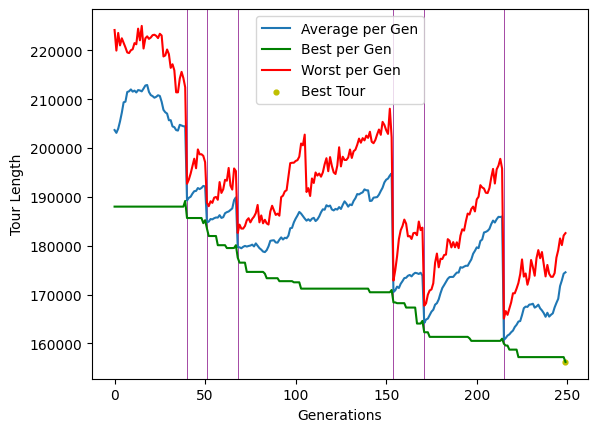

Best Tour Found in generation 249 with length of 156223.33512720306
Completed sub-tour for cluster number 169 --------------------------------------------
Running genetic algorithm on cluster 170 with 411 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 79
Reintroduced 75 messiah(s) in generation 202
Reintroduced 75 messiah(s) in generation 232
Reintroduced 75 messiah(s) in generation 243
26.697850227355957 seconds


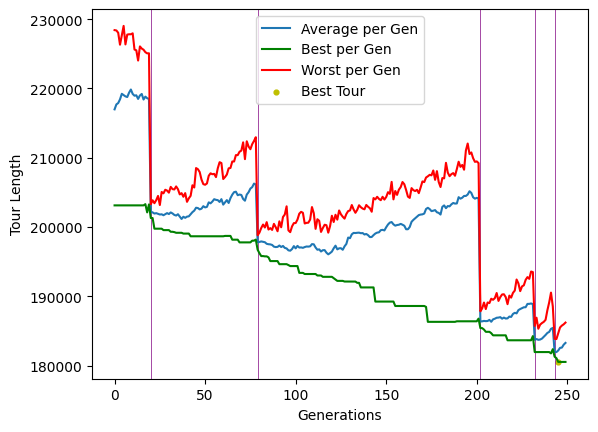

Best Tour Found in generation 245 with length of 180551.1458476434
Completed sub-tour for cluster number 170 --------------------------------------------
Running genetic algorithm on cluster 171 with 213 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 209
13.775256872177124 seconds


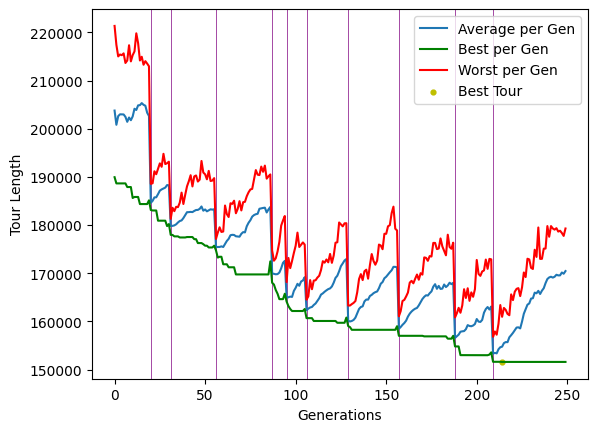

Best Tour Found in generation 214 with length of 151610.19991143642
Completed sub-tour for cluster number 171 --------------------------------------------
Running genetic algorithm on cluster 172 with 382 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 247
25.104509830474854 seconds


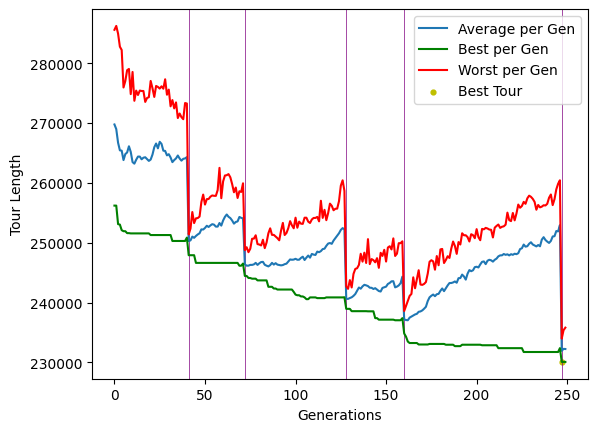

Best Tour Found in generation 247 with length of 230078.78338120866
Completed sub-tour for cluster number 172 --------------------------------------------
Running genetic algorithm on cluster 173 with 555 cities
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 210
37.47288179397583 seconds


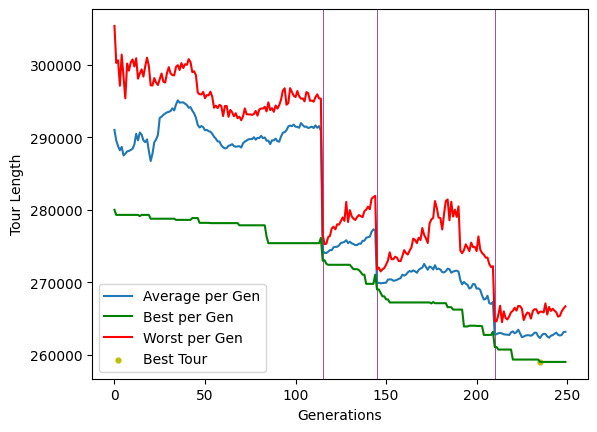

Best Tour Found in generation 235 with length of 259020.23391935258
Completed sub-tour for cluster number 173 --------------------------------------------
Running genetic algorithm on cluster 174 with 571 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 92
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 201
38.614978075027466 seconds


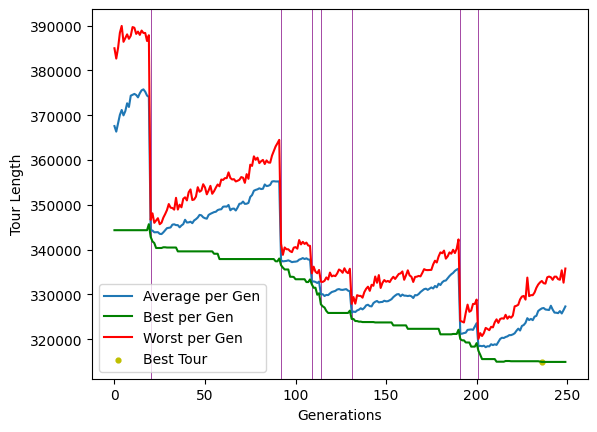

Best Tour Found in generation 236 with length of 314949.5918250933
Completed sub-tour for cluster number 174 --------------------------------------------
Running genetic algorithm on cluster 175 with 324 cities
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 223
Reintroduced 75 messiah(s) in generation 243
21.18457865715027 seconds


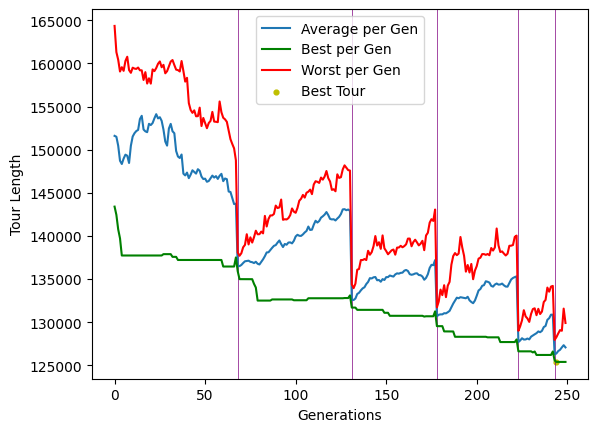

Best Tour Found in generation 244 with length of 125399.41197167189
Completed sub-tour for cluster number 175 --------------------------------------------
Running genetic algorithm on cluster 176 with 346 cities
Reintroduced 75 messiah(s) in generation 98
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 235
22.69188690185547 seconds


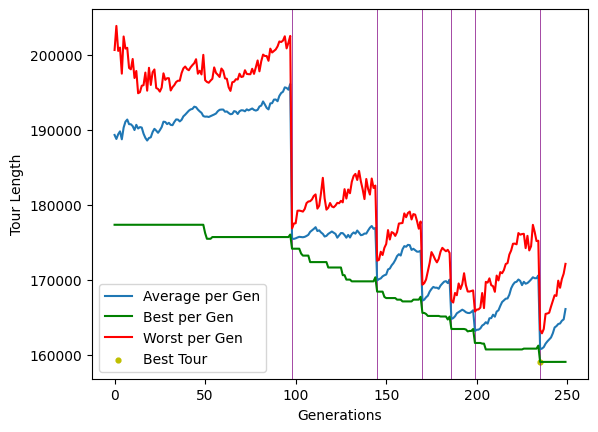

Best Tour Found in generation 235 with length of 159052.29013323403
Completed sub-tour for cluster number 176 --------------------------------------------
Running genetic algorithm on cluster 177 with 270 cities
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 90
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 194
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 218
17.553774118423462 seconds


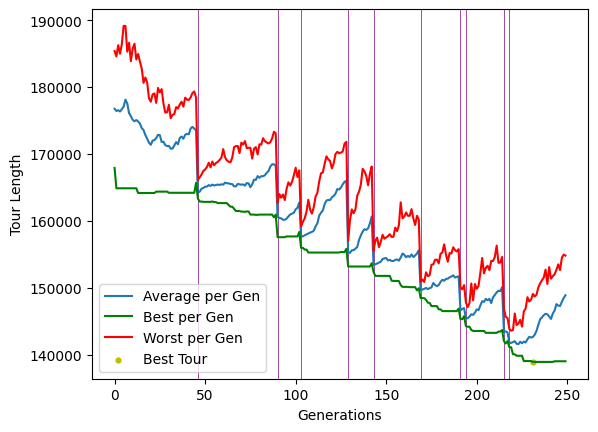

Best Tour Found in generation 231 with length of 138907.9450703386
Completed sub-tour for cluster number 177 --------------------------------------------
Running genetic algorithm on cluster 178 with 614 cities
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 81
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 167
41.4210729598999 seconds


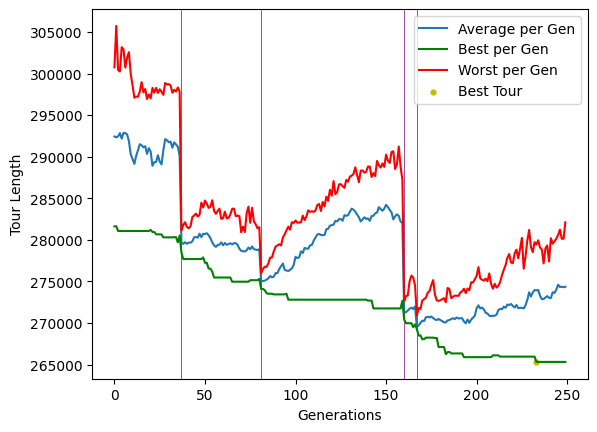

Best Tour Found in generation 233 with length of 265314.4107603229
Completed sub-tour for cluster number 178 --------------------------------------------
Running genetic algorithm on cluster 179 with 279 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 57
Reintroduced 75 messiah(s) in generation 104
Reintroduced 75 messiah(s) in generation 110
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 202
Reintroduced 75 messiah(s) in generation 223
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 235
18.04488778114319 seconds


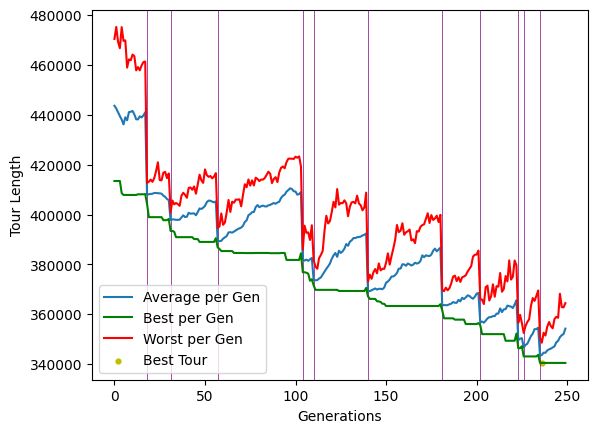

Best Tour Found in generation 236 with length of 340550.2213565645
Completed sub-tour for cluster number 179 --------------------------------------------
Running genetic algorithm on cluster 180 with 631 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 107
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 188
42.53355598449707 seconds


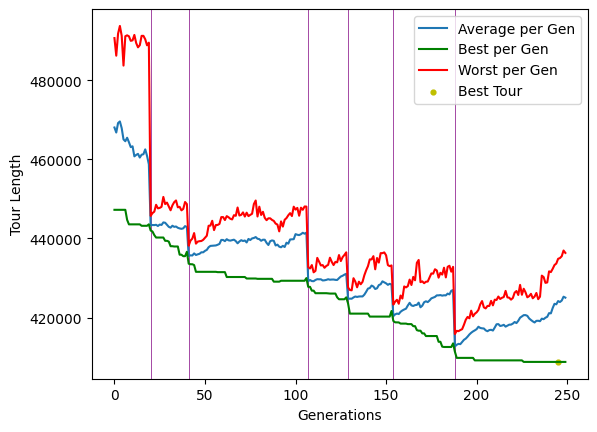

Best Tour Found in generation 245 with length of 408788.761228164
Completed sub-tour for cluster number 180 --------------------------------------------
Running genetic algorithm on cluster 181 with 204 cities
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 248
13.300966262817383 seconds


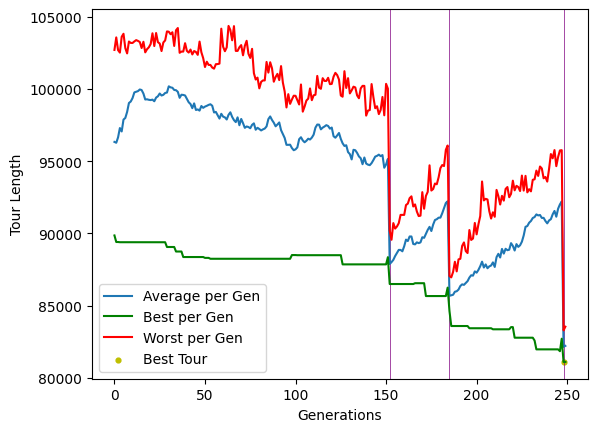

Best Tour Found in generation 248 with length of 81102.7954024434
Completed sub-tour for cluster number 181 --------------------------------------------
Running genetic algorithm on cluster 182 with 224 cities
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 75
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 164
Reintroduced 75 messiah(s) in generation 184
Reintroduced 75 messiah(s) in generation 204
Reintroduced 75 messiah(s) in generation 249
14.704606771469116 seconds


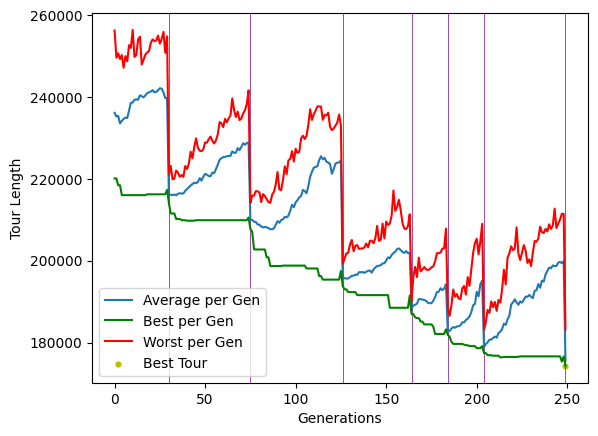

Best Tour Found in generation 249 with length of 174275.9089399636
Completed sub-tour for cluster number 182 --------------------------------------------
Running genetic algorithm on cluster 183 with 262 cities
Reintroduced 75 messiah(s) in generation 47
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 101
17.124632835388184 seconds


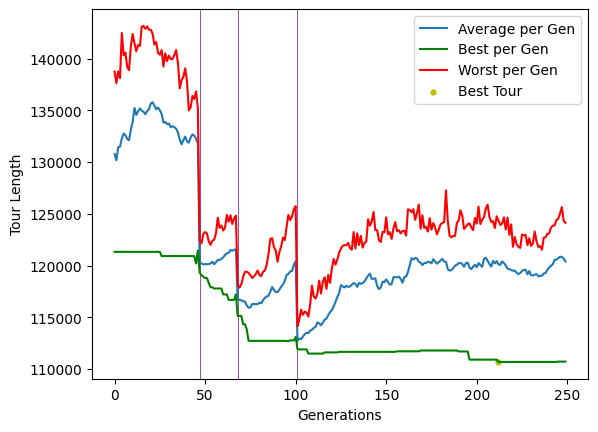

Best Tour Found in generation 212 with length of 110684.01105577732
Completed sub-tour for cluster number 183 --------------------------------------------
Running genetic algorithm on cluster 184 with 330 cities
Reintroduced 75 messiah(s) in generation 2
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 151
Reintroduced 75 messiah(s) in generation 156
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 209
Reintroduced 75 messiah(s) in generation 248
21.66284680366516 seconds


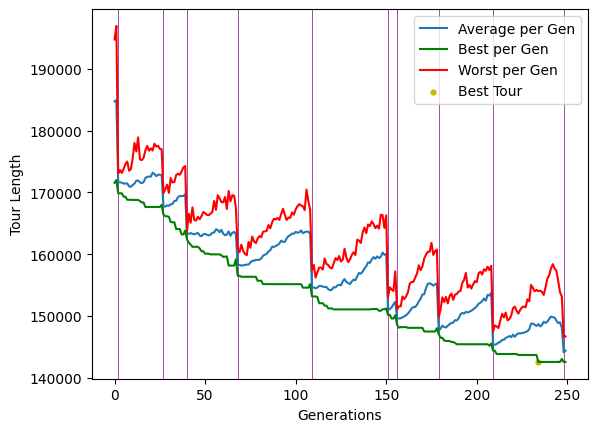

Best Tour Found in generation 234 with length of 142547.9213149249
Completed sub-tour for cluster number 184 --------------------------------------------
Running genetic algorithm on cluster 185 with 309 cities
Reintroduced 75 messiah(s) in generation 47
Reintroduced 75 messiah(s) in generation 77
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 172
Reintroduced 75 messiah(s) in generation 227
20.12035822868347 seconds


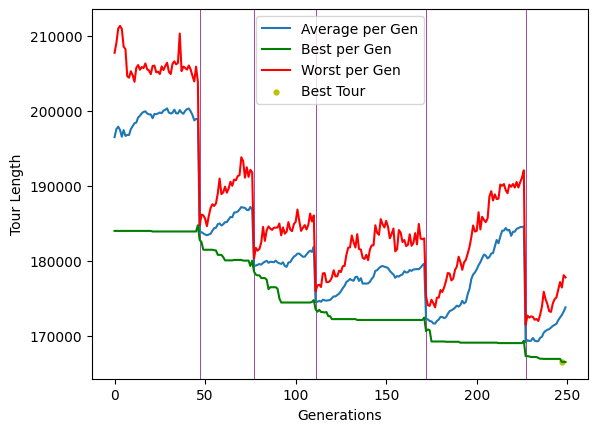

Best Tour Found in generation 247 with length of 166486.19674509997
Completed sub-tour for cluster number 185 --------------------------------------------
Running genetic algorithm on cluster 186 with 759 cities
Reintroduced 75 messiah(s) in generation 79
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 205
52.206981897354126 seconds


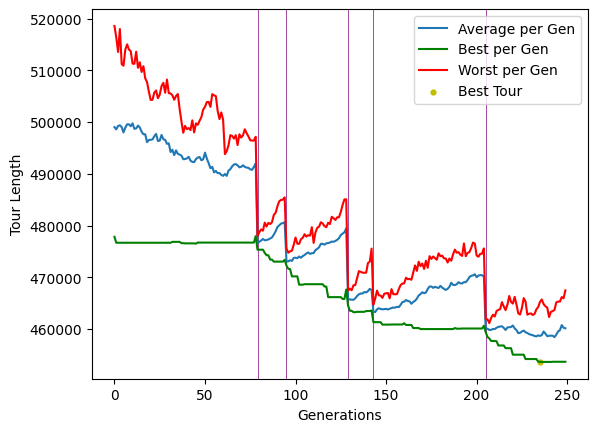

Best Tour Found in generation 235 with length of 453662.23767524096
Completed sub-tour for cluster number 186 --------------------------------------------
Running genetic algorithm on cluster 187 with 364 cities
Reintroduced 75 messiah(s) in generation 12
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 225
23.822936058044434 seconds


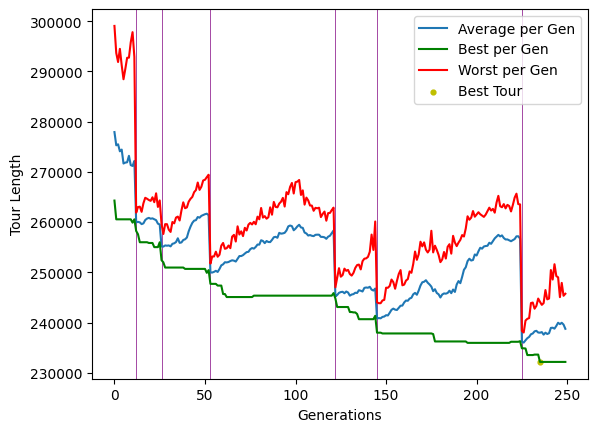

Best Tour Found in generation 235 with length of 232171.0747099075
Completed sub-tour for cluster number 187 --------------------------------------------
Running genetic algorithm on cluster 188 with 244 cities
Reintroduced 75 messiah(s) in generation 161
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 239
16.1507351398468 seconds


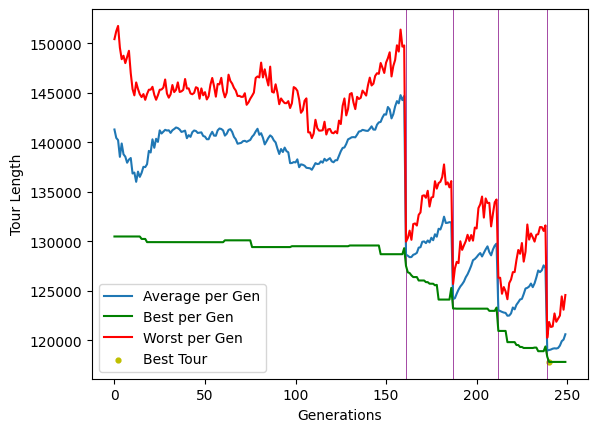

Best Tour Found in generation 240 with length of 117837.11479656278
Completed sub-tour for cluster number 188 --------------------------------------------
Running genetic algorithm on cluster 189 with 213 cities
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 185
13.841617345809937 seconds


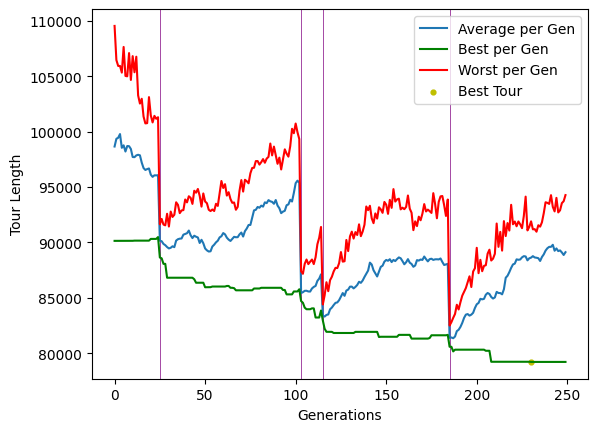

Best Tour Found in generation 230 with length of 79219.75901740388
Completed sub-tour for cluster number 189 --------------------------------------------
Running genetic algorithm on cluster 190 with 1024 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 150
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 232
70.33738303184509 seconds


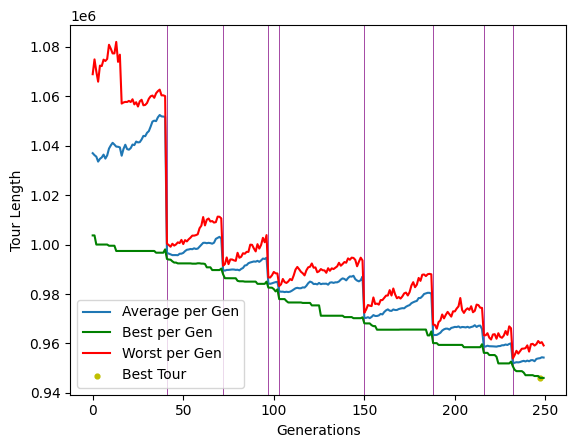

Best Tour Found in generation 247 with length of 946035.3541050402
Completed sub-tour for cluster number 190 --------------------------------------------
Running genetic algorithm on cluster 191 with 472 cities
Reintroduced 75 messiah(s) in generation 6
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 49
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 224
30.7798490524292 seconds


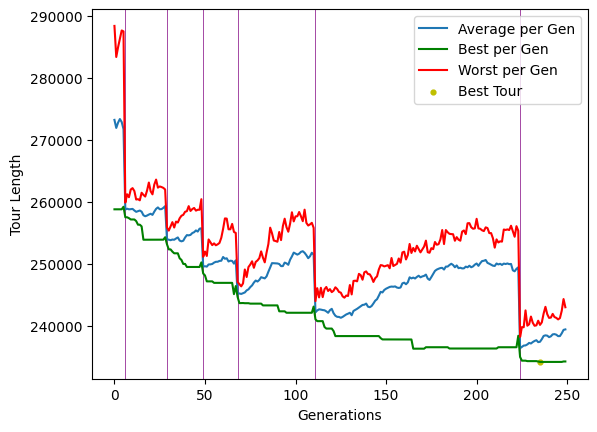

Best Tour Found in generation 235 with length of 234126.95833274696
Completed sub-tour for cluster number 191 --------------------------------------------
Running genetic algorithm on cluster 192 with 156 cities
Reintroduced 75 messiah(s) in generation 35
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 230
10.028964281082153 seconds


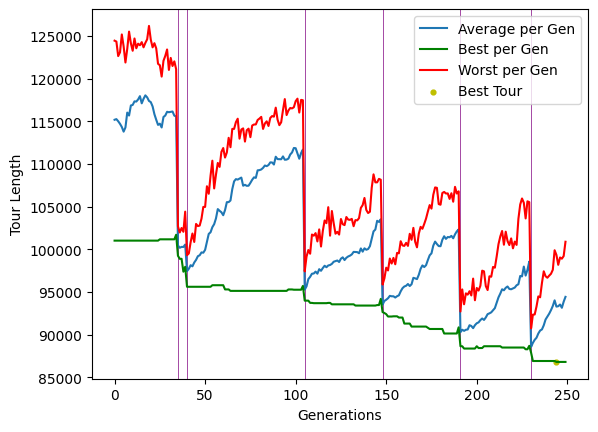

Best Tour Found in generation 244 with length of 86790.87484292005
Completed sub-tour for cluster number 192 --------------------------------------------
Running genetic algorithm on cluster 193 with 273 cities
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 93
Reintroduced 75 messiah(s) in generation 137
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 227
17.62530207633972 seconds


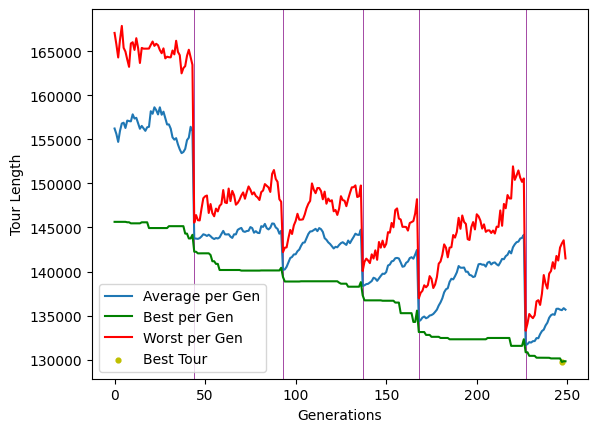

Best Tour Found in generation 247 with length of 129746.9206768102
Completed sub-tour for cluster number 193 --------------------------------------------
Running genetic algorithm on cluster 194 with 511 cities
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 220
Reintroduced 75 messiah(s) in generation 229
34.31043720245361 seconds


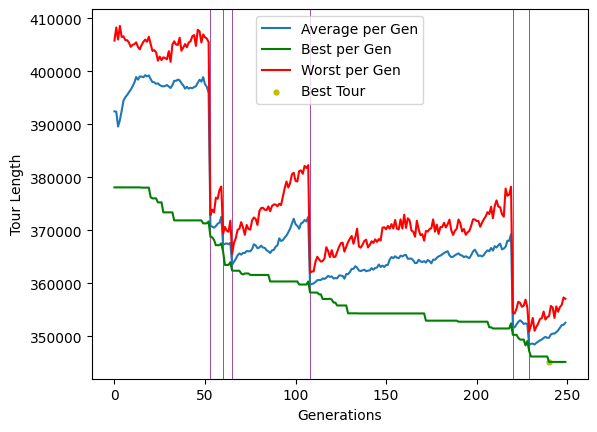

Best Tour Found in generation 240 with length of 345204.2953008356
Completed sub-tour for cluster number 194 --------------------------------------------
Running genetic algorithm on cluster 195 with 311 cities
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 220
20.158819913864136 seconds


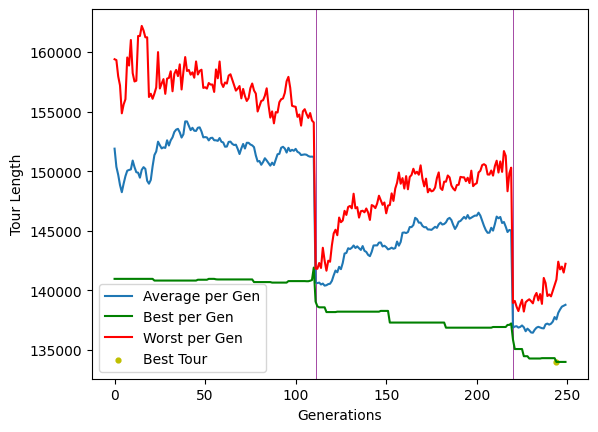

Best Tour Found in generation 244 with length of 133999.94229164356
Completed sub-tour for cluster number 195 --------------------------------------------
Running genetic algorithm on cluster 196 with 195 cities
Reintroduced 75 messiah(s) in generation 11
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 222
12.500975131988525 seconds


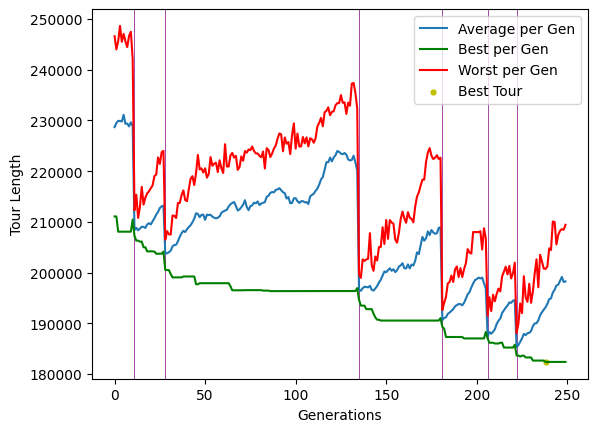

Best Tour Found in generation 238 with length of 182394.415853893
Completed sub-tour for cluster number 196 --------------------------------------------
Running genetic algorithm on cluster 197 with 295 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 57
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 192
19.22837495803833 seconds


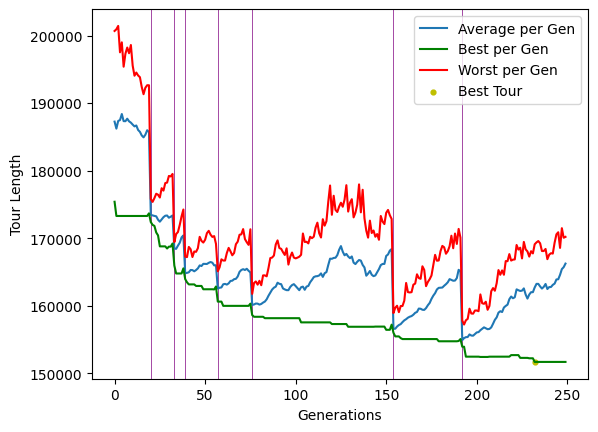

Best Tour Found in generation 232 with length of 151673.4460792992
Completed sub-tour for cluster number 197 --------------------------------------------
Running genetic algorithm on cluster 198 with 486 cities
Reintroduced 75 messiah(s) in generation 32
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 194
31.817451000213623 seconds


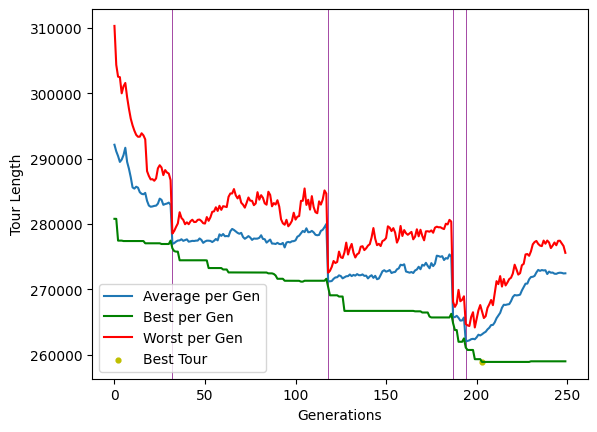

Best Tour Found in generation 203 with length of 258878.86705399703
Completed sub-tour for cluster number 198 --------------------------------------------
Running genetic algorithm on cluster 199 with 168 cities
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 237
10.929035902023315 seconds


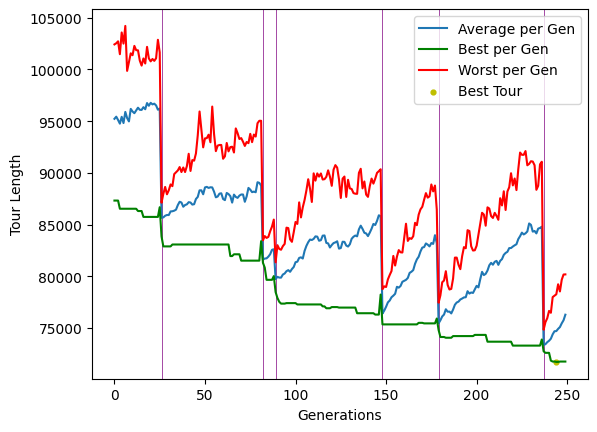

Best Tour Found in generation 244 with length of 71714.00463216532
Completed sub-tour for cluster number 199 --------------------------------------------
Running genetic algorithm on cluster 200 with 416 cities
Reintroduced 75 messiah(s) in generation 4
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 176
27.184996128082275 seconds


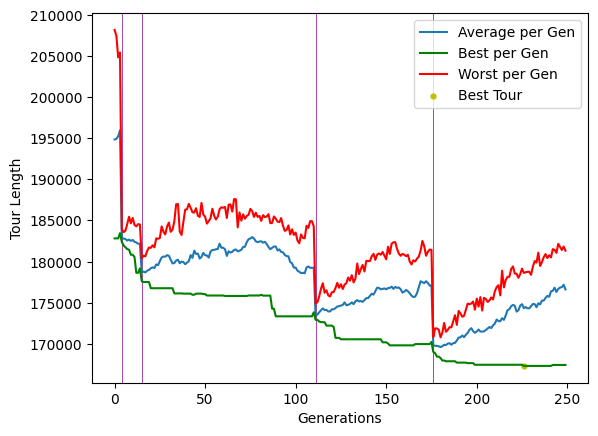

Best Tour Found in generation 226 with length of 167300.1004499712
Completed sub-tour for cluster number 200 --------------------------------------------
Running genetic algorithm on cluster 201 with 154 cities
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 208
Reintroduced 75 messiah(s) in generation 237
9.936639070510864 seconds


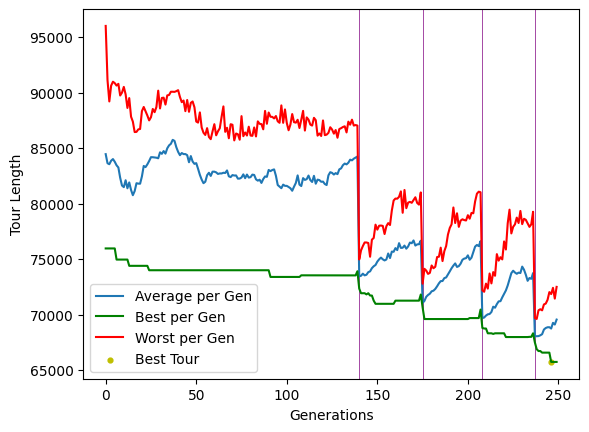

Best Tour Found in generation 246 with length of 65733.37696159953
Completed sub-tour for cluster number 201 --------------------------------------------
Running genetic algorithm on cluster 202 with 246 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 247
15.836757183074951 seconds


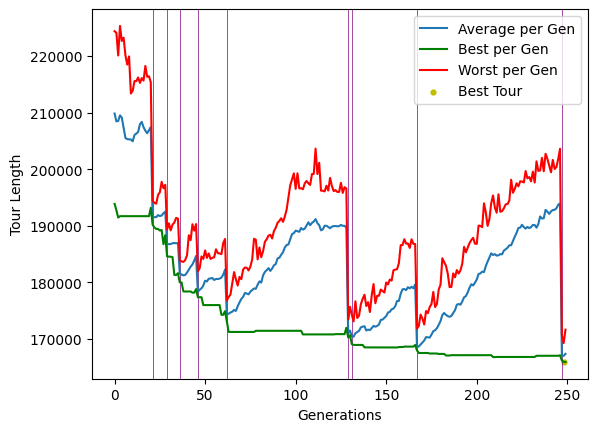

Best Tour Found in generation 248 with length of 165944.013070174
Completed sub-tour for cluster number 202 --------------------------------------------
Running genetic algorithm on cluster 203 with 285 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 113
Reintroduced 75 messiah(s) in generation 226
18.302890062332153 seconds


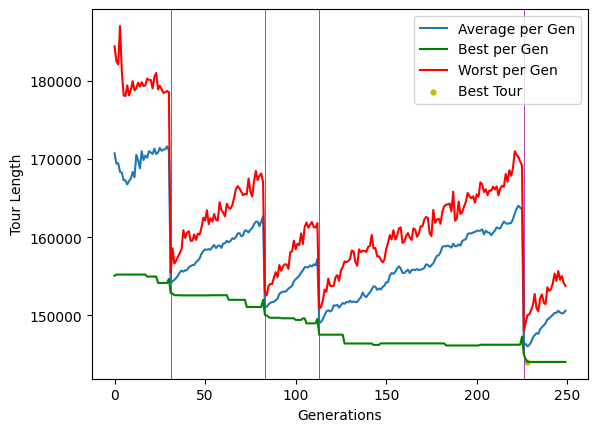

Best Tour Found in generation 228 with length of 144029.58181175165
Completed sub-tour for cluster number 203 --------------------------------------------
Running genetic algorithm on cluster 204 with 286 cities
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 139
Reintroduced 75 messiah(s) in generation 142
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 204
Reintroduced 75 messiah(s) in generation 217
18.28386402130127 seconds


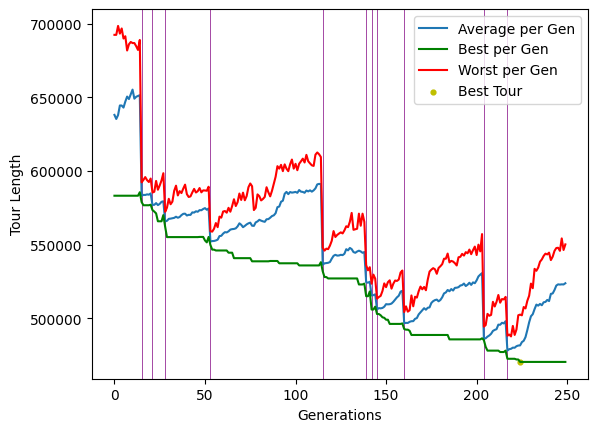

Best Tour Found in generation 224 with length of 470401.6787912403
Completed sub-tour for cluster number 204 --------------------------------------------
Running genetic algorithm on cluster 205 with 248 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 214
15.801660776138306 seconds


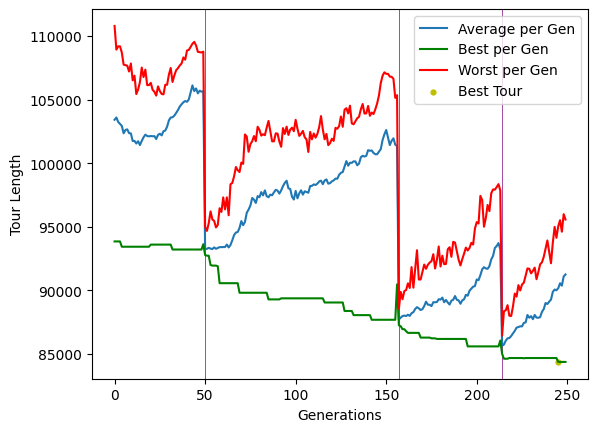

Best Tour Found in generation 245 with length of 84379.84027566279
Completed sub-tour for cluster number 205 --------------------------------------------
Running genetic algorithm on cluster 206 with 481 cities
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 217
31.33433699607849 seconds


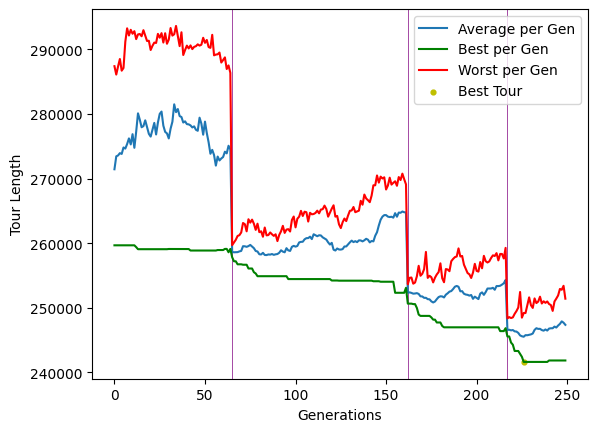

Best Tour Found in generation 226 with length of 241632.49622344912
Completed sub-tour for cluster number 206 --------------------------------------------
Running genetic algorithm on cluster 207 with 667 cities
Reintroduced 75 messiah(s) in generation 26
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 119
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 248
45.027961015701294 seconds


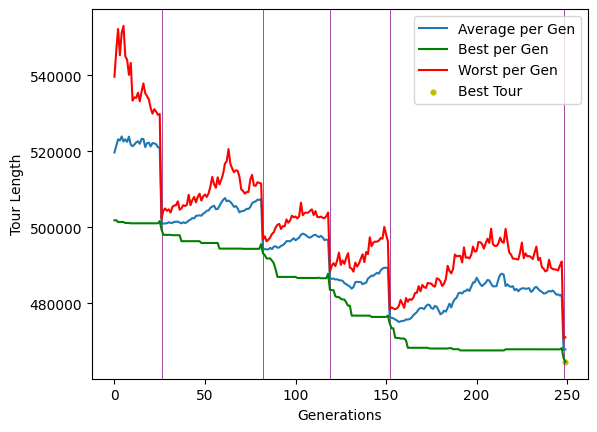

Best Tour Found in generation 249 with length of 464603.32421584276
Completed sub-tour for cluster number 207 --------------------------------------------
Running genetic algorithm on cluster 208 with 203 cities
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 73
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 211
Reintroduced 75 messiah(s) in generation 228
12.95954704284668 seconds


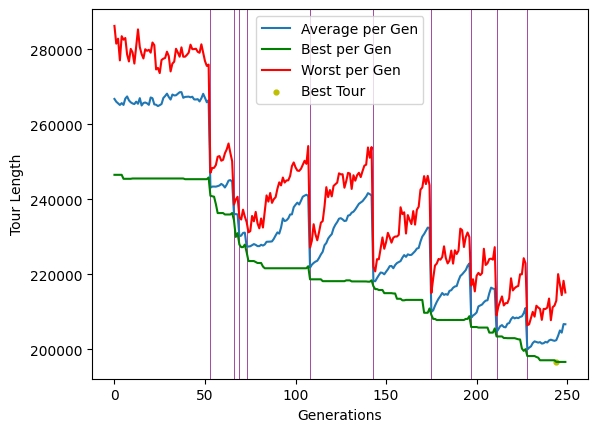

Best Tour Found in generation 244 with length of 196603.39770608378
Completed sub-tour for cluster number 208 --------------------------------------------
Running genetic algorithm on cluster 209 with 332 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 81
Reintroduced 75 messiah(s) in generation 101
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 240
21.41257929801941 seconds


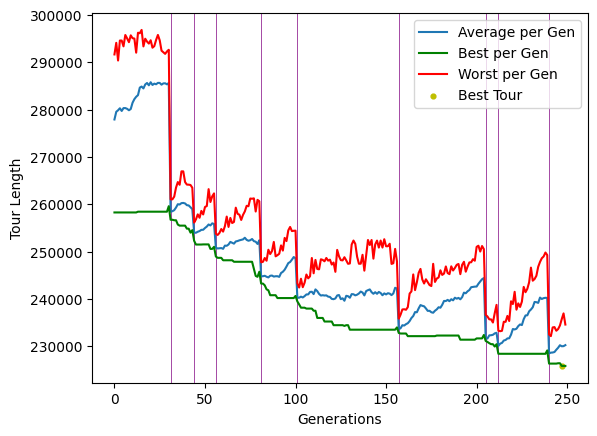

Best Tour Found in generation 247 with length of 225872.55127893694
Completed sub-tour for cluster number 209 --------------------------------------------
Running genetic algorithm on cluster 210 with 250 cities
Reintroduced 75 messiah(s) in generation 61
Reintroduced 75 messiah(s) in generation 115
Reintroduced 75 messiah(s) in generation 138
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 207
16.103246212005615 seconds


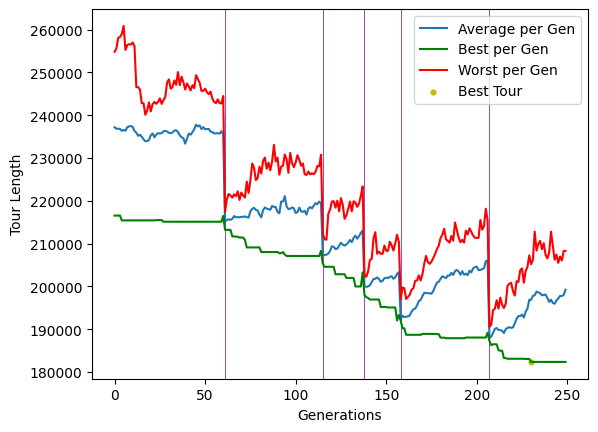

Best Tour Found in generation 230 with length of 182374.46530951248
Completed sub-tour for cluster number 210 --------------------------------------------
Running genetic algorithm on cluster 211 with 363 cities
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 46
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 212
24.141145706176758 seconds


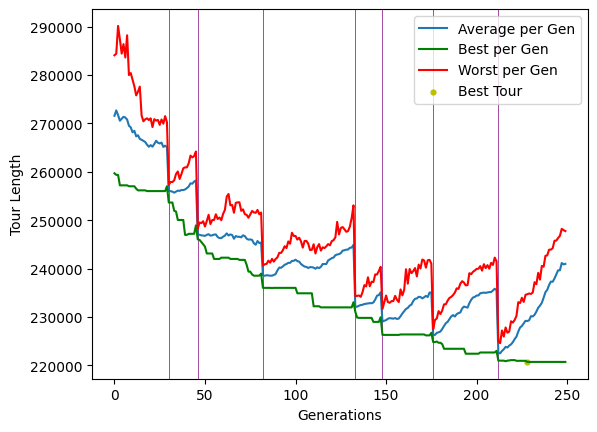

Best Tour Found in generation 228 with length of 220735.81258018163
Completed sub-tour for cluster number 211 --------------------------------------------
Running genetic algorithm on cluster 212 with 284 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 35
Reintroduced 75 messiah(s) in generation 227
18.305102109909058 seconds


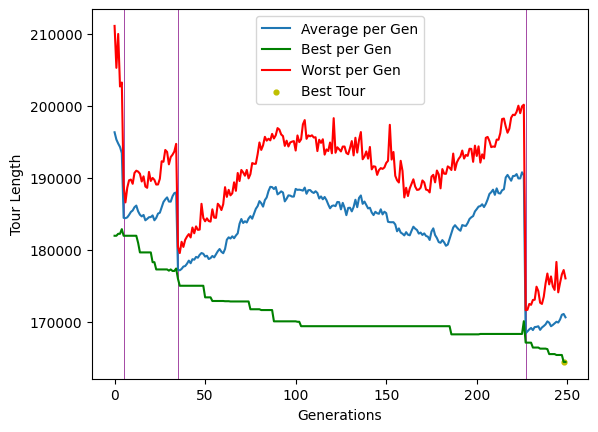

Best Tour Found in generation 248 with length of 164469.4315367028
Completed sub-tour for cluster number 212 --------------------------------------------
Running genetic algorithm on cluster 213 with 408 cities
Reintroduced 75 messiah(s) in generation 78
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 221
26.820471048355103 seconds


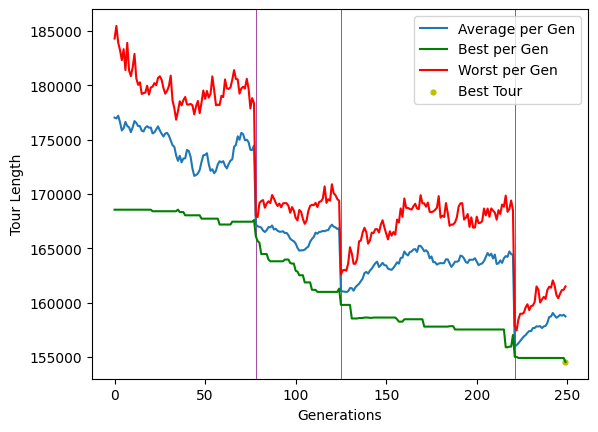

Best Tour Found in generation 249 with length of 154554.7217367139
Completed sub-tour for cluster number 213 --------------------------------------------
Running genetic algorithm on cluster 214 with 882 cities
Reintroduced 75 messiah(s) in generation 6
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 205
Reintroduced 75 messiah(s) in generation 218
Reintroduced 75 messiah(s) in generation 242
Reintroduced 75 messiah(s) in generation 248
59.86684489250183 seconds


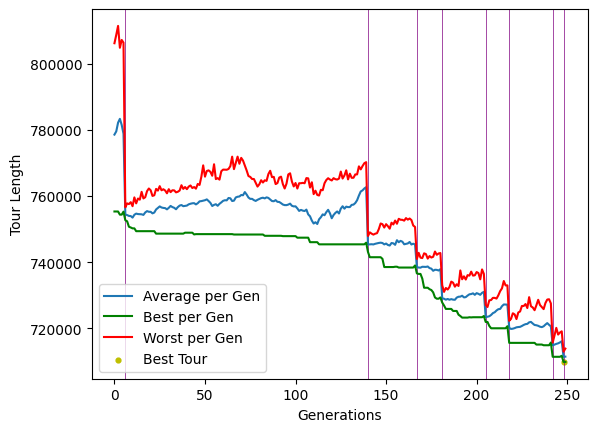

Best Tour Found in generation 248 with length of 709771.2391074697
Completed sub-tour for cluster number 214 --------------------------------------------
Running genetic algorithm on cluster 215 with 392 cities
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 34
Reintroduced 75 messiah(s) in generation 123
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 239
Reintroduced 75 messiah(s) in generation 248
25.627201080322266 seconds


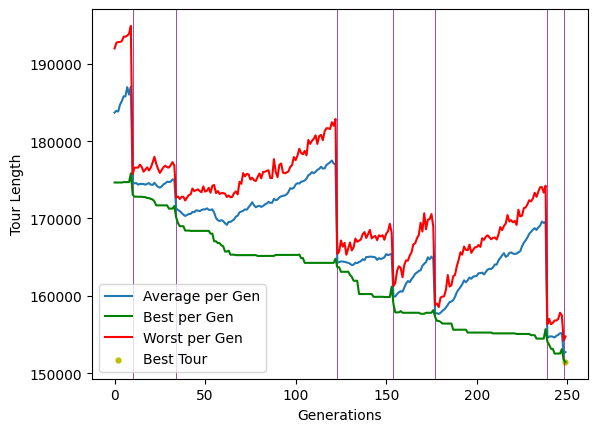

Best Tour Found in generation 249 with length of 151449.41680441264
Completed sub-tour for cluster number 215 --------------------------------------------
Running genetic algorithm on cluster 216 with 443 cities
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 110
Reintroduced 75 messiah(s) in generation 182
29.13568425178528 seconds


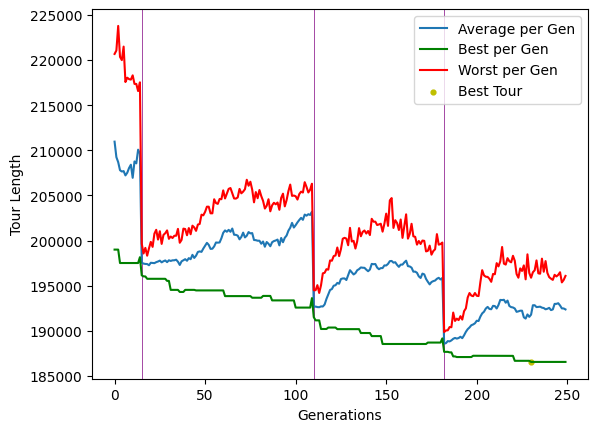

Best Tour Found in generation 230 with length of 186566.78554496914
Completed sub-tour for cluster number 216 --------------------------------------------
Running genetic algorithm on cluster 217 with 138 cities
Reintroduced 75 messiah(s) in generation 6
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 124
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 248
9.103730201721191 seconds


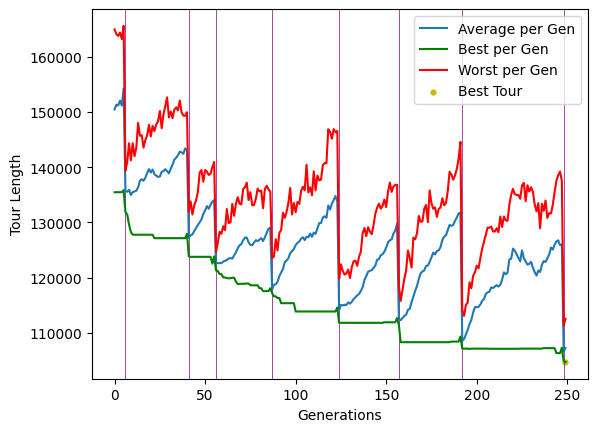

Best Tour Found in generation 249 with length of 104716.54151359036
Completed sub-tour for cluster number 217 --------------------------------------------
Running genetic algorithm on cluster 218 with 215 cities
Reintroduced 75 messiah(s) in generation 88
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 234
13.813779830932617 seconds


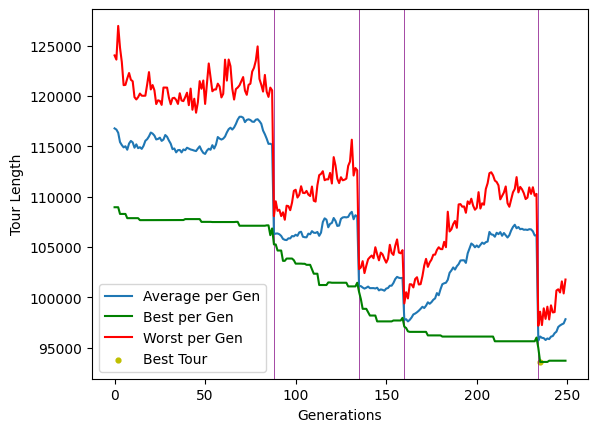

Best Tour Found in generation 235 with length of 93588.73539465535
Completed sub-tour for cluster number 218 --------------------------------------------
Running genetic algorithm on cluster 219 with 757 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 220
51.42436194419861 seconds


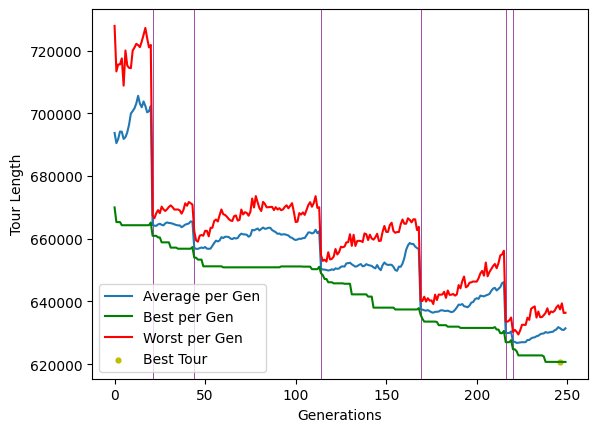

Best Tour Found in generation 246 with length of 620712.7927428822
Completed sub-tour for cluster number 219 --------------------------------------------
Running genetic algorithm on cluster 220 with 341 cities
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 112
22.21554207801819 seconds


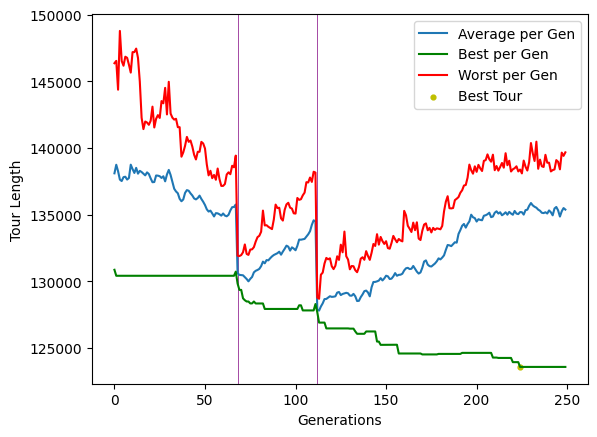

Best Tour Found in generation 224 with length of 123577.32152903151
Completed sub-tour for cluster number 220 --------------------------------------------
Running genetic algorithm on cluster 221 with 588 cities
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 146
Reintroduced 75 messiah(s) in generation 157
Reintroduced 75 messiah(s) in generation 241
40.06228685379028 seconds


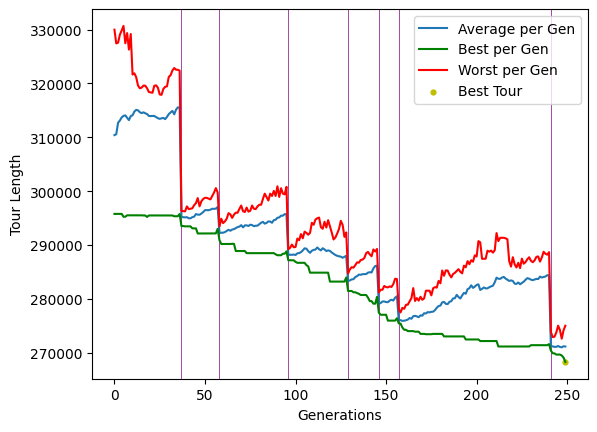

Best Tour Found in generation 249 with length of 268298.36262746685
Completed sub-tour for cluster number 221 --------------------------------------------
Running genetic algorithm on cluster 222 with 234 cities
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 233
15.083257913589478 seconds


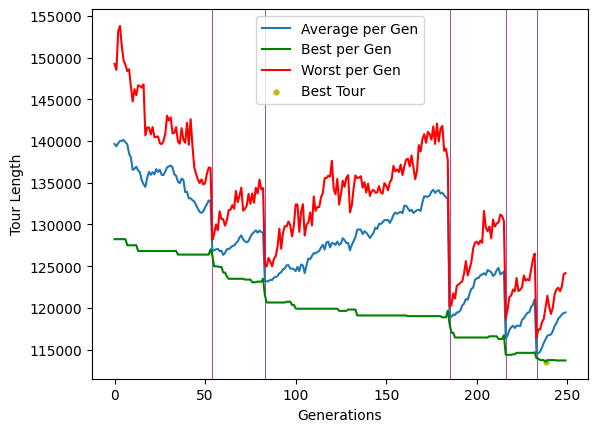

Best Tour Found in generation 238 with length of 113515.43386311187
Completed sub-tour for cluster number 222 --------------------------------------------
Running genetic algorithm on cluster 223 with 374 cities
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 231
24.35415816307068 seconds


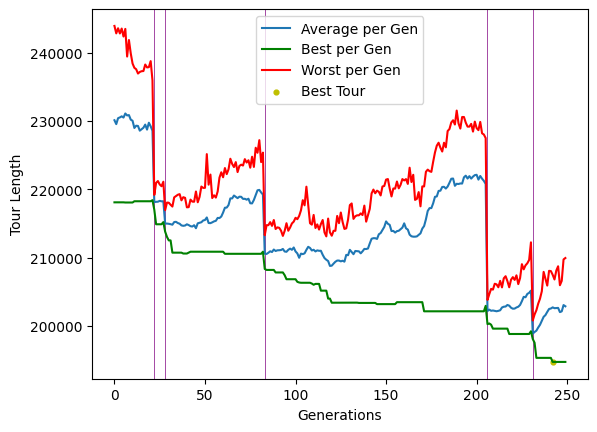

Best Tour Found in generation 242 with length of 194723.91622085992
Completed sub-tour for cluster number 223 --------------------------------------------
Running genetic algorithm on cluster 224 with 272 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 160
Reintroduced 75 messiah(s) in generation 193
Reintroduced 75 messiah(s) in generation 197
17.62944793701172 seconds


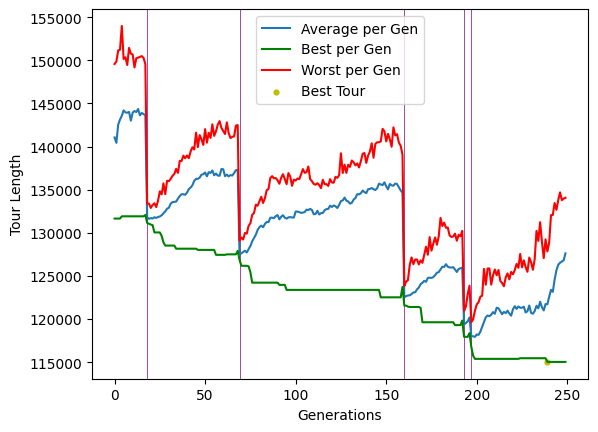

Best Tour Found in generation 239 with length of 115028.99695264966
Completed sub-tour for cluster number 224 --------------------------------------------
Running genetic algorithm on cluster 225 with 307 cities
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 203
Reintroduced 75 messiah(s) in generation 225
Reintroduced 75 messiah(s) in generation 244
19.925353288650513 seconds


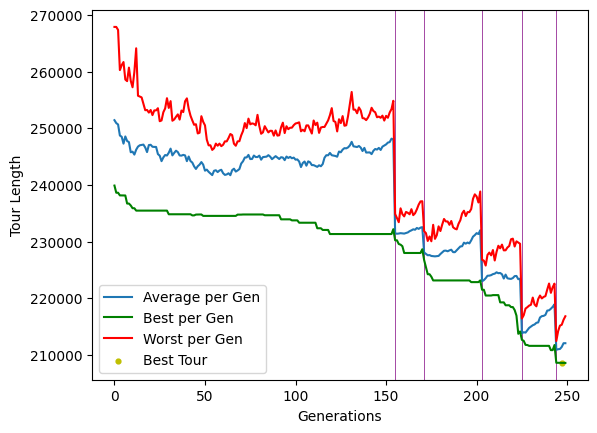

Best Tour Found in generation 247 with length of 208566.30164116703
Completed sub-tour for cluster number 225 --------------------------------------------
Running genetic algorithm on cluster 226 with 284 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 24
Reintroduced 75 messiah(s) in generation 45
Reintroduced 75 messiah(s) in generation 59
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 91
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 219
Reintroduced 75 messiah(s) in generation 244
18.38219714164734 seconds


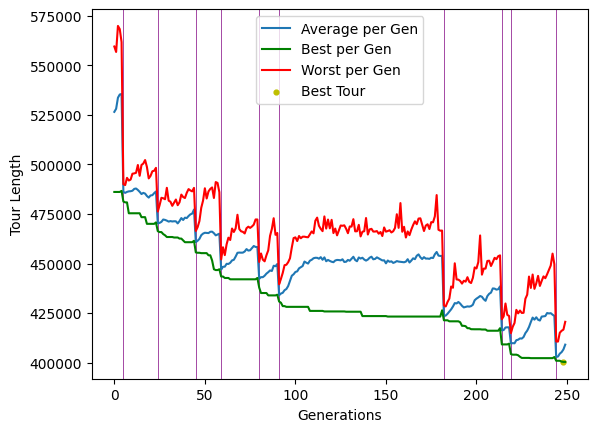

Best Tour Found in generation 248 with length of 400373.29873356095
Completed sub-tour for cluster number 226 --------------------------------------------
Running genetic algorithm on cluster 227 with 166 cities
Reintroduced 75 messiah(s) in generation 73
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 173
Reintroduced 75 messiah(s) in generation 226
10.846212148666382 seconds


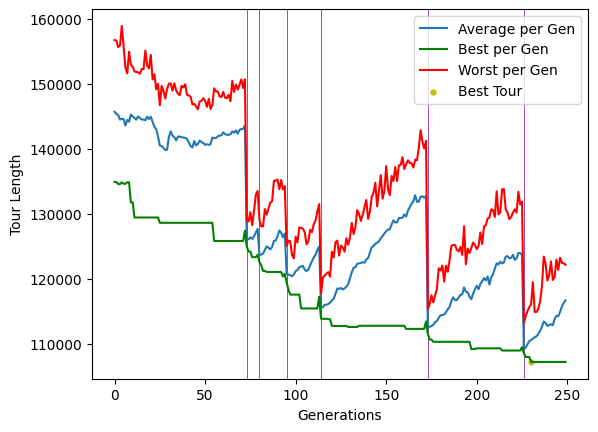

Best Tour Found in generation 230 with length of 107223.13854340385
Completed sub-tour for cluster number 227 --------------------------------------------
Running genetic algorithm on cluster 228 with 363 cities
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 109
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 197
Reintroduced 75 messiah(s) in generation 199
23.623494863510132 seconds


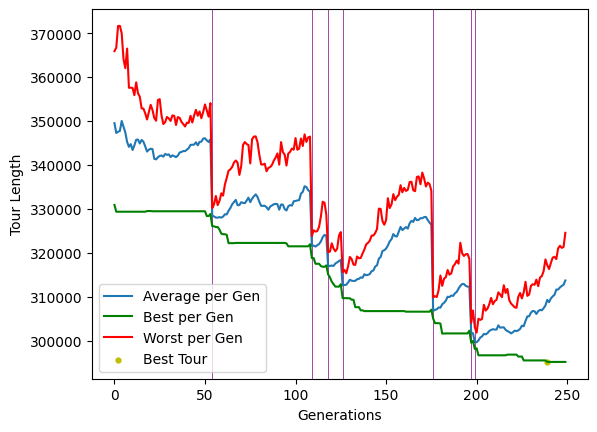

Best Tour Found in generation 239 with length of 295224.6881377716
Completed sub-tour for cluster number 228 --------------------------------------------
Running genetic algorithm on cluster 229 with 222 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 188
14.380845069885254 seconds


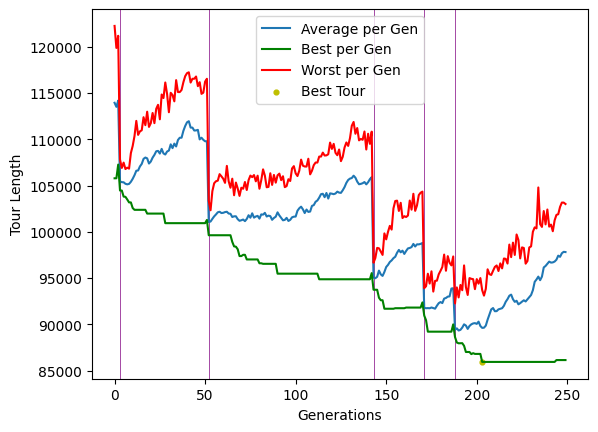

Best Tour Found in generation 203 with length of 85939.48137551825
Completed sub-tour for cluster number 229 --------------------------------------------
Running genetic algorithm on cluster 230 with 270 cities
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 80
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 232
17.586452960968018 seconds


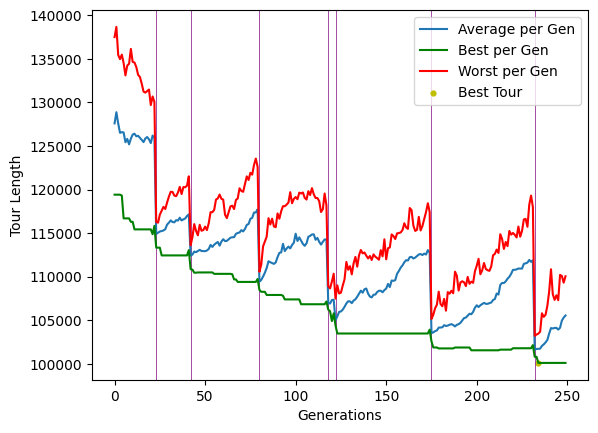

Best Tour Found in generation 234 with length of 100114.20934182384
Completed sub-tour for cluster number 230 --------------------------------------------
Running genetic algorithm on cluster 231 with 216 cities
Reintroduced 75 messiah(s) in generation 43
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 182
Reintroduced 75 messiah(s) in generation 230
Reintroduced 75 messiah(s) in generation 240
14.026043176651001 seconds


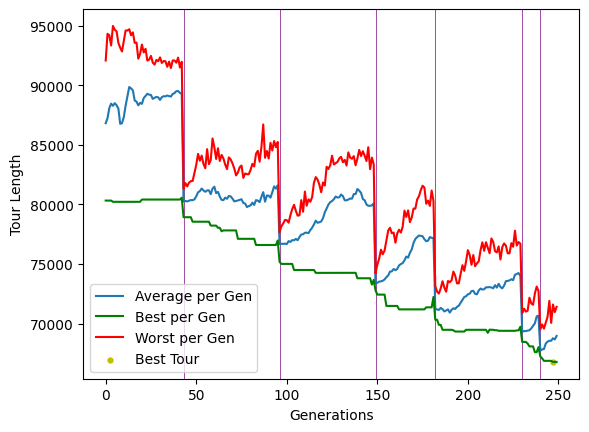

Best Tour Found in generation 247 with length of 66774.91228906381
Completed sub-tour for cluster number 231 --------------------------------------------
Running genetic algorithm on cluster 232 with 701 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 104
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 156
Reintroduced 75 messiah(s) in generation 236
47.74111270904541 seconds


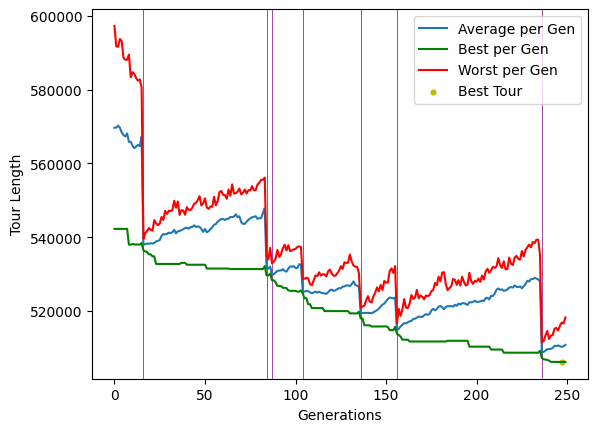

Best Tour Found in generation 247 with length of 506212.97102214105
Completed sub-tour for cluster number 232 --------------------------------------------
Running genetic algorithm on cluster 233 with 250 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 74
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 226
16.042330980300903 seconds


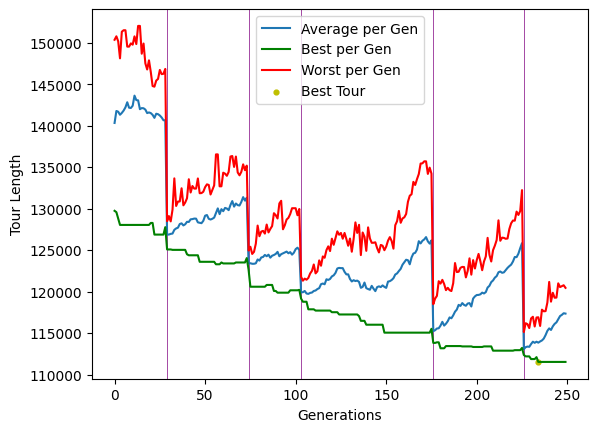

Best Tour Found in generation 234 with length of 111522.63548218548
Completed sub-tour for cluster number 233 --------------------------------------------
Running genetic algorithm on cluster 234 with 444 cities
Reintroduced 75 messiah(s) in generation 58
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 236
29.102823972702026 seconds


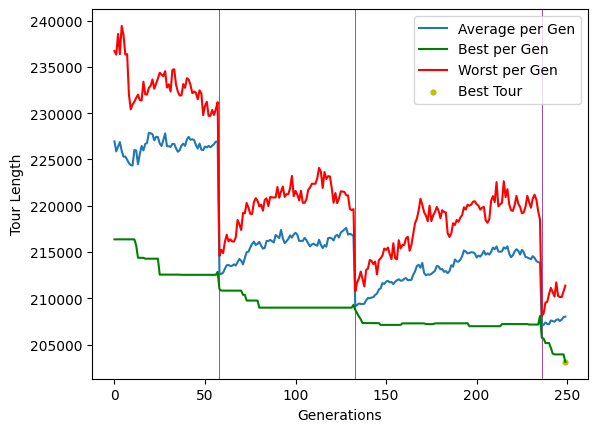

Best Tour Found in generation 249 with length of 203118.87586197566
Completed sub-tour for cluster number 234 --------------------------------------------
Running genetic algorithm on cluster 235 with 238 cities
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 142
Reintroduced 75 messiah(s) in generation 189
Reintroduced 75 messiah(s) in generation 235
15.523173093795776 seconds


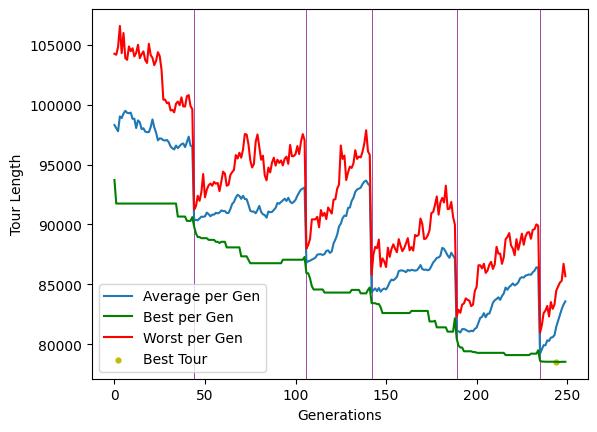

Best Tour Found in generation 244 with length of 78518.72233350483
Completed sub-tour for cluster number 235 --------------------------------------------
Running genetic algorithm on cluster 236 with 644 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 234
Reintroduced 75 messiah(s) in generation 249
43.98667812347412 seconds


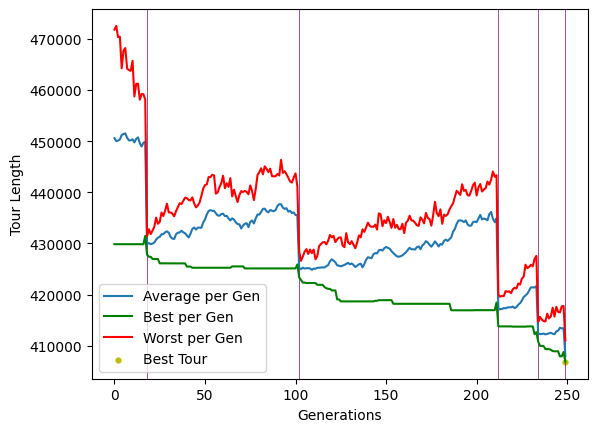

Best Tour Found in generation 249 with length of 406821.2313100939
Completed sub-tour for cluster number 236 --------------------------------------------
Running genetic algorithm on cluster 237 with 129 cities
Reintroduced 75 messiah(s) in generation 30
Reintroduced 75 messiah(s) in generation 154
Reintroduced 75 messiah(s) in generation 239
8.439833164215088 seconds


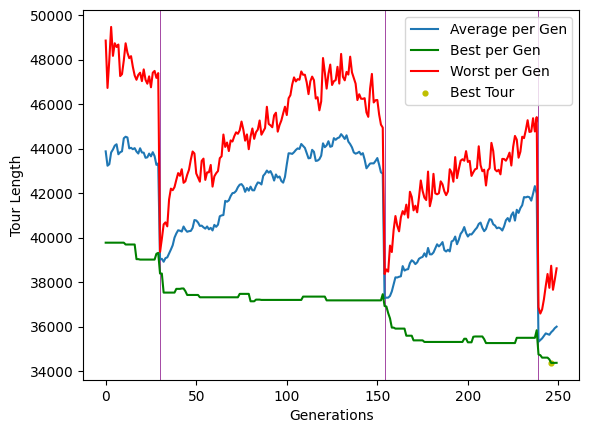

Best Tour Found in generation 246 with length of 34366.78410145158
Completed sub-tour for cluster number 237 --------------------------------------------
Running genetic algorithm on cluster 238 with 266 cities
Reintroduced 75 messiah(s) in generation 22
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 164
Reintroduced 75 messiah(s) in generation 213
17.53925395011902 seconds


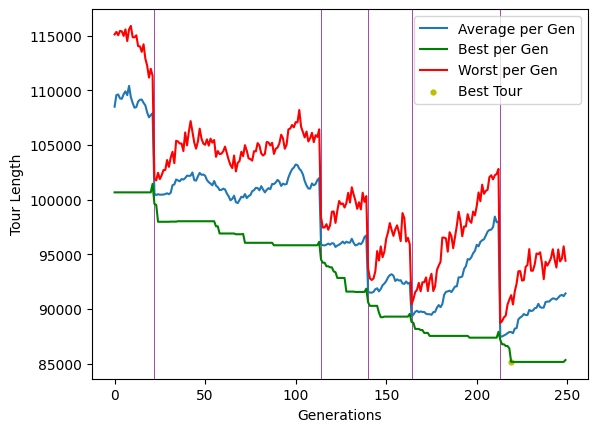

Best Tour Found in generation 219 with length of 85160.96180118178
Completed sub-tour for cluster number 238 --------------------------------------------
Running genetic algorithm on cluster 239 with 317 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 98
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 180
Reintroduced 75 messiah(s) in generation 204
20.67899489402771 seconds


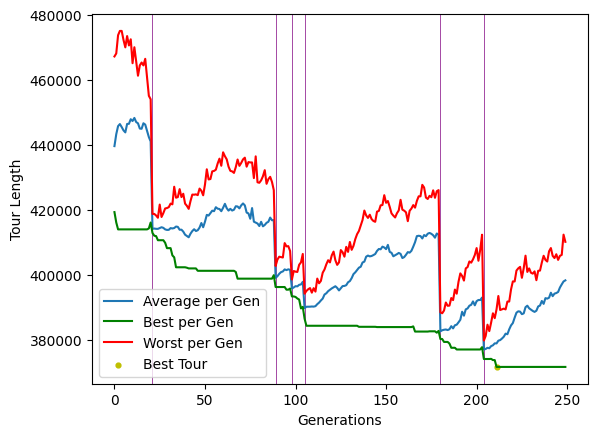

Best Tour Found in generation 211 with length of 371772.9705938608
Completed sub-tour for cluster number 239 --------------------------------------------
Running genetic algorithm on cluster 240 with 313 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 48
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 70
Reintroduced 75 messiah(s) in generation 89
Reintroduced 75 messiah(s) in generation 196
Reintroduced 75 messiah(s) in generation 201
Reintroduced 75 messiah(s) in generation 211
Reintroduced 75 messiah(s) in generation 242
20.203864812850952 seconds


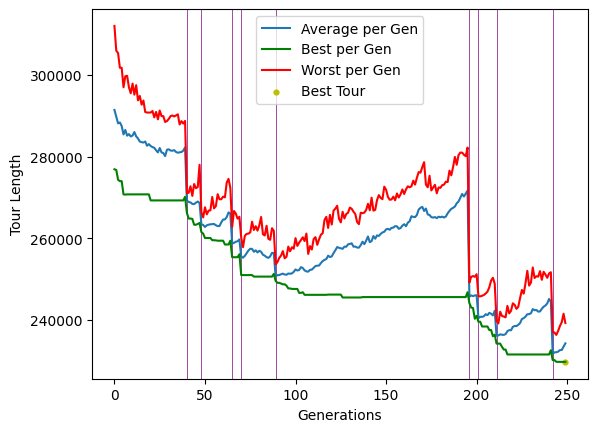

Best Tour Found in generation 249 with length of 229758.75051530887
Completed sub-tour for cluster number 240 --------------------------------------------
Running genetic algorithm on cluster 241 with 664 cities
Reintroduced 75 messiah(s) in generation 4
Reintroduced 75 messiah(s) in generation 37
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 174
44.53587985038757 seconds


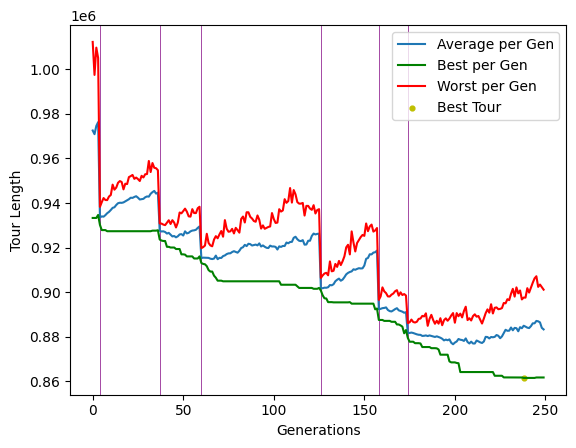

Best Tour Found in generation 238 with length of 861517.3752517399
Completed sub-tour for cluster number 241 --------------------------------------------
Running genetic algorithm on cluster 242 with 322 cities
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 88
Reintroduced 75 messiah(s) in generation 175
Reintroduced 75 messiah(s) in generation 196
20.81310534477234 seconds


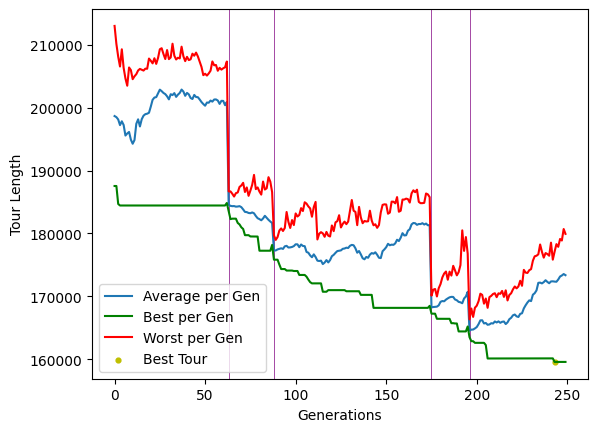

Best Tour Found in generation 243 with length of 159581.7404319533
Completed sub-tour for cluster number 242 --------------------------------------------
Running genetic algorithm on cluster 243 with 241 cities
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 82
Reintroduced 75 messiah(s) in generation 121
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 230
15.586915254592896 seconds


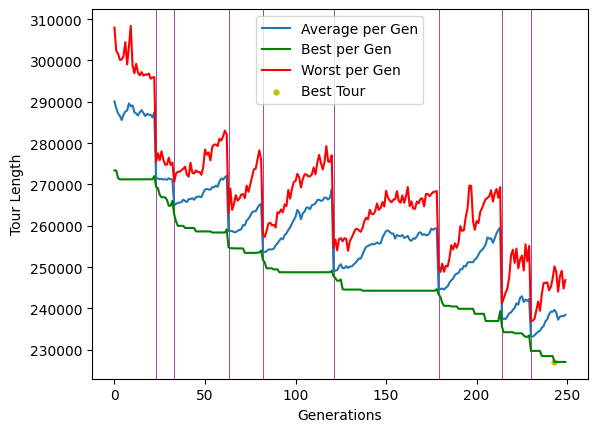

Best Tour Found in generation 243 with length of 227068.29223462922
Completed sub-tour for cluster number 243 --------------------------------------------
Running genetic algorithm on cluster 244 with 238 cities
Reintroduced 75 messiah(s) in generation 16
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 151
Reintroduced 75 messiah(s) in generation 176
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 232
15.254164934158325 seconds


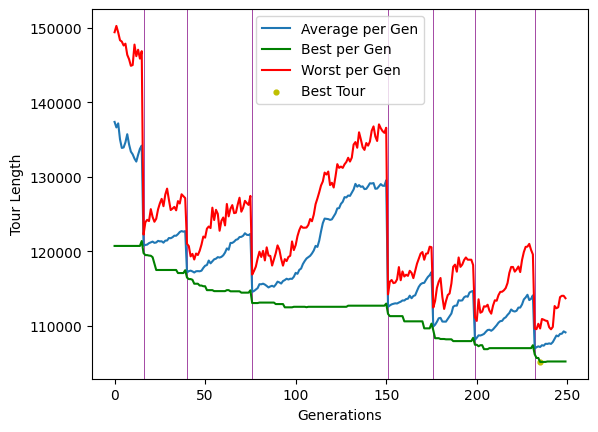

Best Tour Found in generation 235 with length of 105159.27695876973
Completed sub-tour for cluster number 244 --------------------------------------------
Running genetic algorithm on cluster 245 with 301 cities
Reintroduced 75 messiah(s) in generation 45
Reintroduced 75 messiah(s) in generation 151
19.498679876327515 seconds


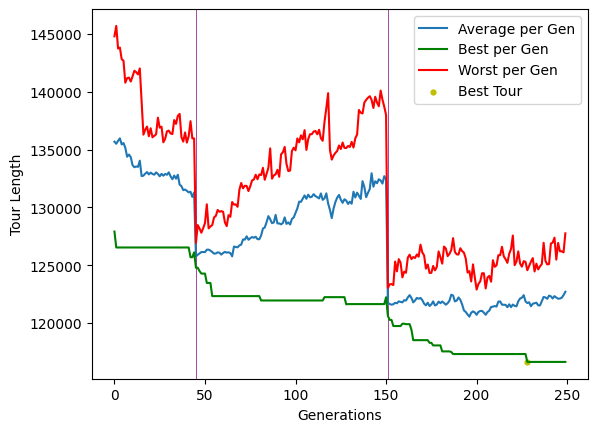

Best Tour Found in generation 228 with length of 116629.36701991329
Completed sub-tour for cluster number 245 --------------------------------------------
Running genetic algorithm on cluster 246 with 218 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 206
14.105803966522217 seconds


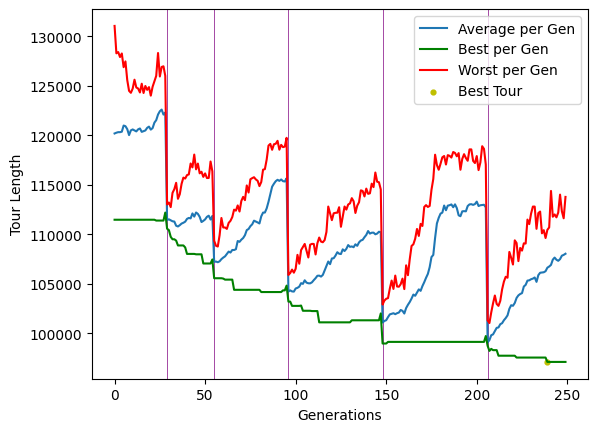

Best Tour Found in generation 239 with length of 97104.69809344731
Completed sub-tour for cluster number 246 --------------------------------------------
Running genetic algorithm on cluster 247 with 266 cities
Reintroduced 75 messiah(s) in generation 10
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 135
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 173
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 228
Reintroduced 75 messiah(s) in generation 240
17.458744049072266 seconds


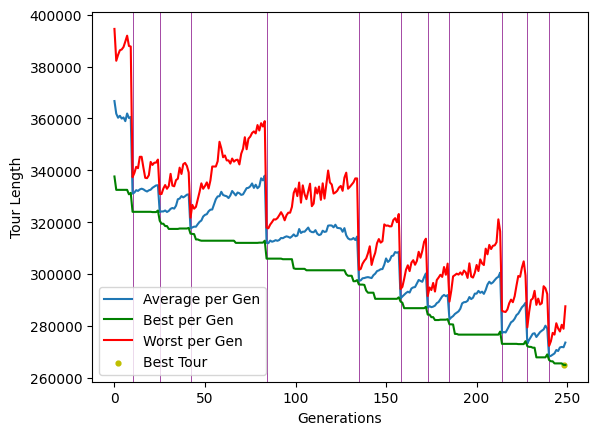

Best Tour Found in generation 248 with length of 264985.5855053657
Completed sub-tour for cluster number 247 --------------------------------------------
Running genetic algorithm on cluster 248 with 498 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 83
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 215
33.84467816352844 seconds


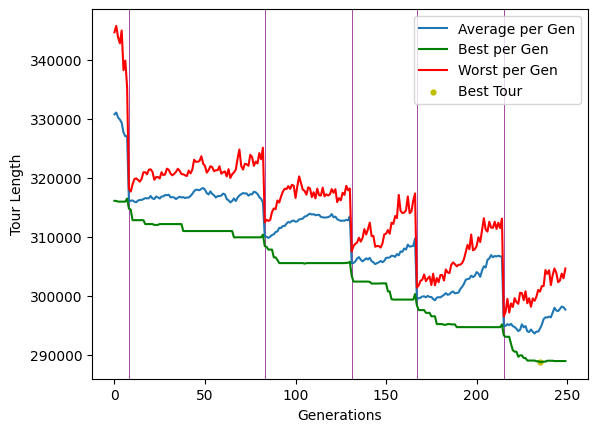

Best Tour Found in generation 235 with length of 288779.9514099655
Completed sub-tour for cluster number 248 --------------------------------------------
Running genetic algorithm on cluster 249 with 605 cities
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 129
Reintroduced 75 messiah(s) in generation 233
42.15907287597656 seconds


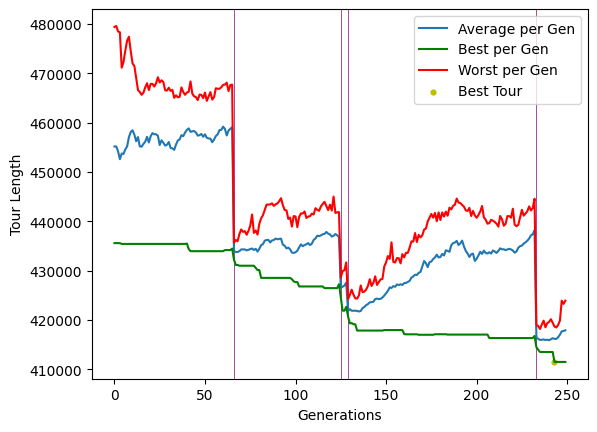

Best Tour Found in generation 243 with length of 411520.40542941284
Completed sub-tour for cluster number 249 --------------------------------------------
Running genetic algorithm on cluster 250 with 313 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 56
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 134
Reintroduced 75 messiah(s) in generation 151
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 186
20.493825912475586 seconds


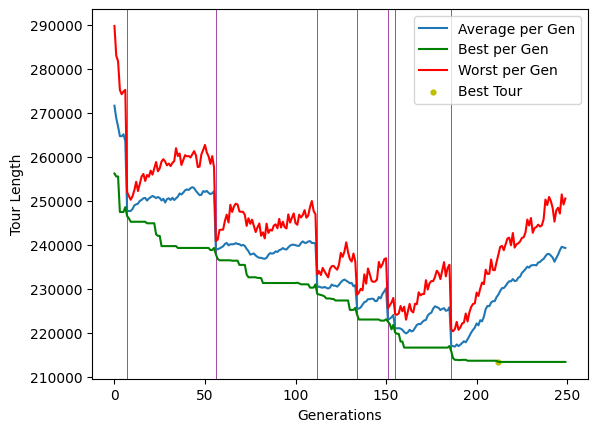

Best Tour Found in generation 212 with length of 213372.93498674032
Completed sub-tour for cluster number 250 --------------------------------------------
Running genetic algorithm on cluster 251 with 394 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 39
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 110
Reintroduced 75 messiah(s) in generation 214
25.925292015075684 seconds


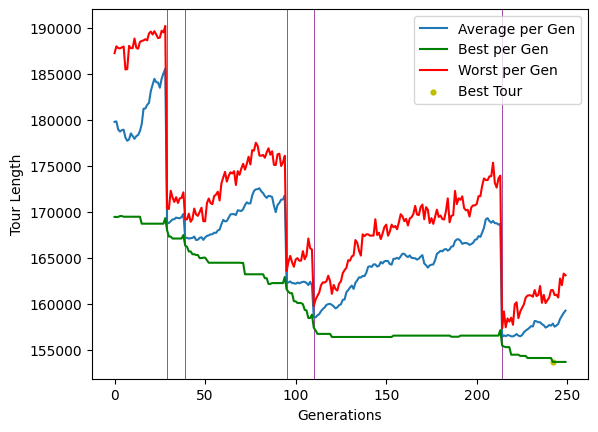

Best Tour Found in generation 242 with length of 153680.07449164748
Completed sub-tour for cluster number 251 --------------------------------------------
Running genetic algorithm on cluster 252 with 288 cities
Reintroduced 75 messiah(s) in generation 91
Reintroduced 75 messiah(s) in generation 187
Reintroduced 75 messiah(s) in generation 207
Reintroduced 75 messiah(s) in generation 224
18.972881078720093 seconds


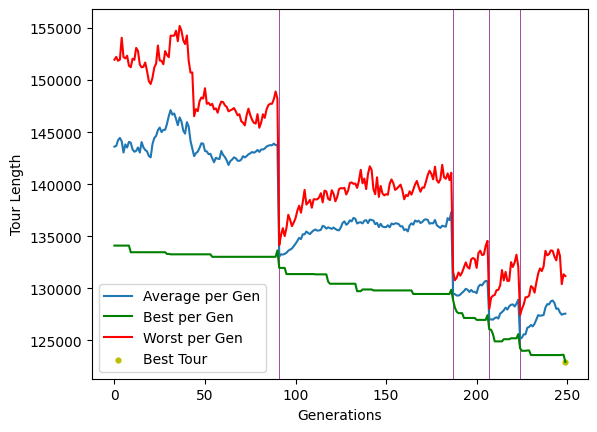

Best Tour Found in generation 249 with length of 122906.43143770572
Completed sub-tour for cluster number 252 --------------------------------------------
Running genetic algorithm on cluster 253 with 282 cities
Reintroduced 75 messiah(s) in generation 50
Reintroduced 75 messiah(s) in generation 103
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 209
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 222
18.67366600036621 seconds


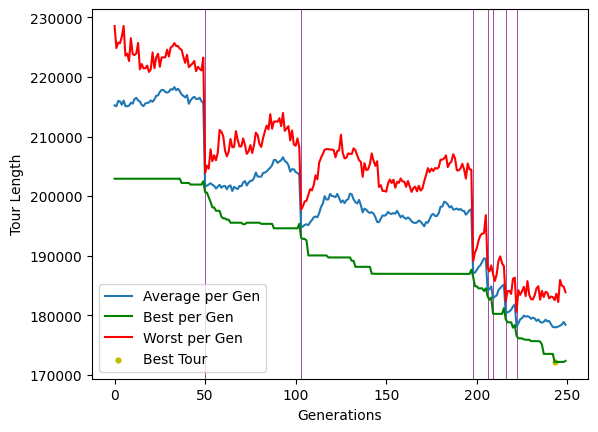

Best Tour Found in generation 243 with length of 172154.06997058724
Completed sub-tour for cluster number 253 --------------------------------------------
Running genetic algorithm on cluster 254 with 368 cities
Reintroduced 75 messiah(s) in generation 7
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 96
Reintroduced 75 messiah(s) in generation 127
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 214
24.455200910568237 seconds


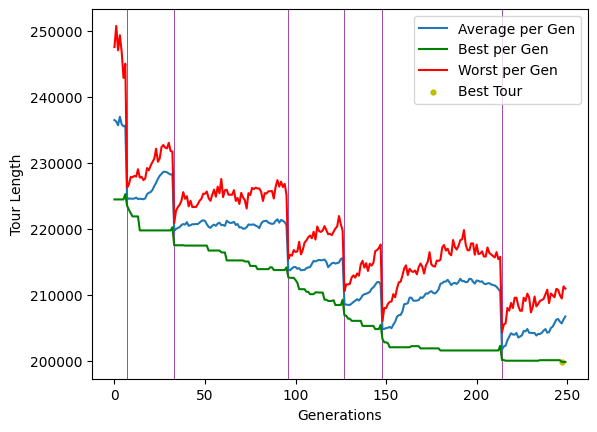

Best Tour Found in generation 247 with length of 199816.0623567191
Completed sub-tour for cluster number 254 --------------------------------------------
Running genetic algorithm on cluster 255 with 521 cities
Reintroduced 75 messiah(s) in generation 25
Reintroduced 75 messiah(s) in generation 43
Reintroduced 75 messiah(s) in generation 248
35.38513374328613 seconds


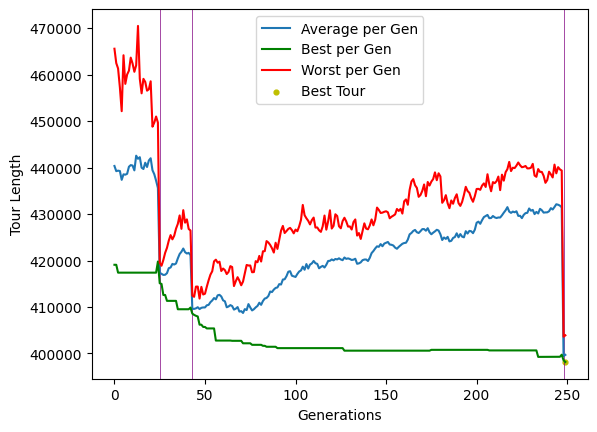

Best Tour Found in generation 249 with length of 398186.59088997275
Completed sub-tour for cluster number 255 --------------------------------------------
Running genetic algorithm on cluster 256 with 609 cities
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 158
Reintroduced 75 messiah(s) in generation 192
Reintroduced 75 messiah(s) in generation 224
Reintroduced 75 messiah(s) in generation 227
41.5244460105896 seconds


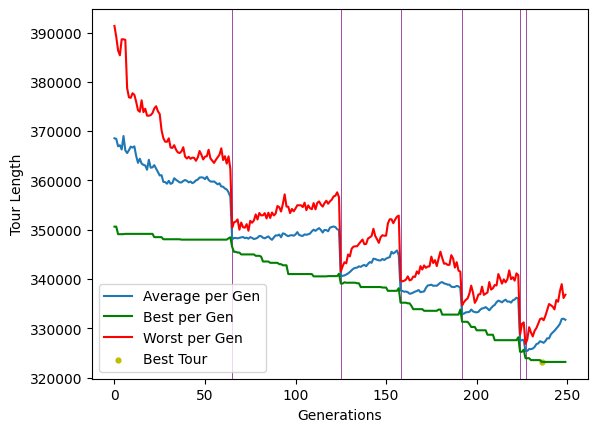

Best Tour Found in generation 236 with length of 323163.6701683492
Completed sub-tour for cluster number 256 --------------------------------------------
Running genetic algorithm on cluster 257 with 674 cities
Reintroduced 75 messiah(s) in generation 38
Reintroduced 75 messiah(s) in generation 99
Reintroduced 75 messiah(s) in generation 126
Reintroduced 75 messiah(s) in generation 171
Reintroduced 75 messiah(s) in generation 209
Reintroduced 75 messiah(s) in generation 246
46.401220083236694 seconds


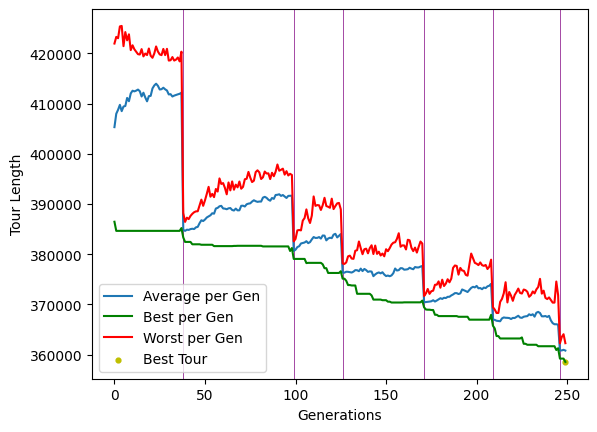

Best Tour Found in generation 249 with length of 358528.7305548765
Completed sub-tour for cluster number 257 --------------------------------------------
Running genetic algorithm on cluster 258 with 333 cities
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 60
Reintroduced 75 messiah(s) in generation 204
Reintroduced 75 messiah(s) in generation 208
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 231
21.884212017059326 seconds


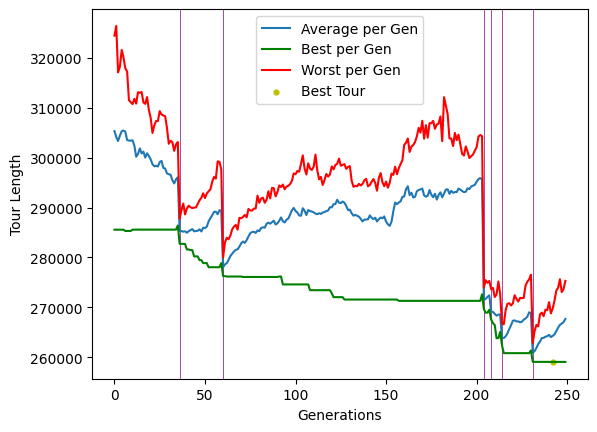

Best Tour Found in generation 242 with length of 259082.37677010425
Completed sub-tour for cluster number 258 --------------------------------------------
Running genetic algorithm on cluster 259 with 512 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 107
Reintroduced 75 messiah(s) in generation 119
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 223
35.169041872024536 seconds


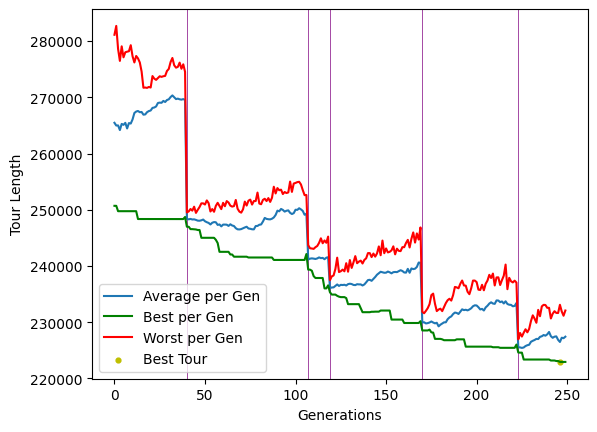

Best Tour Found in generation 246 with length of 222947.55740168583
Completed sub-tour for cluster number 259 --------------------------------------------
Running genetic algorithm on cluster 260 with 410 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 71
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 226
27.062422037124634 seconds


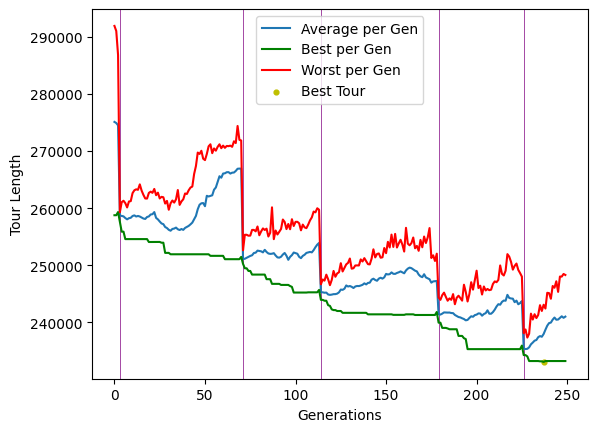

Best Tour Found in generation 237 with length of 233093.0824825353
Completed sub-tour for cluster number 260 --------------------------------------------
Running genetic algorithm on cluster 261 with 296 cities
Reintroduced 75 messiah(s) in generation 136
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 221
19.50287699699402 seconds


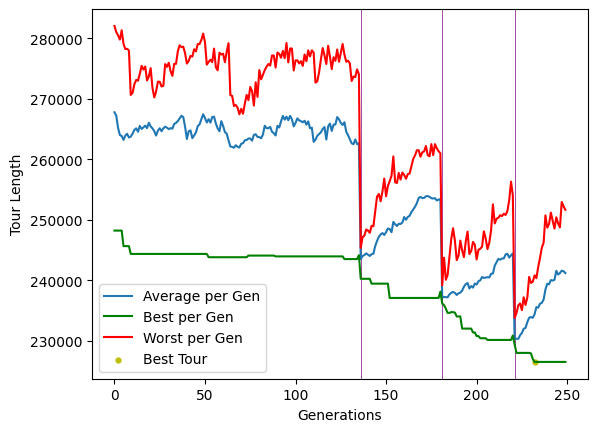

Best Tour Found in generation 232 with length of 226535.01009028417
Completed sub-tour for cluster number 261 --------------------------------------------
Running genetic algorithm on cluster 262 with 421 cities
Reintroduced 75 messiah(s) in generation 36
Reintroduced 75 messiah(s) in generation 45
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 87
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 133
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 182
27.517552852630615 seconds


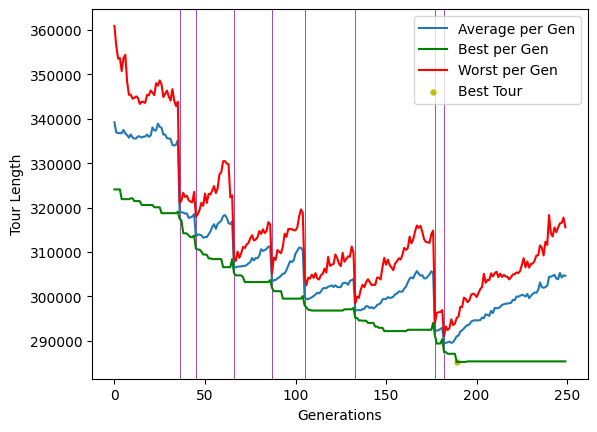

Best Tour Found in generation 189 with length of 285245.3444781038
Completed sub-tour for cluster number 262 --------------------------------------------
Running genetic algorithm on cluster 263 with 428 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 140
Reintroduced 75 messiah(s) in generation 234
28.541783094406128 seconds


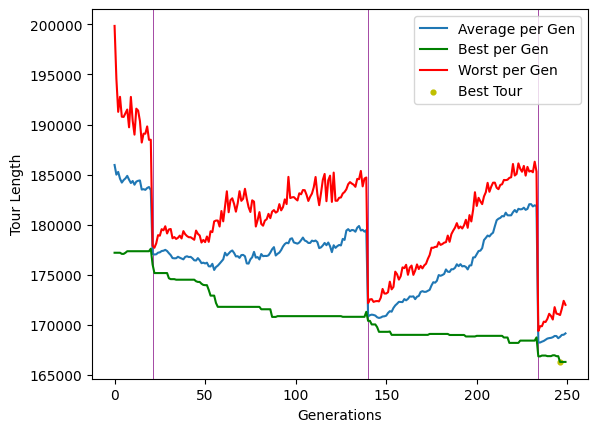

Best Tour Found in generation 246 with length of 166297.0974560913
Completed sub-tour for cluster number 263 --------------------------------------------
Running genetic algorithm on cluster 264 with 518 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 118
34.96875500679016 seconds


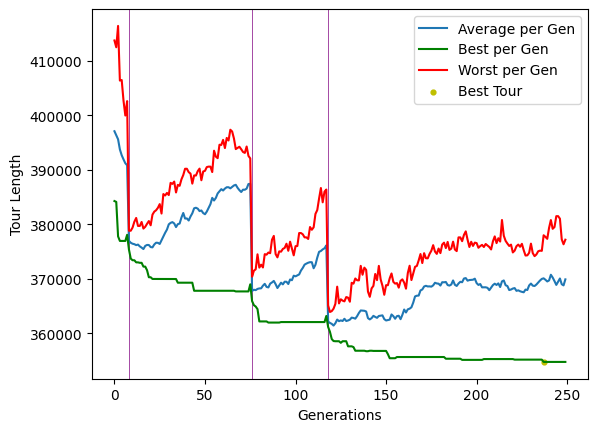

Best Tour Found in generation 237 with length of 354790.3800016912
Completed sub-tour for cluster number 264 --------------------------------------------
Running genetic algorithm on cluster 265 with 271 cities
Reintroduced 75 messiah(s) in generation 66
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 201
Reintroduced 75 messiah(s) in generation 249
17.975773811340332 seconds


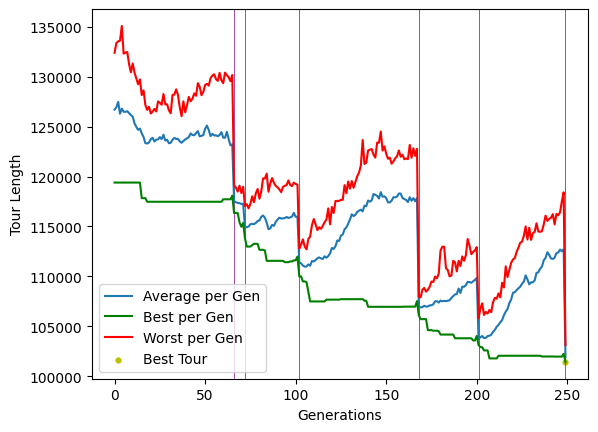

Best Tour Found in generation 249 with length of 101431.83257918163
Completed sub-tour for cluster number 265 --------------------------------------------
Running genetic algorithm on cluster 266 with 700 cities
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 223
47.37919497489929 seconds


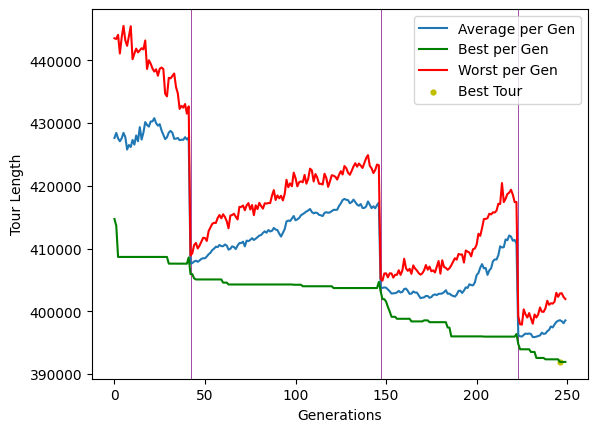

Best Tour Found in generation 246 with length of 391930.2607358327
Completed sub-tour for cluster number 266 --------------------------------------------
Running genetic algorithm on cluster 267 with 479 cities
Reintroduced 75 messiah(s) in generation 15
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 173
Reintroduced 75 messiah(s) in generation 183
Reintroduced 75 messiah(s) in generation 246
31.489182949066162 seconds


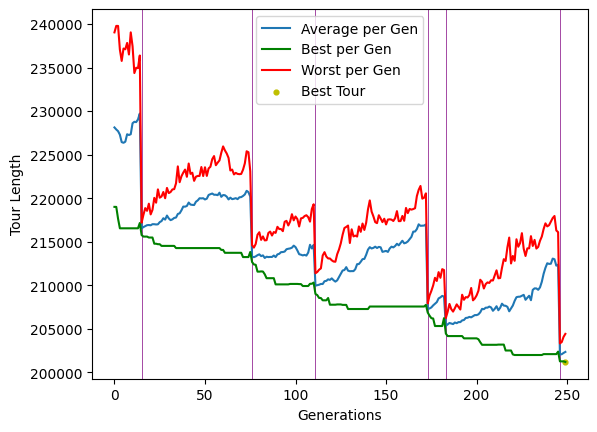

Best Tour Found in generation 249 with length of 201185.80185707752
Completed sub-tour for cluster number 267 --------------------------------------------
Running genetic algorithm on cluster 268 with 827 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 34
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 180
Reintroduced 75 messiah(s) in generation 248
56.372668981552124 seconds


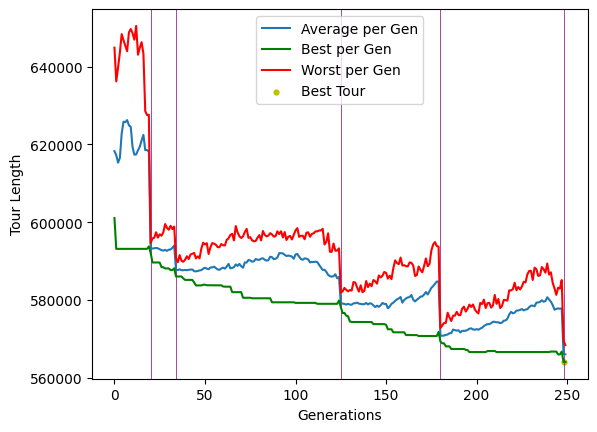

Best Tour Found in generation 248 with length of 564063.7238859994
Completed sub-tour for cluster number 268 --------------------------------------------
Running genetic algorithm on cluster 269 with 345 cities
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 167
Reintroduced 75 messiah(s) in generation 228
22.512441873550415 seconds


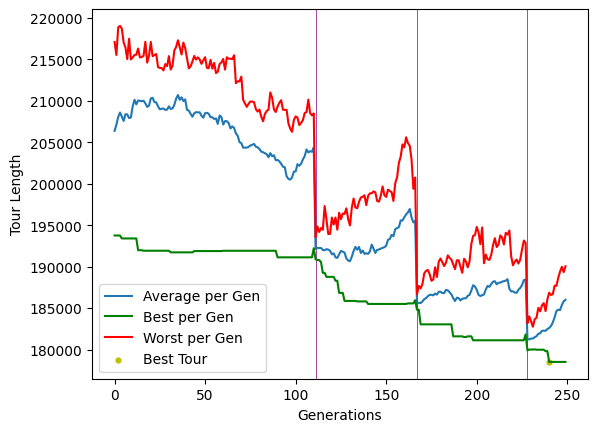

Best Tour Found in generation 240 with length of 178509.6521092948
Completed sub-tour for cluster number 269 --------------------------------------------
Running genetic algorithm on cluster 270 with 748 cities
Reintroduced 75 messiah(s) in generation 65
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 166
Reintroduced 75 messiah(s) in generation 212
Reintroduced 75 messiah(s) in generation 229
50.88977313041687 seconds


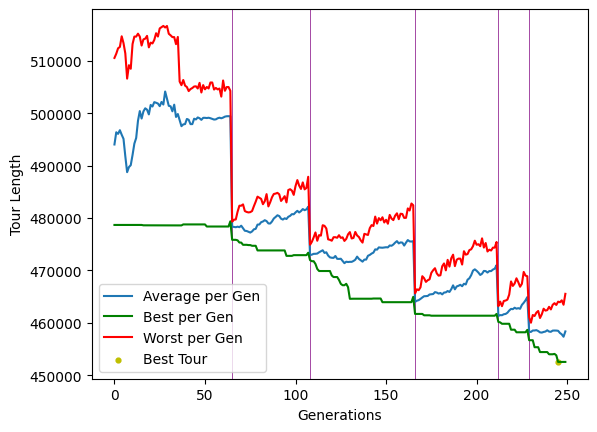

Best Tour Found in generation 245 with length of 452529.208094506
Completed sub-tour for cluster number 270 --------------------------------------------
Running genetic algorithm on cluster 271 with 380 cities
Reintroduced 75 messiah(s) in generation 19
Reintroduced 75 messiah(s) in generation 106
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 185
Reintroduced 75 messiah(s) in generation 215
Reintroduced 75 messiah(s) in generation 226
Reintroduced 75 messiah(s) in generation 229
Reintroduced 75 messiah(s) in generation 248
24.944968938827515 seconds


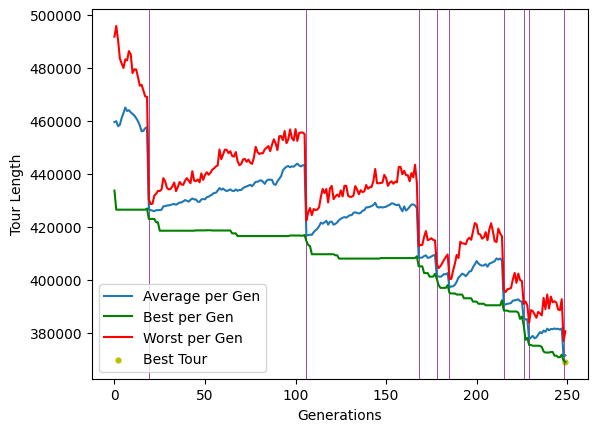

Best Tour Found in generation 249 with length of 369108.36039138556
Completed sub-tour for cluster number 271 --------------------------------------------
Running genetic algorithm on cluster 272 with 228 cities
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 84
Reintroduced 75 messiah(s) in generation 108
14.750823020935059 seconds


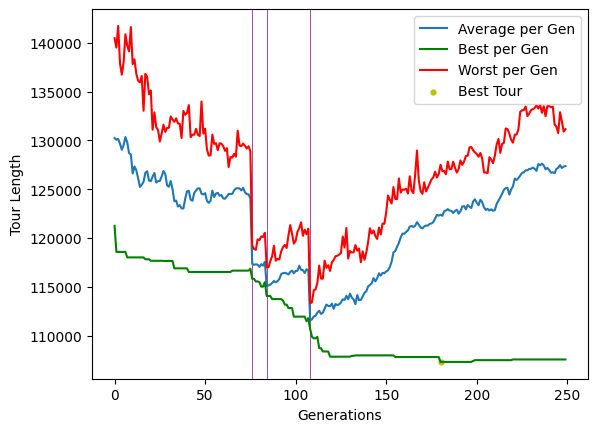

Best Tour Found in generation 180 with length of 107324.68724701978
Completed sub-tour for cluster number 272 --------------------------------------------
Running genetic algorithm on cluster 273 with 235 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 77
Reintroduced 75 messiah(s) in generation 113
Reintroduced 75 messiah(s) in generation 121
Reintroduced 75 messiah(s) in generation 137
Reintroduced 75 messiah(s) in generation 145
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 186
Reintroduced 75 messiah(s) in generation 196
Reintroduced 75 messiah(s) in generation 203
Reintroduced 75 messiah(s) in generation 214
Reintroduced 75 messiah(s) in generation 236
15.24074912071228 seconds


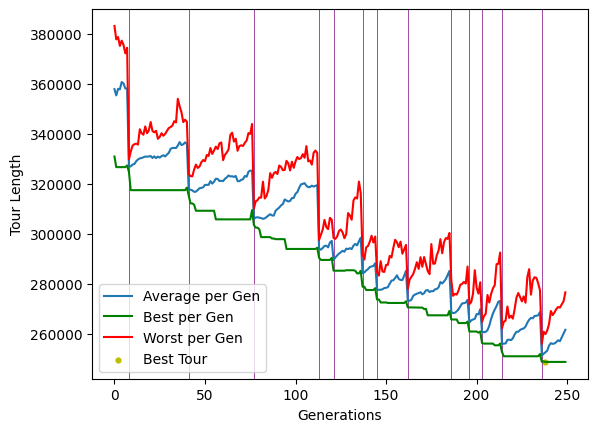

Best Tour Found in generation 238 with length of 248880.17264703012
Completed sub-tour for cluster number 273 --------------------------------------------
Running genetic algorithm on cluster 274 with 358 cities
Reintroduced 75 messiah(s) in generation 31
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 244
23.516646146774292 seconds


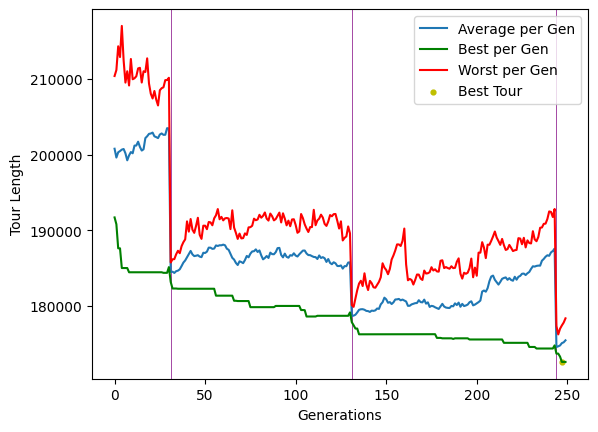

Best Tour Found in generation 247 with length of 172618.18450574725
Completed sub-tour for cluster number 274 --------------------------------------------
Running genetic algorithm on cluster 275 with 257 cities
Reintroduced 75 messiah(s) in generation 49
Reintroduced 75 messiah(s) in generation 139
Reintroduced 75 messiah(s) in generation 185
16.616384029388428 seconds


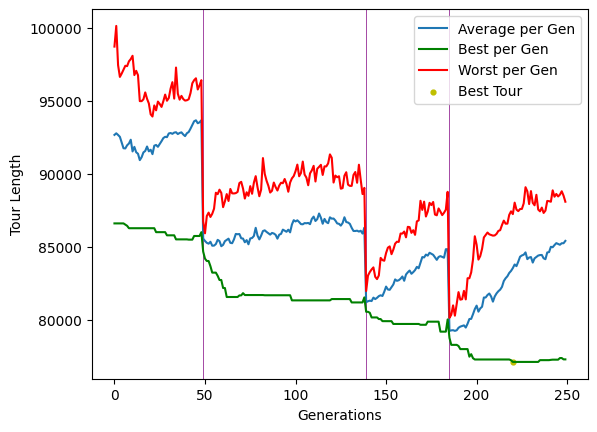

Best Tour Found in generation 220 with length of 77112.00371437016
Completed sub-tour for cluster number 275 --------------------------------------------
Running genetic algorithm on cluster 276 with 432 cities
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 68
Reintroduced 75 messiah(s) in generation 179
Reintroduced 75 messiah(s) in generation 185
28.36906385421753 seconds


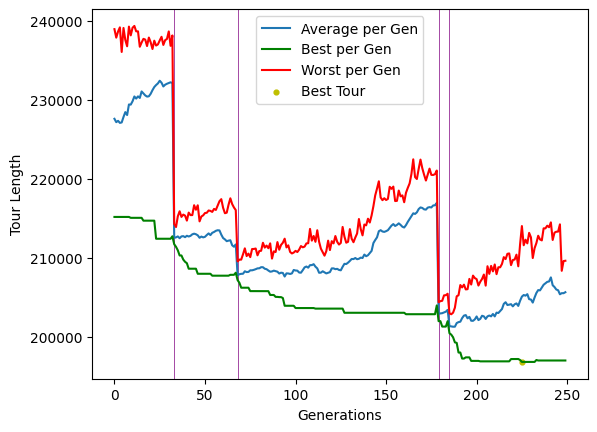

Best Tour Found in generation 225 with length of 196844.40577960512
Completed sub-tour for cluster number 276 --------------------------------------------
Running genetic algorithm on cluster 277 with 533 cities
Reintroduced 75 messiah(s) in generation 8
Reintroduced 75 messiah(s) in generation 44
Reintroduced 75 messiah(s) in generation 55
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 164
35.937702894210815 seconds


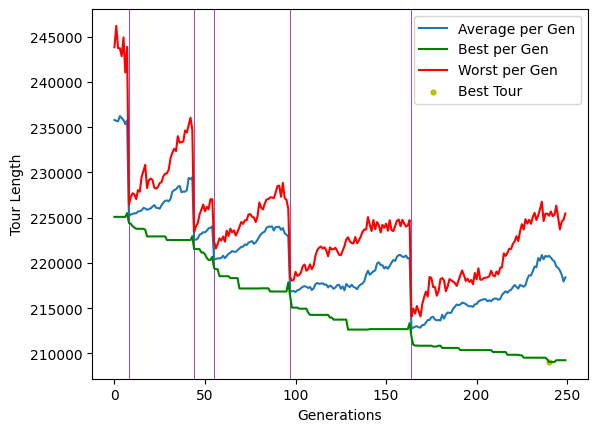

Best Tour Found in generation 240 with length of 209065.99265547981
Completed sub-tour for cluster number 277 --------------------------------------------
Running genetic algorithm on cluster 278 with 180 cities
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 117
Reintroduced 75 messiah(s) in generation 128
Reintroduced 75 messiah(s) in generation 166
Reintroduced 75 messiah(s) in generation 217
Reintroduced 75 messiah(s) in generation 245
11.84289002418518 seconds


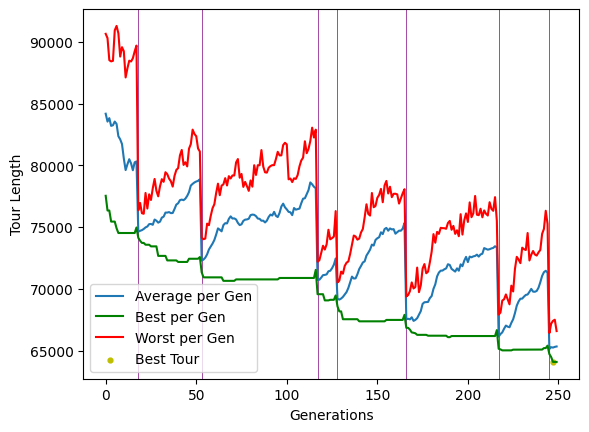

Best Tour Found in generation 247 with length of 64085.24747656385
Completed sub-tour for cluster number 278 --------------------------------------------
Running genetic algorithm on cluster 279 with 370 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 17
Reintroduced 75 messiah(s) in generation 33
Reintroduced 75 messiah(s) in generation 144
Reintroduced 75 messiah(s) in generation 202
Reintroduced 75 messiah(s) in generation 241
24.100977897644043 seconds


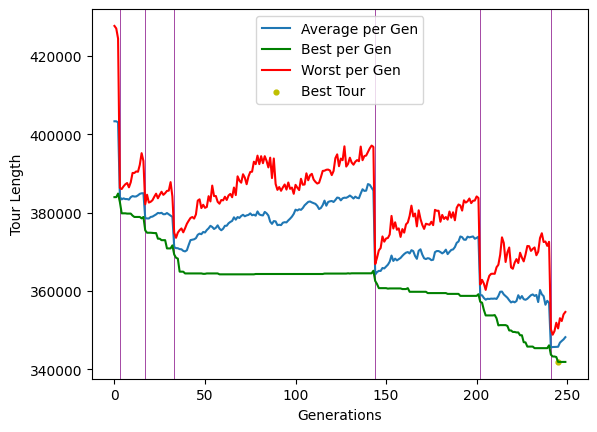

Best Tour Found in generation 245 with length of 341880.6595932022
Completed sub-tour for cluster number 279 --------------------------------------------
Running genetic algorithm on cluster 280 with 275 cities
Reintroduced 75 messiah(s) in generation 6
Reintroduced 75 messiah(s) in generation 32
Reintroduced 75 messiah(s) in generation 76
Reintroduced 75 messiah(s) in generation 112
Reintroduced 75 messiah(s) in generation 153
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 190
Reintroduced 75 messiah(s) in generation 229
18.251384019851685 seconds


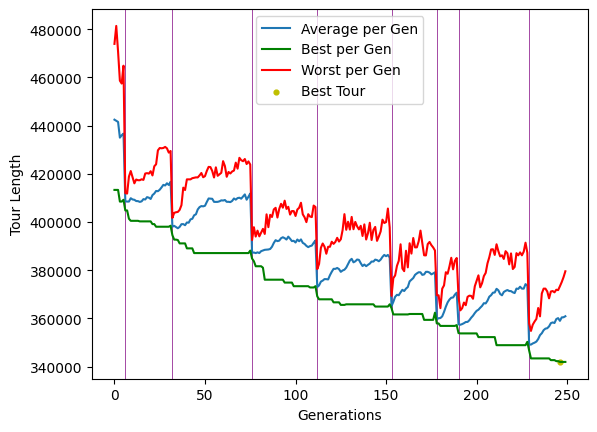

Best Tour Found in generation 246 with length of 341908.1541708842
Completed sub-tour for cluster number 280 --------------------------------------------
Running genetic algorithm on cluster 281 with 349 cities
Reintroduced 75 messiah(s) in generation 3
Reintroduced 75 messiah(s) in generation 23
Reintroduced 75 messiah(s) in generation 38
Reintroduced 75 messiah(s) in generation 54
Reintroduced 75 messiah(s) in generation 97
Reintroduced 75 messiah(s) in generation 118
Reintroduced 75 messiah(s) in generation 165
Reintroduced 75 messiah(s) in generation 170
Reintroduced 75 messiah(s) in generation 177
Reintroduced 75 messiah(s) in generation 223
23.743587017059326 seconds


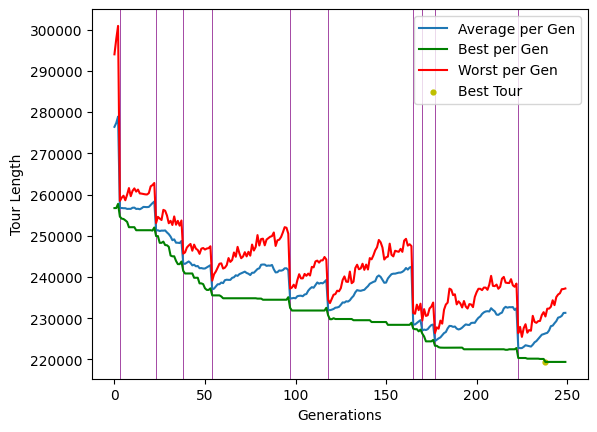

Best Tour Found in generation 238 with length of 219388.13734616636
Completed sub-tour for cluster number 281 --------------------------------------------
Running genetic algorithm on cluster 282 with 179 cities
Reintroduced 75 messiah(s) in generation 40
Reintroduced 75 messiah(s) in generation 105
Reintroduced 75 messiah(s) in generation 122
Reintroduced 75 messiah(s) in generation 155
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 243
11.80205512046814 seconds


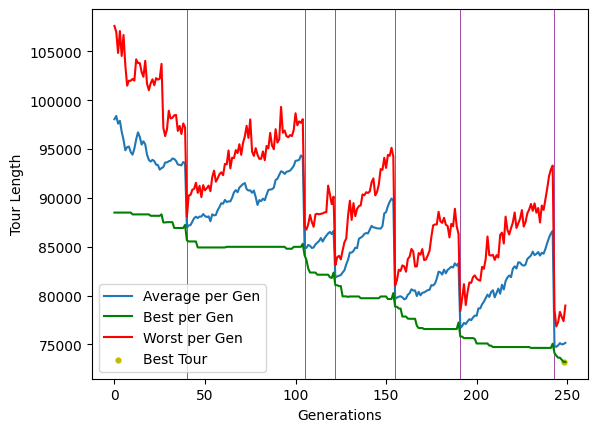

Best Tour Found in generation 248 with length of 73211.9742188841
Completed sub-tour for cluster number 282 --------------------------------------------
Running genetic algorithm on cluster 283 with 327 cities
Reintroduced 75 messiah(s) in generation 9
Reintroduced 75 messiah(s) in generation 63
Reintroduced 75 messiah(s) in generation 69
Reintroduced 75 messiah(s) in generation 94
Reintroduced 75 messiah(s) in generation 152
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 215
21.761608839035034 seconds


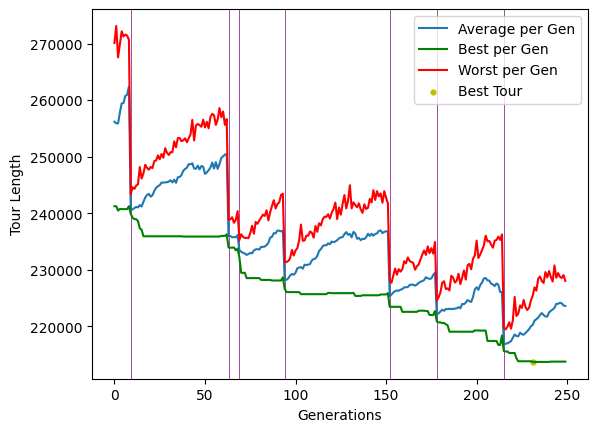

Best Tour Found in generation 231 with length of 213689.17887912467
Completed sub-tour for cluster number 283 --------------------------------------------
Running genetic algorithm on cluster 284 with 296 cities
Reintroduced 75 messiah(s) in generation 27
Reintroduced 75 messiah(s) in generation 53
Reintroduced 75 messiah(s) in generation 143
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 249
19.569844961166382 seconds


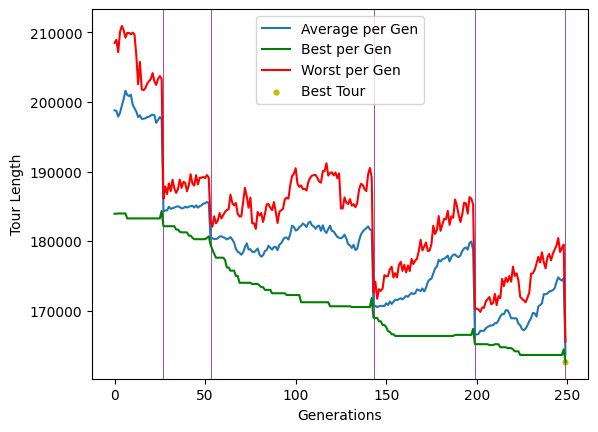

Best Tour Found in generation 249 with length of 162610.86624874728
Completed sub-tour for cluster number 284 --------------------------------------------
Running genetic algorithm on cluster 285 with 489 cities
Reintroduced 75 messiah(s) in generation 38
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 111
Reintroduced 75 messiah(s) in generation 177
32.35028886795044 seconds


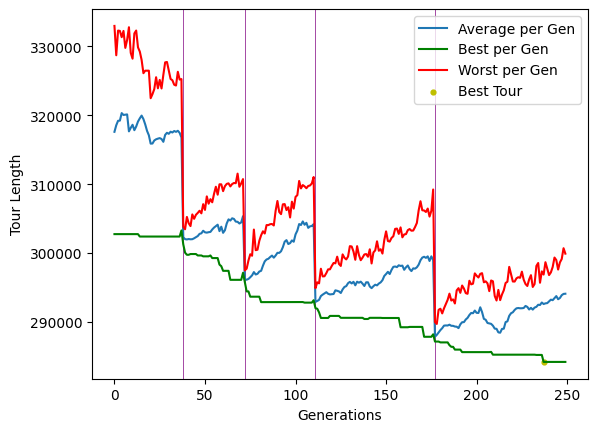

Best Tour Found in generation 237 with length of 284171.65500298236
Completed sub-tour for cluster number 285 --------------------------------------------
Running genetic algorithm on cluster 286 with 298 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 191
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 245
19.45962405204773 seconds


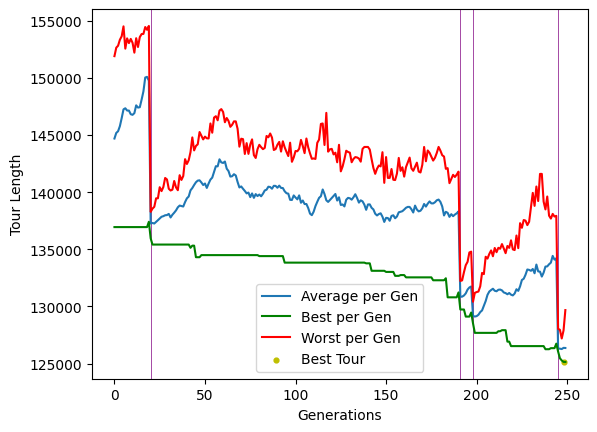

Best Tour Found in generation 248 with length of 125145.68645396802
Completed sub-tour for cluster number 286 --------------------------------------------
Running genetic algorithm on cluster 287 with 564 cities
Reintroduced 75 messiah(s) in generation 81
Reintroduced 75 messiah(s) in generation 156
Reintroduced 75 messiah(s) in generation 180
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 204
38.47533583641052 seconds


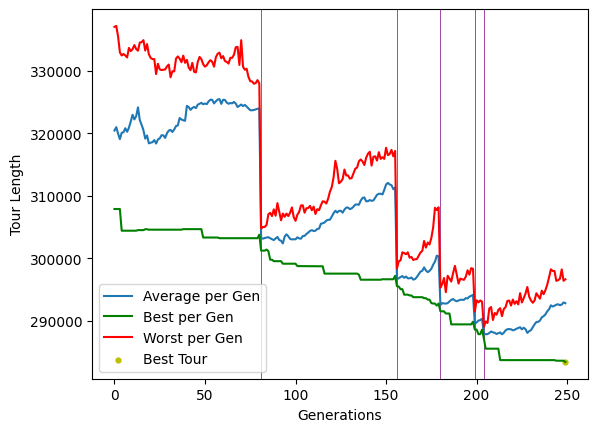

Best Tour Found in generation 249 with length of 283384.75503383455
Completed sub-tour for cluster number 287 --------------------------------------------
Running genetic algorithm on cluster 288 with 653 cities
Reintroduced 75 messiah(s) in generation 32
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 204
44.328678131103516 seconds


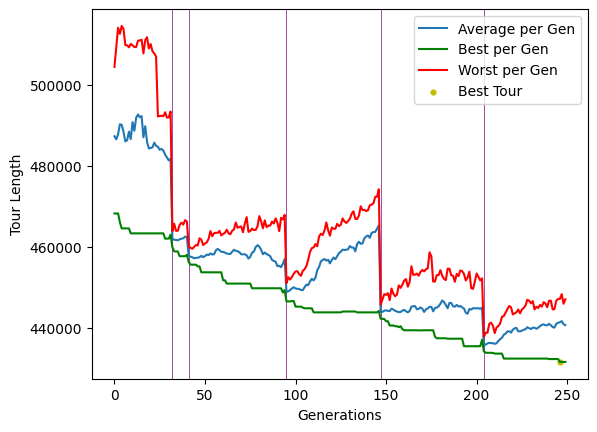

Best Tour Found in generation 246 with length of 431577.32605077437
Completed sub-tour for cluster number 288 --------------------------------------------
Running genetic algorithm on cluster 289 with 420 cities
Reintroduced 75 messiah(s) in generation 72
Reintroduced 75 messiah(s) in generation 102
Reintroduced 75 messiah(s) in generation 168
Reintroduced 75 messiah(s) in generation 250
27.741755962371826 seconds


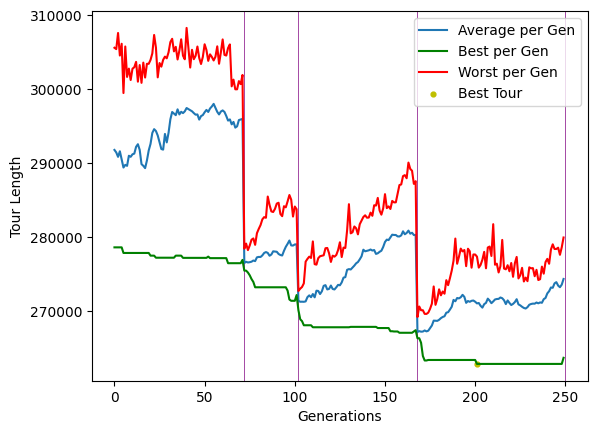

Best Tour Found in generation 201 with length of 262820.98717091663
Completed sub-tour for cluster number 289 --------------------------------------------
Running genetic algorithm on cluster 290 with 266 cities
Reintroduced 75 messiah(s) in generation 161
Reintroduced 75 messiah(s) in generation 202
17.420839071273804 seconds


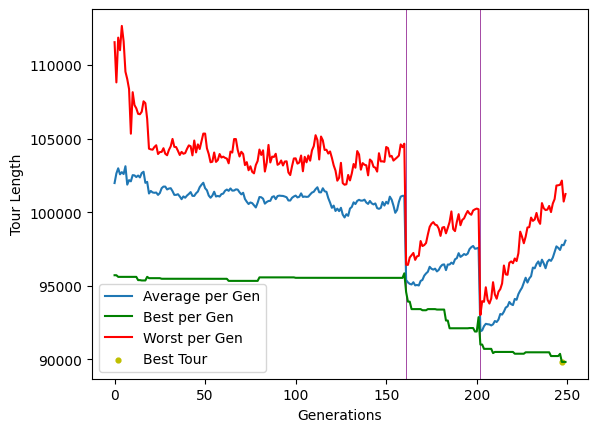

Best Tour Found in generation 247 with length of 89822.50953037426
Completed sub-tour for cluster number 290 --------------------------------------------
Running genetic algorithm on cluster 291 with 511 cities
Reintroduced 75 messiah(s) in generation 42
Reintroduced 75 messiah(s) in generation 78
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 162
Reintroduced 75 messiah(s) in generation 178
Reintroduced 75 messiah(s) in generation 181
Reintroduced 75 messiah(s) in generation 230
Reintroduced 75 messiah(s) in generation 247
35.023699045181274 seconds


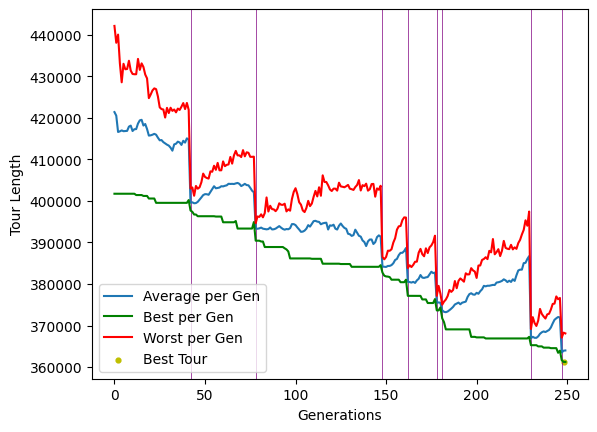

Best Tour Found in generation 248 with length of 361244.7211134271
Completed sub-tour for cluster number 291 --------------------------------------------
Running genetic algorithm on cluster 292 with 309 cities
Reintroduced 75 messiah(s) in generation 20
Reintroduced 75 messiah(s) in generation 47
Reintroduced 75 messiah(s) in generation 62
Reintroduced 75 messiah(s) in generation 77
Reintroduced 75 messiah(s) in generation 85
Reintroduced 75 messiah(s) in generation 148
Reintroduced 75 messiah(s) in generation 172
Reintroduced 75 messiah(s) in generation 216
20.211236238479614 seconds


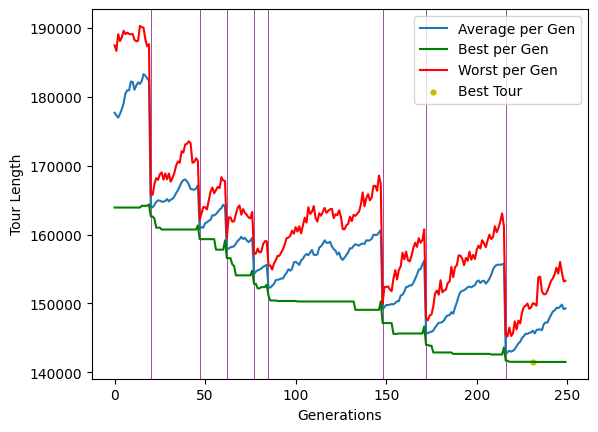

Best Tour Found in generation 231 with length of 141511.94435529082
Completed sub-tour for cluster number 292 --------------------------------------------
Running genetic algorithm on cluster 293 with 638 cities
Reintroduced 75 messiah(s) in generation 5
Reintroduced 75 messiah(s) in generation 14
Reintroduced 75 messiah(s) in generation 18
Reintroduced 75 messiah(s) in generation 78
Reintroduced 75 messiah(s) in generation 108
Reintroduced 75 messiah(s) in generation 125
Reintroduced 75 messiah(s) in generation 147
Reintroduced 75 messiah(s) in generation 161
Reintroduced 75 messiah(s) in generation 183
Reintroduced 75 messiah(s) in generation 216
Reintroduced 75 messiah(s) in generation 248
43.74957895278931 seconds


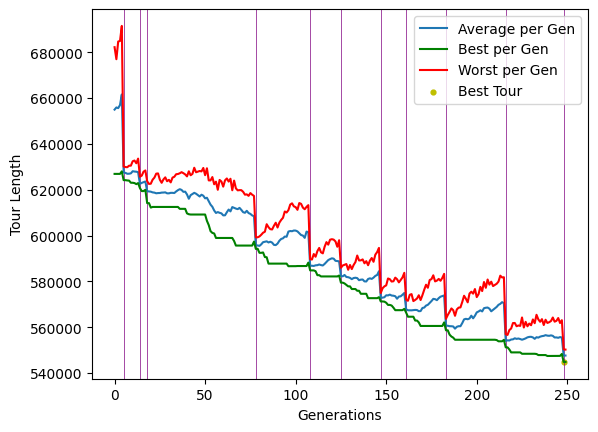

Best Tour Found in generation 248 with length of 544883.5484842244
Completed sub-tour for cluster number 293 --------------------------------------------
Running genetic algorithm on cluster 294 with 322 cities
Reintroduced 75 messiah(s) in generation 29
Reintroduced 75 messiah(s) in generation 95
Reintroduced 75 messiah(s) in generation 114
Reintroduced 75 messiah(s) in generation 200
Reintroduced 75 messiah(s) in generation 225
20.955973148345947 seconds


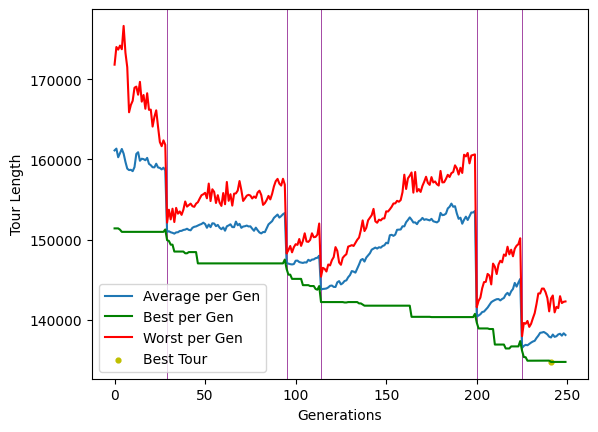

Best Tour Found in generation 241 with length of 134704.1685022208
Completed sub-tour for cluster number 294 --------------------------------------------
Running genetic algorithm on cluster 295 with 301 cities
Reintroduced 75 messiah(s) in generation 52
Reintroduced 75 messiah(s) in generation 120
Reintroduced 75 messiah(s) in generation 174
Reintroduced 75 messiah(s) in generation 199
Reintroduced 75 messiah(s) in generation 209
19.778594732284546 seconds


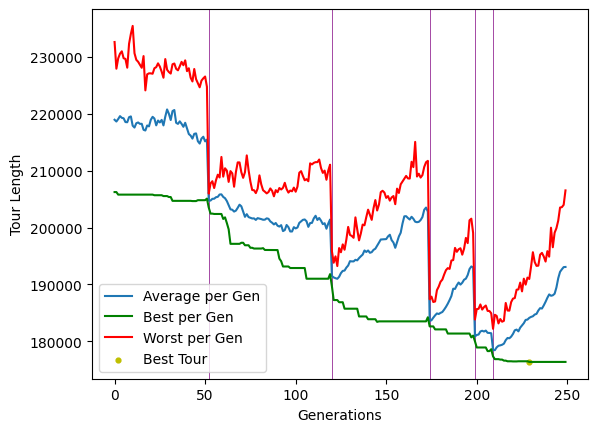

Best Tour Found in generation 229 with length of 176375.66693841654
Completed sub-tour for cluster number 295 --------------------------------------------
Running genetic algorithm on cluster 296 with 357 cities
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 57
Reintroduced 75 messiah(s) in generation 107
Reintroduced 75 messiah(s) in generation 131
Reintroduced 75 messiah(s) in generation 195
23.36668109893799 seconds


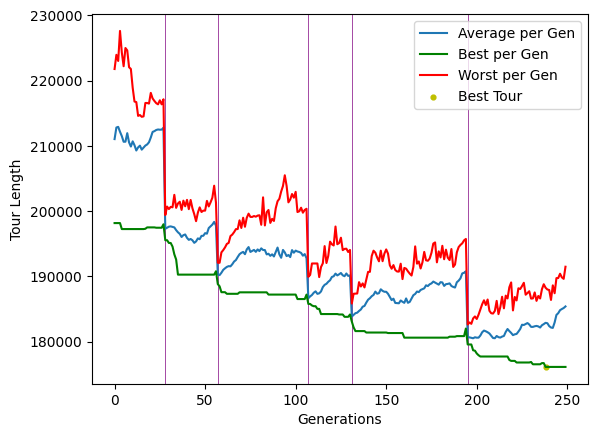

Best Tour Found in generation 238 with length of 176146.51059305095
Completed sub-tour for cluster number 296 --------------------------------------------
Running genetic algorithm on cluster 297 with 503 cities
Reintroduced 75 messiah(s) in generation 28
Reintroduced 75 messiah(s) in generation 48
Reintroduced 75 messiah(s) in generation 81
Reintroduced 75 messiah(s) in generation 169
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 198
Reintroduced 75 messiah(s) in generation 232
34.15330791473389 seconds


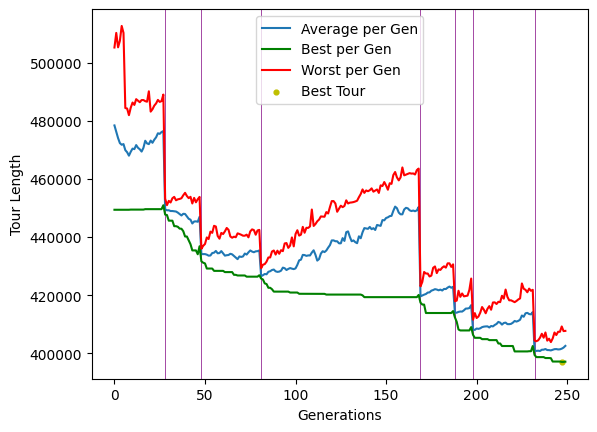

Best Tour Found in generation 247 with length of 397091.3831696147
Completed sub-tour for cluster number 297 --------------------------------------------
Running genetic algorithm on cluster 298 with 244 cities
Reintroduced 75 messiah(s) in generation 41
Reintroduced 75 messiah(s) in generation 86
Reintroduced 75 messiah(s) in generation 141
Reintroduced 75 messiah(s) in generation 188
Reintroduced 75 messiah(s) in generation 206
Reintroduced 75 messiah(s) in generation 238
15.954486846923828 seconds


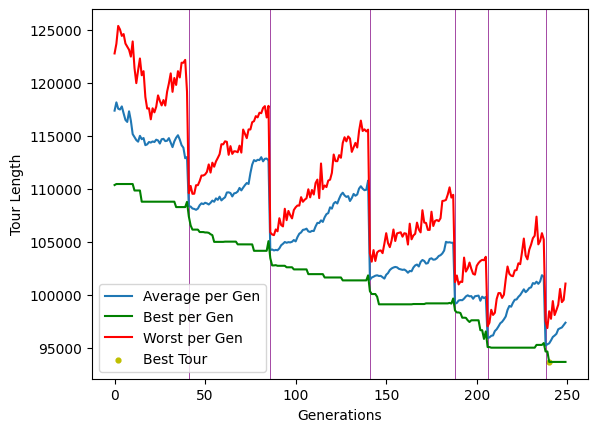

Best Tour Found in generation 240 with length of 93642.93065820303
Completed sub-tour for cluster number 298 --------------------------------------------
Running genetic algorithm on cluster 299 with 256 cities
Reintroduced 75 messiah(s) in generation 21
Reintroduced 75 messiah(s) in generation 137
Reintroduced 75 messiah(s) in generation 149
Reintroduced 75 messiah(s) in generation 215
16.75360679626465 seconds


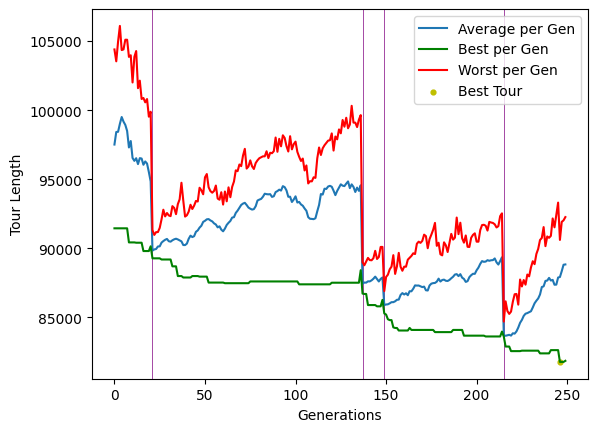

Best Tour Found in generation 246 with length of 81783.14174243051
Completed sub-tour for cluster number 299 --------------------------------------------
7671.728472948074 seconds


In [441]:
#parameters for running on all clusters
gens = 250
darwin = .30 
mutate_chance_child = .25 
mutate_chance_elite = .08 
population_size = 100 
elite_clone_percent = .10/darwin
messiah_margin = 300 
messiah_percent = .75
messiah_num = int(messiah_percent * population_size)

tours = []
t_i = 0
start_time = time.time()
for reg in regions:
    n_r_i = len(reg)
    prevpop = generate_random_population(population_size, n_r_i) #generates a random population
    print("Running genetic algorithm on cluster " + str(t_i) + " with " + str(n_r_i) + " cities")
    t = genetic_algorithm(reg, prevpop, gens, darwin, mutate_chance_child, mutate_chance_elite, population_size, elite_clone_percent, messiah_margin, messiah_num, True)
    tours.append(t)
    print("Completed sub-tour for cluster number " + str(t_i) + " --------------------------------------------")
    t_i+=1
print(time.time()-start, "seconds")

In [443]:
#concatenate tours together into final solution
final_tour = []
cluster_number = 0
for tour in tours:
    for city in tour:
        final_tour.append(np.where(CITIES==regions[cluster_number][city])[0][0])
    cluster_number+=1
    print("Concatenated " + str(cluster_number) + " clusters")
print(len(final_tour))

Concatenated 1 clusters
Concatenated 2 clusters
Concatenated 3 clusters
Concatenated 4 clusters
Concatenated 5 clusters
Concatenated 6 clusters
Concatenated 7 clusters
Concatenated 8 clusters
Concatenated 9 clusters
Concatenated 10 clusters
Concatenated 11 clusters
Concatenated 12 clusters
Concatenated 13 clusters
Concatenated 14 clusters
Concatenated 15 clusters
Concatenated 16 clusters
Concatenated 17 clusters
Concatenated 18 clusters
Concatenated 19 clusters
Concatenated 20 clusters
Concatenated 21 clusters
Concatenated 22 clusters
Concatenated 23 clusters
Concatenated 24 clusters
Concatenated 25 clusters
Concatenated 26 clusters
Concatenated 27 clusters
Concatenated 28 clusters
Concatenated 29 clusters
Concatenated 30 clusters
Concatenated 31 clusters
Concatenated 32 clusters
Concatenated 33 clusters
Concatenated 34 clusters
Concatenated 35 clusters
Concatenated 36 clusters
Concatenated 37 clusters
Concatenated 38 clusters
Concatenated 39 clusters
Concatenated 40 clusters
Concatena

In [444]:
print(tour_length(CITIES, final_tour))
print(final_tour)

82017282.85044158
[91938, 93847, 93657, 92808, 93318, 91060, 94331, 93155, 91286, 93907, 92109, 92962, 94938, 93301, 93161, 94825, 93222, 93461, 91030, 93381, 92695, 92711, 94352, 94221, 95095, 94125, 91558, 93467, 93656, 94035, 95077, 93812, 91863, 92236, 92060, 93662, 94570, 91856, 92370, 93410, 91970, 91516, 94219, 93399, 94929, 93302, 92753, 92543, 92680, 93272, 93164, 92805, 93273, 93156, 92794, 93300, 93958, 92569, 91666, 92647, 92146, 91849, 92665, 92185, 92264, 94138, 91215, 91382, 93157, 93152, 94204, 91016, 95072, 92787, 91319, 94256, 91437, 93172, 95045, 93162, 93294, 93296, 91092, 92644, 92696, 90918, 91944, 92801, 93720, 95122, 92640, 94005, 94128, 93160, 91233, 92791, 91579, 92189, 91070, 91207, 93159, 94574, 91930, 93311, 93167, 93322, 91014, 92613, 92507, 93153, 91013, 92100, 93291, 90921, 93224, 94428, 92803, 93418, 91977, 93307, 91421, 91821, 92810, 91583, 91562, 95046, 91566, 93171, 95118, 3949, 94369, 93299, 91543, 92145, 91106, 92364, 93403, 91235, 92300, 93304, 93

## Ant Colony Optimization

In [354]:
import random
from multiprocessing import Process

import defs #in order for multiprocessing to work using native libraries on jupyter notebook, need to import the parallelized function from a seperate file

#given a start city, alpha and beta, and the existing pheromones, returns a tour chosen by an ant with the given alpha beta
def traverse_graph(cities, pheromone_alpha, distance_beta, pheromone_map):
    visited = [] #acts both as cities visited and tour for ant
    visited.append(0) #the ant starts at the starting city (the first city)
    current = 0
    while len(visited) < len(cities): #while the tour hasn't reached every city
        neighbors = [] #feasible neighbors (neighbors we haven't already visited)
        neighbor_weights = [] #probability weight that ant chooses corresponding neighbor
        for i in range(0, len(cities)): #visit all possible cities
            if i not in visited: #if the city hasn't been visited
                pheromone = max(pheromone_map[current, i], 1e-5) #retrieve the pheromone along that edge, retrieving a minimal amount to encourage exploration
                weight = (pheromone**pheromone_alpha)/(dist(cities[current], cities[i])**distance_beta) #and use it and the distance to calculate the weight that the ant picks this city
                #add feasible neighbor and it's calculated weight to the list of possible next cities
                neighbors.append(i)
                neighbor_weights.append(weight)
        #randomly choose the next city
        next = random.choices(neighbors, weights = neighbor_weights)[0] #uses the normalized weights
        #update tour
        visited.append(next)
        current=next
    assert len(cities) == len(visited)
    return visited

def parallel_traverse(cities, pheromone_alpha, distance_beta, pheromone_map, ants, j):
    ant = traverse_graph(cities, pheromone_alpha, distance_beta, pheromone_map)
    ants[j] = ant

#alpha and beta are hyperparameters for controlling the importantance of pheromone level and distance in calculating edge weight
#p_inverse is a hyperparameter for controlling the amount of pheromone placed into the pheromone map by a given ant
def ant_colony_optimization(cities, N, ant_num, pheromone_alpha, distance_beta, p_inverse):
    start = time.time()
    #Metrics
    super_duper_best_ant = []
    super_duper_best_ant_dist = sys.maxsize
    super_duper_best_ant_generation = 0
    best_per_gen = []
    worst_per_gen = []
    avg_per_gen = []

    #initializing empty pheromone map
    pheromone_map = np.zeros((len(cities), len(cities)))
    for i in range(0, N):
        ants = [] #every gen starts with fresh ants
        #per generation metrics
        best = sys.maxsize
        worst = 0
        avg = 0

        #parallel implementation of ant traversal
        
        ant_processes = []
        if __name__ == '__main__':
            for j in range(0, ant_num):
                p = Process(target=defs.parallel_traverse, args=(cities, pheromone_alpha, distance_beta, pheromone_map, ants,)) 
                ant_processes.append(p)
                p.start() #starts the process in parallel for the current ant. This ant's found tour will be appended to ants when completed
            for t in ant_processes: #don't continue until all ants have finished traversing
                t.join()
        
        #sequential implementation of ant traversal
        
        # for j in range(0, ant_num):
        #     ant = traverse_graph(cities, pheromone_alpha, distance_beta, pheromone_map)
        #     ants.append(ant)

        #clear pheromone map (subject to degredation TODO)
        pheromone_map = np.zeros((len(cities), len(cities)))
        #have each ant lay their pheromone
        for ant in ants:
            dist = tour_length(cities, ant)
            pheromone = p_inverse/dist #calculates pheromone to add inversely prop to the distance, increasing with respect to p_inverse
            for j in range(0, len(ant)-1):
                pheromone_map[ant[j], ant[j+1]] += pheromone #adds the pheromones
            #Metric Keeping
            if dist < best:
                best = dist
                if best < super_duper_best_ant_dist:
                    super_duper_best_ant_dist = best
                    super_duper_best_ant = ant
                    super_duper_best_ant_generation = i
            if dist > worst:
                worst = dist
            avg += dist
        best_per_gen.append(best)
        worst_per_gen.append(worst)
        avg_per_gen.append(avg/ant_num)
    print(time.time()-start,"seconds")
    plt.plot(np.array(range(len(avg_per_gen))),avg_per_gen, label="Average per Gen")
    plt.plot(np.array(range(len(best_per_gen))),best_per_gen, c='g', label="Best per Gen")
    plt.plot(np.array(range(len(worst_per_gen))),worst_per_gen, c='r', label="Worst per Gen")
    plt.scatter(super_duper_best_ant_generation, super_duper_best_ant_dist, c='y', s=12, marker='o', label="Best Tour")
    plt.xlabel("Generations")
    plt.ylabel("Tour Length")
    plt.legend()
    plt.show()
    
    print("Best Tour Found in generation " + str(super_duper_best_ant_generation) + " with length of " + str(super_duper_best_ant_dist))
    return super_duper_best_ant

Performing Ant Colony Optimization
29.50338101387024 seconds


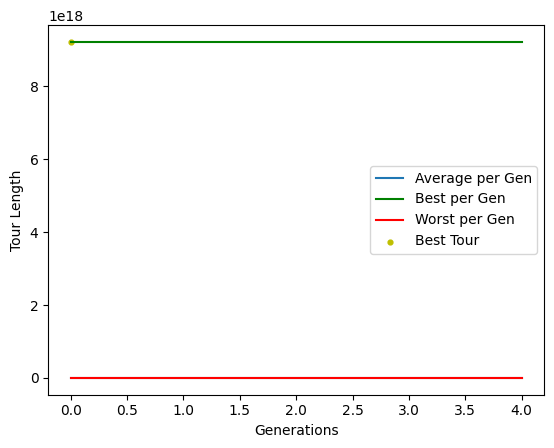

Best Tour Found in generation 0 with length of 9223372036854775807
[]


In [355]:
gens = 5 #number of generation of ants
ant_num = 10 #size of each generation of ants
pheromone_alpha = 1
distance_beta = 4
p_inverse = 10

print("Performing Ant Colony Optimization")
t1 = ant_colony_optimization(region, gens, ant_num, pheromone_alpha, distance_beta, p_inverse)
print(t1)